アンサンブルをしてもスコアが上がらない。もう一度初心に立ち帰り、特徴量エンジニアリングを行う。

特徴量をチェックするシート

In [913]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import scipy as sp
import lightgbm as lgb
import category_encoders as ce
import mojimoji
import re
from cmath import nan
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import accuracy_score
import optuna
from sklearn.metrics import mean_squared_error
import japanize_matplotlib

訓練データの読み込み

In [914]:
house_age = pd.read_csv('house_age.csv')
area_size = pd.read_csv('area_size.csv')
room_arrange = pd.read_csv('room_arrange.csv')
contract_span = pd.read_csv('contract_span.csv')
floor_scores = pd.read_csv('floor_scores.csv')
Floor_scores = pd.read_csv('capital_floor_scores.csv')
stations = pd.read_csv('stations.csv')
minits = pd.read_csv('minits.csv')
addresses = pd.read_csv('addresses.csv')
room_arrange = pd.read_csv('room_arrange.csv')

rent = pd.read_csv('rent.csv')

テストデータの読み込み

In [915]:
test_house_age = pd.read_csv('test_house_age.csv')
test_area_size = pd.read_csv('test_area_size.csv')
test_room_arrange = pd.read_csv('test_room_arrange.csv')
test_contract_span = pd.read_csv('test_contract_span.csv')
test_floor_scores = pd.read_csv('test_floor_scores.csv')
test_Floor_scores = pd.read_csv('test_capital_floor_scores.csv')
test_stations = pd.read_csv('test_stations.csv')
test_minits = pd.read_csv('test_minits.csv')
test_addresses = pd.read_csv('test_addresses.csv')
test_room_arrange = pd.read_csv('test_room_arrange.csv')

築年数(house_ageについて)

/var/folders/qh/20ftf7rn5_58_rk3l25kt1nr0000gn/T/ipykernel_6423/2180439461.py:14: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


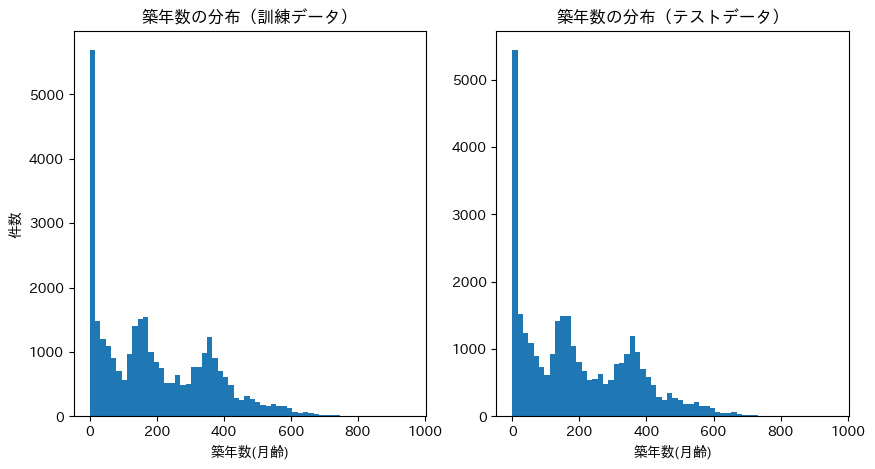

In [916]:
fig = plt.figure(figsize=(10,5))
ax1 = fig.add_subplot(1,2,1)
ax2 = fig.add_subplot(1,2,2)

ax1.hist(house_age,bins=60)
ax1.set_title('築年数の分布（訓練データ）')
ax1.set_xlabel('築年数(月齢)')
ax1.set_ylabel('件数')

ax2.hist(test_house_age,bins=60)
ax2.set_title('築年数の分布（テストデータ）')
ax2.set_xlabel('築年数(月齢)')

fig.show()

- ここから得られる知見として、築年数ごとの件数でピークがいくつかあるということ。
- 新築の物件が極めて多いこと。

築年数の大きいものが少し怪しい気がするので確かめる。

In [917]:
house_age[house_age['築年数']>800]

,築年数
11994,835.0
13755,819.0
15352,955.0
16506,823.0
17090,819.0
21985,830.0
24000,847.0


元データを確認したところ、築800か月(約70年)超えの物件は少ないながら存在しているのでそのままにする。

面積について

/var/folders/qh/20ftf7rn5_58_rk3l25kt1nr0000gn/T/ipykernel_6423/1120412897.py:14: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


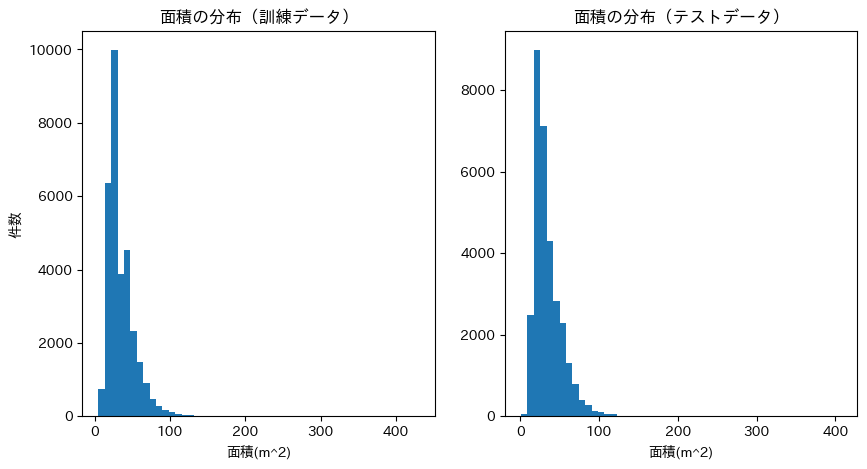

In [918]:
fig = plt.figure(figsize=(10,5))
ax1 = fig.add_subplot(1,2,1)
ax2 = fig.add_subplot(1,2,2)

ax1.hist(area_size,bins=50)
ax1.set_title('面積の分布（訓練データ）')
ax1.set_xlabel('面積(m^2)')
ax1.set_ylabel('件数')

ax2.hist(test_area_size,bins=50)
ax2.set_title('面積の分布（テストデータ）')
ax2.set_xlabel('面積(m^2)')

fig.show()

面積が大きすぎるものもあるので確認する。

In [919]:
area_size[area_size['面積'] > 200]

,面積
671,231.52
1295,214.78
1771,232.01
2075,256.68
5093,217.29
9008,223.71
10334,214.77
11958,221.30
16613,270.07
16847,221.30


欠損値の処理を見直してみる。

まず自分で欠損値の処理をテキトーにしていた意識があるのは、契約期間である。

In [920]:
contract_span.isna().sum()

契約期間    104
dtype: int64

現在の契約期間データの問題点として、
- 以前は、元ファイルで欠損値になっていたものに0を代入していた。しかしこれでは、モデルに間違った解釈をさせかねない。
- 異常値対策として、契約期間が10年以上のものに対してはnanを代入していた。しかし、例えば1000年のような明らかな異常値はあるものの、15年などのような値も元ファイルに存在している。
- 定期借家情報が抜け落ちている。

これらを修正する。

In [921]:
df_train = pd.read_csv('train.csv')
df_test = pd.read_csv('test.csv')
df = pd.concat([df_train, df_test],axis=0)
merge_contract_span = df["契約期間"]
merge_contract_span.head()

0                       2年間
1                       2年間
2                       2年間
3    2年間\t※この物件は\t定期借家\tです。
4                       2年間
Name: 契約期間, dtype: object

In [922]:
merge_contract_span.isna().sum()

14101

必ずしも以前の契約期間データが間違っているとは言い切れないので、再利用も考慮に入れて、contract_span2のようにナンバリングする。

In [923]:
i = 0
target = '年'
target2 = 'ヶ'
merge_reg_rent = []
merge_contract_span2 = []
for contract_span in merge_contract_span:
    ##定期借家かどうかチェックする。    
    try:
        if '定期借家' in contract_span:
            merge_reg_rent.append(1)
        else:
            merge_reg_rent.append(0)
    except:
        merge_reg_rent.append(nan)

    ##以下は契約期間に関する記述。
    #sが欠損値であることに備える。
    try:
        idx = contract_span.find(target)
    except:
        #sが欠損値であればidxの取得が失敗するので、今までは0を代入していた。
        #今回はnanで代入する。
        merge_contract_span2.append(nan)
        i += 1
        continue
    
    try:
        #年単位で契約期間が定まっているのかをまず調べる
        if float( contract_span[:idx] ) > 50.0:
            merge_contract_span2.append(nan)
        else:
            merge_contract_span2.append( float( contract_span[:idx] ) )
    except:
        #月単位で契約期間が定まっているのなら、12で割って契約年数とする。
        idx2 = contract_span.find(target2)
        if float( contract_span[:idx2] )/12 > 50.0:
            merge_contract_span2.append(nan)
        else:
            merge_contract_span2.append(float( contract_span[:idx2] )/12)

    i += 1

In [924]:
merge_reg_rent = pd.DataFrame(merge_reg_rent)

In [925]:
contract_span2 = merge_contract_span2[:len(df_train['契約期間'])]
test_contract_span2 = merge_contract_span2[len(df_train['契約期間']):]
reg_rent = merge_reg_rent[:len(df_train['契約期間'])]
test_reg_rent = merge_reg_rent[len(df_train['契約期間']):]

In [926]:
contract_span2 = pd.DataFrame(contract_span2)
contract_span2.to_csv('contract_span2.csv',index=False)
test_contract_span2 = pd.DataFrame(test_contract_span2)
test_contract_span2.to_csv('test_contract_span2.csv',index=False)

#定期借家はカテゴリ変数
reg_rent = pd.DataFrame(reg_rent)
reg_rent.columns = ['定期借家']
list_cols = ['定期借家']
reg_rent_encoder = ce.OrdinalEncoder(cols=list_cols, drop_invariant=True)
reg_rent = reg_rent_encoder.fit_transform(reg_rent['定期借家'])
reg_rent.to_csv('reg_rent.csv',index=False)

test_reg_rent = pd.DataFrame(test_reg_rent)
test_reg_rent.columns = ['定期借家']
test_reg_rent = pd.DataFrame(test_reg_rent)
test_reg_rent_encoder = ce.OrdinalEncoder(cols=list_cols, drop_invariant=True)
test_reg_rent = test_reg_rent_encoder.fit_transform(test_reg_rent['定期借家'])
test_reg_rent.to_csv('test_reg_rent.csv',index=False)

次に、「所在地」のカテゴリを振り直す。

In [927]:
#所在地のテキスト整形用関数
def func_place(block):
    target2 = '丁'
    target3 = '町'
    target4 = '-'
    target5 = '－'
    try:
        if target2 in block:
            place = block.split(target2)[0]
            if place == '新宿区余':
                place = '新宿区余丁町'
            else:
                place = place[:-1]
        elif target3 in block:
            place = block.split(target3)[0]
            place = place + target3
        elif target4 in block:
            place = block.split(target4)[0]
            place = place[:-1]
        elif target5 in block:
            place = block.split(target5)[0]
            place = place[:-1]
        if place[-1].isnumeric():
            place = place[:-1]
        return place
    except:
            return block

df_train = pd.read_csv('train.csv')
df_test = pd.read_csv('test.csv')
df = pd.concat([df_train, df_test],axis=0)

locations = df['所在地']

#以下の部分では訓練データの”区”のラベル化に備えて、〇〇区の部分を抽出する。
i = 0
merge_addresses = []
for loc in locations:
    target1 = "都"
    idx1 = loc.find(target1)
    block = loc[idx1+1:]
    address = func_place(block)
    merge_addresses.append(address)

merge_addresses = pd.DataFrame(merge_addresses)
merge_addresses = merge_addresses.rename(columns={0:'所在地'})#列名の振り直し
print("カテゴリ化前の訓練データ：")
print("カテゴリ化前の訓練データの大きさ：",len(merge_addresses))
merge_addresses.to_csv('merge_address.csv')

#カテゴリ化
list_cols = ['所在地']
addresses_encoder = ce.OrdinalEncoder(cols=list_cols, drop_invariant=True)
merge_addresses_c = addresses_encoder.fit_transform(merge_addresses['所在地'])
#訓練データとテストデータに再分割
addresses = merge_addresses_c[:len(df_train)]
addresses.to_csv('addresses.csv',index=False)
test_addresses = merge_addresses_c[len(df_train):]
test_addresses.to_csv('test_addresses.csv',index=False)

カテゴリ化前の訓練データ：
カテゴリ化前の訓練データの大きさ： 62732


In [928]:
merge_addresses['所在地']

0          北区滝野川
1          中央区月島
2          渋谷区笹塚
3        杉並区高円寺南
4          葛飾区金町
          ...   
62727     豊島区上池袋
62728    千代田区岩本町
62729     中野区江古田
62730    千代田区二番町
62731     大田区南馬込
Name: 所在地, Length: 62732, dtype: object

In [929]:
#所在地が何回登場しているか数える。少ない回数しか登場していないものは整形ミスの可能性があり怪しい。
addresses_sr = pd.Series(merge_addresses['所在地'])
vc = addresses_sr.value_counts()
vc = pd.DataFrame(vc)
vc.columns = ['登場回数']
#登場回数が3回以下のものはファイル出力して記録する。
errors_list = vc[vc['登場回数'] <= 3]
errors_list.to_csv('errors_list.csv')

これまでに整形したデータでlightBGMを動かしてみる。

In [931]:
# X_train = pd.concat([house_age, area_size, contract_span2, reg_rent, floor_scores, Floor_scores, stations, minits, addresses, room_arrange], axis=1)
# y_train = rent

# X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, test_size=0.3, random_state=0)

# X_test = pd.concat([test_house_age, test_area_size, test_contract_span2, test_reg_rent, test_floor_scores, test_Floor_scores, test_stations, test_minits, test_addresses, test_room_arrange], axis=1)

# category_lists = ['定期借家','最寄り駅', '所在地', 'L', 'D', 'K']
# lgb_train = lgb.Dataset(X_train, y_train)
# lgb_eval = lgb.Dataset(X_valid, y_valid, reference=lgb_train)

# params = {
#     'objective':'regression',
#     'metrics':'rmse',
#     'reg_lambda': 3.681194978110037e-06,
#     'max_bin': 522,
#     'num_leaves': 124
# }

# model = lgb.train(
#                     params,
#                     lgb_train, 
#                     valid_sets=[lgb_train, lgb_eval], 
#                     verbose_eval=10, 
#                     num_boost_round=3000, 
#                     early_stopping_rounds=10,
#                     categorical_feature = category_lists
#                     )

# y_pred = model.predict(X_test, num_iteration=model.best_iteration)

スコアの向上が望めそうである。

さらにチューニングをする。

In [932]:
X_train = pd.concat([house_age, area_size, contract_span2, reg_rent, floor_scores, Floor_scores, stations, minits, addresses, room_arrange], axis=1)
y_train = rent

X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, test_size=0.3, random_state=0)

X_test = pd.concat([test_house_age, test_area_size, test_contract_span2, test_reg_rent, test_floor_scores, test_Floor_scores, test_stations, test_minits, test_addresses, test_room_arrange], axis=1)

def objective(trial):
    category_lists = ['定期借家', '最寄り駅', '所在地', 'L', 'D', 'K', 'S']
    lgb_train = lgb.Dataset(X_train, y_train)
    lgb_eval = lgb.Dataset(X_valid, y_valid, reference=lgb_train)

    params = {
        'objective':'regression',
        'metrics':'rmse',
        'learning_rate':0.05,
        'reg_lambda': trial.suggest_float('reg_lambda', 0.0000001, 0.0001, log=True),
        'max_bin': trial.suggest_int('max_bin', 255, 600),
        'num_leaves': trial.suggest_int('num_leaves', 32, 128),
    }

    model = lgb.train(
                        params,
                        lgb_train, 
                        valid_sets=[lgb_train, lgb_eval], 
                        #verbose_eval=10, 
                        num_boost_round=3000, 
                        early_stopping_rounds=10,
                        categorical_feature = category_lists
                        )

    y_pred_valid = model.predict(X_valid, num_iteration=model.best_iteration)

    loss = mean_squared_error(y_valid, y_pred_valid, squared=False)
    return loss

ValueError: Found input variables with inconsistent numbers of samples: [62732, 31470]

In [ ]:
# optuna.logging.disable_default_handler()
# study = optuna.create_study(sampler=optuna.samplers.RandomSampler(seed=0))
# study.optimize(objective, n_trials=300)
# study.best_params

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001264 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2342
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70614.1	valid_1's rmse: 71341.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67778.4	valid_1's rmse: 68786.8
[3]	training's rmse: 65088	valid_1's rmse: 66362.2
[4]	training's rmse: 62558.6	valid_1's rmse: 64110.7
[5]	training's rmse: 60145	valid_1's rmse: 62005.8
[6]	training's rmse: 57888	valid_1's rmse: 59987.4
[7]	training's rmse: 55751.7	valid_1's rmse: 58141.7
[8]	training's rmse: 53730.2	valid_1's rmse: 56349.8
[9]	training's rmse: 51828.3	valid_1's rmse: 54712.1
[10]	training's rmse: 50039.4	valid_1's rmse: 53158.7


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001057 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2112
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70608.4	valid_1's rmse: 71340.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67720.9	valid_1's rmse: 68704.5
[3]	training's rmse: 64998.3	valid_1's rmse: 66255.3
[4]	training's rmse: 62458.4	valid_1's rmse: 63986.5
[5]	training's rmse: 60084.6	valid_1's rmse: 61870.8
[6]	training's rmse: 57771.2	valid_1's rmse: 59819.9
[7]	training's rmse: 55646.6	valid_1's rmse: 57972.2
[8]	training's rmse: 53638.9	valid_1's rmse: 56212
[9]	training's rmse: 51682.7	valid_1's rmse: 54514.5
[10]	training's rmse: 49888.2	valid_1's rmse: 5295

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000691 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2464
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70539.2	valid_1's rmse: 71247.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67640.6	valid_1's rmse: 68623.9
[3]	training's rmse: 64896.5	valid_1's rmse: 66140.4
[4]	training's rmse: 62309.2	valid_1's rmse: 63826
[5]	training's rmse: 59863.9	valid_1's rmse: 61638.8
[6]	training's rmse: 57538.9	valid_1's rmse: 59610.8
[7]	training's rmse: 55356.2	valid_1's rmse: 57721.2
[8]	training's rmse: 53298.9	valid_1's rmse: 55936.2
[9]	training's rmse: 51316.3	valid_1's rmse: 54215.4
[10]	training's rmse: 49481.8	valid_1's rmse: 5266

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000814 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2394
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70585.1	valid_1's rmse: 71325.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67733.2	valid_1's rmse: 68735.8
[3]	training's rmse: 65025.2	valid_1's rmse: 66306.2
[4]	training's rmse: 62442.5	valid_1's rmse: 63959.8
[5]	training's rmse: 60031.6	valid_1's rmse: 61837.8
[6]	training's rmse: 57756.8	valid_1's rmse: 59843.8
[7]	training's rmse: 55571.3	valid_1's rmse: 57873.1
[8]	training's rmse: 53542	valid_1's rmse: 56094.9
[9]	training's rmse: 51614.7	valid_1's rmse: 54395.8
[10]	training's rmse: 49793.3	valid_1's rmse: 5285

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001012 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2488
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70682.8	valid_1's rmse: 71376
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67916	valid_1's rmse: 68865.6
[3]	training's rmse: 65302.3	valid_1's rmse: 66493.5
[4]	training's rmse: 62824.5	valid_1's rmse: 64270.5
[5]	training's rmse: 60511.6	valid_1's rmse: 62199.2
[6]	training's rmse: 58335	valid_1's rmse: 60289.1
[7]	training's rmse: 56251.7	valid_1's rmse: 58479.3
[8]	training's rmse: 54282.6	valid_1's rmse: 56793.2
[9]	training's rmse: 52400.4	valid_1's rmse: 55158
[10]	training's rmse: 50606.8	valid_1's rmse: 53623.4
[1

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000596 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1827
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70546.8	valid_1's rmse: 71241.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67636.7	valid_1's rmse: 68590.5
[3]	training's rmse: 64900	valid_1's rmse: 66110.5
[4]	training's rmse: 62308.5	valid_1's rmse: 63748.6
[5]	training's rmse: 59873.2	valid_1's rmse: 61547.8
[6]	training's rmse: 57566.9	valid_1's rmse: 59493.3
[7]	training's rmse: 55403.1	valid_1's rmse: 57594.2
[8]	training's rmse: 53363.6	valid_1's rmse: 55802.1
[9]	training's rmse: 51424.8	valid_1's rmse: 54134.4
[10]	training's rmse: 49600.5	valid_1's rmse: 5258

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000699 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2450
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70529.4	valid_1's rmse: 71235.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67631.5	valid_1's rmse: 68669.3
[3]	training's rmse: 64885.1	valid_1's rmse: 66178.6
[4]	training's rmse: 62296.5	valid_1's rmse: 63882.3
[5]	training's rmse: 59835.8	valid_1's rmse: 61709.1
[6]	training's rmse: 57500.8	valid_1's rmse: 59636.4
[7]	training's rmse: 55343.1	valid_1's rmse: 57769.5
[8]	training's rmse: 53269.8	valid_1's rmse: 55979.9
[9]	training's rmse: 51296.1	valid_1's rmse: 54300.5
[10]	training's rmse: 49464.9	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001099 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2151
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70551.8	valid_1's rmse: 71259.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67691.3	valid_1's rmse: 68693.2
[3]	training's rmse: 64956.3	valid_1's rmse: 66214.4
[4]	training's rmse: 62394.2	valid_1's rmse: 63916.5
[5]	training's rmse: 59982.1	valid_1's rmse: 61768.5
[6]	training's rmse: 57658.1	valid_1's rmse: 59703.2
[7]	training's rmse: 55519.1	valid_1's rmse: 57832.8
[8]	training's rmse: 53460.7	valid_1's rmse: 56037.9
[9]	training's rmse: 51557.2	valid_1's rmse: 54378.3
[10]	training's rmse: 49765.6	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000634 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2290
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70662.1	valid_1's rmse: 71365.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67879.3	valid_1's rmse: 68815
[3]	training's rmse: 65256.2	valid_1's rmse: 66445.1
[4]	training's rmse: 62772.4	valid_1's rmse: 64214.2
[5]	training's rmse: 60422	valid_1's rmse: 62121.5
[6]	training's rmse: 58215.4	valid_1's rmse: 60162.6
[7]	training's rmse: 56128.4	valid_1's rmse: 58313.9
[8]	training's rmse: 54169.8	valid_1's rmse: 56611.4
[9]	training's rmse: 52324.8	valid_1's rmse: 54992.7
[10]	training's rmse: 50561.8	valid_1's rmse: 53476.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000754 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2208
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70635.4	valid_1's rmse: 71380.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67803.3	valid_1's rmse: 68835.2
[3]	training's rmse: 65136.5	valid_1's rmse: 66455.8
[4]	training's rmse: 62628.3	valid_1's rmse: 64209.4
[5]	training's rmse: 60256.7	valid_1's rmse: 62102
[6]	training's rmse: 58034.6	valid_1's rmse: 60129.4
[7]	training's rmse: 55851.1	valid_1's rmse: 58189.3
[8]	training's rmse: 53860.5	valid_1's rmse: 56453.9
[9]	training's rmse: 51993.1	valid_1's rmse: 54841.9
[10]	training's rmse: 50157.1	valid_1's rmse: 5324

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000981 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2382
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70594.5	valid_1's rmse: 71330.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67751.2	valid_1's rmse: 68773.3
[3]	training's rmse: 65063.9	valid_1's rmse: 66360.2
[4]	training's rmse: 62488.4	valid_1's rmse: 64030.8
[5]	training's rmse: 60074.5	valid_1's rmse: 61902.2
[6]	training's rmse: 57774	valid_1's rmse: 59811.1
[7]	training's rmse: 55640.7	valid_1's rmse: 57953.3
[8]	training's rmse: 53622	valid_1's rmse: 56210.1
[9]	training's rmse: 51701.7	valid_1's rmse: 54515.7
[10]	training's rmse: 49902.9	valid_1's rmse: 52988.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000734 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1827
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70564.5	valid_1's rmse: 71254.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67673.4	valid_1's rmse: 68624.5
[3]	training's rmse: 64954.1	valid_1's rmse: 66158.9
[4]	training's rmse: 62377.6	valid_1's rmse: 63812.1
[5]	training's rmse: 59950.9	valid_1's rmse: 61622.5
[6]	training's rmse: 57663.9	valid_1's rmse: 59570.8
[7]	training's rmse: 55509.5	valid_1's rmse: 57678.3
[8]	training's rmse: 53481.7	valid_1's rmse: 55901.3
[9]	training's rmse: 51558.7	valid_1's rmse: 54254.2
[10]	training's rmse: 49748.9	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000628 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2274
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70533.4	valid_1's rmse: 71204.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67621	valid_1's rmse: 68522
[3]	training's rmse: 64874.8	valid_1's rmse: 66006.7
[4]	training's rmse: 62295.6	valid_1's rmse: 63711.3
[5]	training's rmse: 59831.6	valid_1's rmse: 61518.4
[6]	training's rmse: 57520.7	valid_1's rmse: 59460.3
[7]	training's rmse: 55333.4	valid_1's rmse: 57535.8
[8]	training's rmse: 53279	valid_1's rmse: 55739.8
[9]	training's rmse: 51338.6	valid_1's rmse: 54071.1
[10]	training's rmse: 49483.2	valid_1's rmse: 52474.5


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000861 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2063
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70594.2	valid_1's rmse: 71297
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67723.2	valid_1's rmse: 68734
[3]	training's rmse: 65024.9	valid_1's rmse: 66272.3
[4]	training's rmse: 62454.6	valid_1's rmse: 63997.7
[5]	training's rmse: 60033.4	valid_1's rmse: 61862.4
[6]	training's rmse: 57763.8	valid_1's rmse: 59795.5
[7]	training's rmse: 55612.9	valid_1's rmse: 57917.9
[8]	training's rmse: 53601.5	valid_1's rmse: 56181.6
[9]	training's rmse: 51687	valid_1's rmse: 54481.3
[10]	training's rmse: 49878.7	valid_1's rmse: 52886.2


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000628 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1855
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70561.7	valid_1's rmse: 71291.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67681.1	valid_1's rmse: 68664.7
[3]	training's rmse: 64954.5	valid_1's rmse: 66186.9
[4]	training's rmse: 62394.2	valid_1's rmse: 63869.8
[5]	training's rmse: 59955.3	valid_1's rmse: 61658.3
[6]	training's rmse: 57651	valid_1's rmse: 59583.7
[7]	training's rmse: 55485.7	valid_1's rmse: 57654.7
[8]	training's rmse: 53438.8	valid_1's rmse: 55827.7
[9]	training's rmse: 51500.7	valid_1's rmse: 54118.5
[10]	training's rmse: 49680.5	valid_1's rmse: 5251

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000701 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1959
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70688	valid_1's rmse: 71414
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67943.3	valid_1's rmse: 68925.9
[3]	training's rmse: 65354.4	valid_1's rmse: 66606.3
[4]	training's rmse: 62873.9	valid_1's rmse: 64338.4
[5]	training's rmse: 60555.3	valid_1's rmse: 62234
[6]	training's rmse: 58382.5	valid_1's rmse: 60280
[7]	training's rmse: 56299.7	valid_1's rmse: 58409.5
[8]	training's rmse: 54340.5	valid_1's rmse: 56649.8
[9]	training's rmse: 52525.9	valid_1's rmse: 55045.5
[10]	training's rmse: 50759.8	valid_1's rmse: 53465.4
[1

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000723 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2065
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70576.5	valid_1's rmse: 71279.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67711.4	valid_1's rmse: 68674.9
[3]	training's rmse: 64985.9	valid_1's rmse: 66253.4
[4]	training's rmse: 62398.4	valid_1's rmse: 63976.9
[5]	training's rmse: 59969.8	valid_1's rmse: 61801.8
[6]	training's rmse: 57682.3	valid_1's rmse: 59820.4
[7]	training's rmse: 55517.1	valid_1's rmse: 57934.4
[8]	training's rmse: 53480.9	valid_1's rmse: 56167
[9]	training's rmse: 51538.5	valid_1's rmse: 54433.9
[10]	training's rmse: 49721.4	valid_1's rmse: 5285

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001124 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2528
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70664.2	valid_1's rmse: 71366.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67885.2	valid_1's rmse: 68808
[3]	training's rmse: 65270.2	valid_1's rmse: 66444
[4]	training's rmse: 62784.8	valid_1's rmse: 64195.1
[5]	training's rmse: 60446	valid_1's rmse: 62121.9
[6]	training's rmse: 58246.2	valid_1's rmse: 60184.5
[7]	training's rmse: 56162.1	valid_1's rmse: 58343.4
[8]	training's rmse: 54185.4	valid_1's rmse: 56629.3
[9]	training's rmse: 52347.8	valid_1's rmse: 55017.2
[10]	training's rmse: 50589.1	valid_1's rmse: 53489.7


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001283 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1925
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70606.1	valid_1's rmse: 71321.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67765.8	valid_1's rmse: 68759.1
[3]	training's rmse: 65094.4	valid_1's rmse: 66340.6
[4]	training's rmse: 62537.8	valid_1's rmse: 64047.3
[5]	training's rmse: 60128.8	valid_1's rmse: 61894.9
[6]	training's rmse: 57851.4	valid_1's rmse: 59825.5
[7]	training's rmse: 55702.4	valid_1's rmse: 57926.6
[8]	training's rmse: 53680.7	valid_1's rmse: 56109.2
[9]	training's rmse: 51775.1	valid_1's rmse: 54415.6
[10]	training's rmse: 49943	valid_1's rmse: 5280

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000796 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2157
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70626.2	valid_1's rmse: 71335.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67836	valid_1's rmse: 68805.5
[3]	training's rmse: 65196.4	valid_1's rmse: 66434.2
[4]	training's rmse: 62667.5	valid_1's rmse: 64167.5
[5]	training's rmse: 60321.8	valid_1's rmse: 62084.4
[6]	training's rmse: 58059.1	valid_1's rmse: 60069.2
[7]	training's rmse: 55971.1	valid_1's rmse: 58226.1
[8]	training's rmse: 53963	valid_1's rmse: 56460.3
[9]	training's rmse: 52101.3	valid_1's rmse: 54846.8
[10]	training's rmse: 50338.6	valid_1's rmse: 53310.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1891
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70608.7	valid_1's rmse: 71326.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67776.4	valid_1's rmse: 68773.5
[3]	training's rmse: 65081.6	valid_1's rmse: 66330.3
[4]	training's rmse: 62555.6	valid_1's rmse: 64090.9
[5]	training's rmse: 60161.4	valid_1's rmse: 61939.8
[6]	training's rmse: 57888.2	valid_1's rmse: 59913.4
[7]	training's rmse: 55760.9	valid_1's rmse: 58021
[8]	training's rmse: 53744.8	valid_1's rmse: 56260.8
[9]	training's rmse: 51861.7	valid_1's rmse: 54613.7
[10]	training's rmse: 50069.6	valid_1's rmse: 5304

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001005 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1951
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70646.6	valid_1's rmse: 71359.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67841.1	valid_1's rmse: 68828.6
[3]	training's rmse: 65174.8	valid_1's rmse: 66381
[4]	training's rmse: 62660	valid_1's rmse: 64106.3
[5]	training's rmse: 60285.7	valid_1's rmse: 61988.2
[6]	training's rmse: 58045.9	valid_1's rmse: 59947.2
[7]	training's rmse: 55937	valid_1's rmse: 58062.3
[8]	training's rmse: 53954.7	valid_1's rmse: 56298
[9]	training's rmse: 52034.1	valid_1's rmse: 54596.5
[10]	training's rmse: 50252.8	valid_1's rmse: 53041.7
[1

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001770 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1881
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70591.2	valid_1's rmse: 71311.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67740.4	valid_1's rmse: 68738.1
[3]	training's rmse: 65035.4	valid_1's rmse: 66282.6
[4]	training's rmse: 62490.3	valid_1's rmse: 64013.6
[5]	training's rmse: 60081	valid_1's rmse: 61849.4
[6]	training's rmse: 57800.8	valid_1's rmse: 59848.1
[7]	training's rmse: 55658.1	valid_1's rmse: 57926
[8]	training's rmse: 53618.4	valid_1's rmse: 56126.5
[9]	training's rmse: 51720.6	valid_1's rmse: 54447.5
[10]	training's rmse: 49906.3	valid_1's rmse: 52895.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000721 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2520
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70596.3	valid_1's rmse: 71333.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67737.3	valid_1's rmse: 68725.9
[3]	training's rmse: 65030.6	valid_1's rmse: 66292
[4]	training's rmse: 62500.6	valid_1's rmse: 64024.4
[5]	training's rmse: 60100.8	valid_1's rmse: 61901.4
[6]	training's rmse: 57791.4	valid_1's rmse: 59867
[7]	training's rmse: 55635.4	valid_1's rmse: 57984.9
[8]	training's rmse: 53593.2	valid_1's rmse: 56207.2
[9]	training's rmse: 51654.6	valid_1's rmse: 54539.7
[10]	training's rmse: 49821.9	valid_1's rmse: 52946.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001054 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2266
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70547.1	valid_1's rmse: 71219.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67649.7	valid_1's rmse: 68549.8
[3]	training's rmse: 64916.7	valid_1's rmse: 66040.7
[4]	training's rmse: 62342.2	valid_1's rmse: 63750.3
[5]	training's rmse: 59902.7	valid_1's rmse: 61571.7
[6]	training's rmse: 57609.9	valid_1's rmse: 59528.8
[7]	training's rmse: 55437	valid_1's rmse: 57628.9
[8]	training's rmse: 53388.6	valid_1's rmse: 55838.7
[9]	training's rmse: 51437.1	valid_1's rmse: 54157.8
[10]	training's rmse: 49611.9	valid_1's rmse: 5258

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000923 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2009
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70685.8	valid_1's rmse: 71457.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67909.3	valid_1's rmse: 68894.3
[3]	training's rmse: 65303.2	valid_1's rmse: 66597.9
[4]	training's rmse: 62844.4	valid_1's rmse: 64357.3
[5]	training's rmse: 60539.4	valid_1's rmse: 62340.5
[6]	training's rmse: 58359.5	valid_1's rmse: 60390.7
[7]	training's rmse: 56285.2	valid_1's rmse: 58590.8
[8]	training's rmse: 54298.9	valid_1's rmse: 56817.8
[9]	training's rmse: 52433.9	valid_1's rmse: 55174.7
[10]	training's rmse: 50671.9	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000764 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1897
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70651.2	valid_1's rmse: 71357.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67873.7	valid_1's rmse: 68859.1
[3]	training's rmse: 65220.5	valid_1's rmse: 66434.3
[4]	training's rmse: 62749.4	valid_1's rmse: 64237.3
[5]	training's rmse: 60383.1	valid_1's rmse: 62087.6
[6]	training's rmse: 58185.2	valid_1's rmse: 60122.1
[7]	training's rmse: 56086.8	valid_1's rmse: 58247.5
[8]	training's rmse: 54118.3	valid_1's rmse: 56520.6
[9]	training's rmse: 52276.6	valid_1's rmse: 54883.8
[10]	training's rmse: 50503.7	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000899 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1859
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70559.1	valid_1's rmse: 71289
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67674.7	valid_1's rmse: 68660.3
[3]	training's rmse: 64945.1	valid_1's rmse: 66183.4
[4]	training's rmse: 62380.5	valid_1's rmse: 63872.8
[5]	training's rmse: 59944.4	valid_1's rmse: 61659.3
[6]	training's rmse: 57632.3	valid_1's rmse: 59577
[7]	training's rmse: 55474.3	valid_1's rmse: 57651.3
[8]	training's rmse: 53423.7	valid_1's rmse: 55824.2
[9]	training's rmse: 51505.3	valid_1's rmse: 54143.3
[10]	training's rmse: 49681.9	valid_1's rmse: 52541.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000790 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1997
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70608.1	valid_1's rmse: 71382.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67761.5	valid_1's rmse: 68821.9
[3]	training's rmse: 65071.6	valid_1's rmse: 66436.3
[4]	training's rmse: 62526.9	valid_1's rmse: 64154
[5]	training's rmse: 60133.3	valid_1's rmse: 62056.9
[6]	training's rmse: 57874.1	valid_1's rmse: 60069.9
[7]	training's rmse: 55759.5	valid_1's rmse: 58222.5
[8]	training's rmse: 53751.5	valid_1's rmse: 56447.7
[9]	training's rmse: 51857.6	valid_1's rmse: 54812.1
[10]	training's rmse: 50011.8	valid_1's rmse: 5317

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000754 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2246
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70531.5	valid_1's rmse: 71204.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67627.2	valid_1's rmse: 68533.2
[3]	training's rmse: 64882	valid_1's rmse: 66031.6
[4]	training's rmse: 62290.4	valid_1's rmse: 63677.2
[5]	training's rmse: 59838.4	valid_1's rmse: 61512.3
[6]	training's rmse: 57530.7	valid_1's rmse: 59487.1
[7]	training's rmse: 55332.6	valid_1's rmse: 57568.1
[8]	training's rmse: 53284.5	valid_1's rmse: 55774.7
[9]	training's rmse: 51339.5	valid_1's rmse: 54126.3
[10]	training's rmse: 49494.6	valid_1's rmse: 5253

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000700 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2308
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70649.1	valid_1's rmse: 71373.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67875.2	valid_1's rmse: 68878.5
[3]	training's rmse: 65229	valid_1's rmse: 66455.9
[4]	training's rmse: 62763.8	valid_1's rmse: 64260.5
[5]	training's rmse: 60398.7	valid_1's rmse: 62109.4
[6]	training's rmse: 58169.8	valid_1's rmse: 60125.9
[7]	training's rmse: 56074.5	valid_1's rmse: 58260.9
[8]	training's rmse: 54129.2	valid_1's rmse: 56567.8
[9]	training's rmse: 52239.4	valid_1's rmse: 54878.8
[10]	training's rmse: 50463.7	valid_1's rmse: 5335

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000983 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2015
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70677.7	valid_1's rmse: 71450.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67891	valid_1's rmse: 68942.1
[3]	training's rmse: 65261.1	valid_1's rmse: 66584.2
[4]	training's rmse: 62773.2	valid_1's rmse: 64354.3
[5]	training's rmse: 60439.7	valid_1's rmse: 62302
[6]	training's rmse: 58205.8	valid_1's rmse: 60305
[7]	training's rmse: 56100.5	valid_1's rmse: 58456.3
[8]	training's rmse: 54146.9	valid_1's rmse: 56735.6
[9]	training's rmse: 52309.3	valid_1's rmse: 55111.5
[10]	training's rmse: 50514.9	valid_1's rmse: 53544.6


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Info] Total Bins 1827
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70546.8	valid_1's rmse: 71241.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67636.7	valid_1's rmse: 68590.5
[3]	training's rmse: 64900	valid_1's rmse: 66110.5
[4]	training's rmse: 62308.5	valid_1's rmse: 63748.6
[5]	training's rmse: 59873.2	valid_1's rmse: 61547.8
[6]	training's rmse: 57566.9	valid_1's rmse: 59493.3
[7]	training's rmse: 55403.1	valid_1's rmse: 57594.2
[8]	training's rmse: 53363.6	valid_1's rmse: 55802.1
[9]	training's rmse: 51424.8	valid_1's rmse: 54134.4
[10]	training's rmse: 49600.5	valid_1's rmse: 52580.6
[11]	training's rmse: 47869.7	valid_1's rmse: 51130.6
[12]	training's rmse: 46249.3	valid_1's rmse: 49759.2
[13]	training's rmse: 44707.5	valid_1's rmse: 48497.9
[14]	training's rmse: 43274.7	valid_1's rmse: 47333.6
[15]	trai

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001994 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2316
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70609.8	valid_1's rmse: 71346.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67792.4	valid_1's rmse: 68821
[3]	training's rmse: 65114.6	valid_1's rmse: 66378.9
[4]	training's rmse: 62603.5	valid_1's rmse: 64143.9
[5]	training's rmse: 60209.8	valid_1's rmse: 62000.7
[6]	training's rmse: 57959	valid_1's rmse: 59963.9
[7]	training's rmse: 55890	valid_1's rmse: 58156.6
[8]	training's rmse: 53847.8	valid_1's rmse: 56335.7
[9]	training's rmse: 51940	valid_1's rmse: 54675.7
[10]	training's rmse: 50142.6	valid_1's rmse: 53125.1
[11]	training's rmse: 48464.3	valid_1's rmse: 51679.8
[12]	trainin

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000810 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2511
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70633.5	valid_1's rmse: 71359.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67806.8	valid_1's rmse: 68782
[3]	training's rmse: 65141.6	valid_1's rmse: 66393.6
[4]	training's rmse: 62627.4	valid_1's rmse: 64129.3
[5]	training's rmse: 60248.1	valid_1's rmse: 62017.6
[6]	training's rmse: 57990.4	valid_1's rmse: 60014.7
[7]	training's rmse: 55870.6	valid_1's rmse: 58136.8
[8]	training's rmse: 53871.2	valid_1's rmse: 56396.2
[9]	training's rmse: 51985.5	valid_1's rmse: 54785
[10]	training's rmse: 50170.3	valid_1's rmse: 53197


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000984 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2256
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70560.2	valid_1's rmse: 71234.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67678.7	valid_1's rmse: 68591.9
[3]	training's rmse: 64968.4	valid_1's rmse: 66127.7
[4]	training's rmse: 62397.6	valid_1's rmse: 63801.6
[5]	training's rmse: 59976.4	valid_1's rmse: 61656.5
[6]	training's rmse: 57684	valid_1's rmse: 59623.8
[7]	training's rmse: 55518.2	valid_1's rmse: 57733.6
[8]	training's rmse: 53476.4	valid_1's rmse: 55950.7
[9]	training's rmse: 51554.8	valid_1's rmse: 54291
[10]	training's rmse: 49757.3	valid_1's rmse: 52754.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000963 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2506
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70600.9	valid_1's rmse: 71326.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67739.7	valid_1's rmse: 68714
[3]	training's rmse: 65026.3	valid_1's rmse: 66281.8
[4]	training's rmse: 62488.1	valid_1's rmse: 64014.6
[5]	training's rmse: 60067.9	valid_1's rmse: 61857.3
[6]	training's rmse: 57783.5	valid_1's rmse: 59848.7
[7]	training's rmse: 55641.7	valid_1's rmse: 57973.5
[8]	training's rmse: 53608.4	valid_1's rmse: 56179.3
[9]	training's rmse: 51687.9	valid_1's rmse: 54529.6
[10]	training's rmse: 49881.1	valid_1's rmse: 5299

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001163 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2332
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70657.6	valid_1's rmse: 71378.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67863.7	valid_1's rmse: 68849.4
[3]	training's rmse: 65213.5	valid_1's rmse: 66458.3
[4]	training's rmse: 62716.8	valid_1's rmse: 64229.1
[5]	training's rmse: 60341.4	valid_1's rmse: 62151.5
[6]	training's rmse: 58121.7	valid_1's rmse: 60178
[7]	training's rmse: 56037.2	valid_1's rmse: 58346.3
[8]	training's rmse: 54041.5	valid_1's rmse: 56624.8
[9]	training's rmse: 52159.7	valid_1's rmse: 55023.7
[10]	training's rmse: 50379.1	valid_1's rmse: 5347

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000868 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2089
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70551.8	valid_1's rmse: 71216.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67650.8	valid_1's rmse: 68540.9
[3]	training's rmse: 64934.6	valid_1's rmse: 66075.2
[4]	training's rmse: 62356.5	valid_1's rmse: 63742.1
[5]	training's rmse: 59926.7	valid_1's rmse: 61584.6
[6]	training's rmse: 57635.2	valid_1's rmse: 59548.3
[7]	training's rmse: 55464.7	valid_1's rmse: 57605.2
[8]	training's rmse: 53435.6	valid_1's rmse: 55825.8
[9]	training's rmse: 51514.7	valid_1's rmse: 54147.8
[10]	training's rmse: 49659.9	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000765 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2458
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70547.8	valid_1's rmse: 71250.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67666.7	valid_1's rmse: 68704.1
[3]	training's rmse: 64937.5	valid_1's rmse: 66227.9
[4]	training's rmse: 62364.7	valid_1's rmse: 63950.9
[5]	training's rmse: 59924.3	valid_1's rmse: 61805.8
[6]	training's rmse: 57610.2	valid_1's rmse: 59748
[7]	training's rmse: 55434.7	valid_1's rmse: 57867.1
[8]	training's rmse: 53402.7	valid_1's rmse: 56105.5
[9]	training's rmse: 51462	valid_1's rmse: 54434
[10]	training's rmse: 49614.5	valid_1's rmse: 52868.3


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000782 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2193
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70560.4	valid_1's rmse: 71284.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67710.5	valid_1's rmse: 68707.8
[3]	training's rmse: 65004.1	valid_1's rmse: 66296.4
[4]	training's rmse: 62459.3	valid_1's rmse: 64025.8
[5]	training's rmse: 60037.3	valid_1's rmse: 61903.7
[6]	training's rmse: 57746.6	valid_1's rmse: 59881.8
[7]	training's rmse: 55613.5	valid_1's rmse: 58022.3
[8]	training's rmse: 53489.4	valid_1's rmse: 56163.4
[9]	training's rmse: 51585.1	valid_1's rmse: 54531.2
[10]	training's rmse: 49703	valid_1's rmse: 5288

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001213 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2112
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70612.5	valid_1's rmse: 71344.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67729	valid_1's rmse: 68711.4
[3]	training's rmse: 65013.5	valid_1's rmse: 66278.1
[4]	training's rmse: 62473.6	valid_1's rmse: 64014.3
[5]	training's rmse: 60102.1	valid_1's rmse: 61904.7
[6]	training's rmse: 57796.7	valid_1's rmse: 59863.1
[7]	training's rmse: 55681.7	valid_1's rmse: 58013
[8]	training's rmse: 53676	valid_1's rmse: 56271.1
[9]	training's rmse: 51725.5	valid_1's rmse: 54565.7
[10]	training's rmse: 49912.4	valid_1's rmse: 52972
[1

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000762 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2023
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70597.2	valid_1's rmse: 71378.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67727.8	valid_1's rmse: 68754.3
[3]	training's rmse: 65036.2	valid_1's rmse: 66364.5
[4]	training's rmse: 62475.3	valid_1's rmse: 64085.4
[5]	training's rmse: 60073.6	valid_1's rmse: 61976.6
[6]	training's rmse: 57794.2	valid_1's rmse: 59966.7
[7]	training's rmse: 55656.9	valid_1's rmse: 58101.3
[8]	training's rmse: 53592.5	valid_1's rmse: 56297
[9]	training's rmse: 51673.1	valid_1's rmse: 54614.9
[10]	training's rmse: 49833.2	valid_1's rmse: 5302

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000811 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2274
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70581.5	valid_1's rmse: 71255.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67722.1	valid_1's rmse: 68623.1
[3]	training's rmse: 65019.3	valid_1's rmse: 66156
[4]	training's rmse: 62478.2	valid_1's rmse: 63894.3
[5]	training's rmse: 60070.7	valid_1's rmse: 61740.7
[6]	training's rmse: 57805.1	valid_1's rmse: 59754.2
[7]	training's rmse: 55642.7	valid_1's rmse: 57825.6
[8]	training's rmse: 53625.8	valid_1's rmse: 56081.5
[9]	training's rmse: 51690.8	valid_1's rmse: 54411.8
[10]	training's rmse: 49870	valid_1's rmse: 52841.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000751 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2021
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70607	valid_1's rmse: 71386.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67747.1	valid_1's rmse: 68770.9
[3]	training's rmse: 65061.6	valid_1's rmse: 66385.3
[4]	training's rmse: 62509.6	valid_1's rmse: 64113.1
[5]	training's rmse: 60111.6	valid_1's rmse: 62008.7
[6]	training's rmse: 57834.2	valid_1's rmse: 59998.5
[7]	training's rmse: 55691	valid_1's rmse: 58147.9
[8]	training's rmse: 53690.4	valid_1's rmse: 56385
[9]	training's rmse: 51732.9	valid_1's rmse: 54675.9
[10]	training's rmse: 49917	valid_1's rmse: 53077.3
[1

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005050 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2244
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70551	valid_1's rmse: 71227
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67666.2	valid_1's rmse: 68581.3
[3]	training's rmse: 64939	valid_1's rmse: 66098.8
[4]	training's rmse: 62367.3	valid_1's rmse: 63767.5
[5]	training's rmse: 59930.5	valid_1's rmse: 61613.9
[6]	training's rmse: 57631	valid_1's rmse: 59583.5
[7]	training's rmse: 55463.1	valid_1's rmse: 57686.9
[8]	training's rmse: 53406.5	valid_1's rmse: 55885.6
[9]	training's rmse: 51472.1	valid_1's rmse: 54203.1
[10]	training's rmse: 49671.4	valid_1's rmse: 52661.8
[1

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000752 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2121
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70590	valid_1's rmse: 71321.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67684	valid_1's rmse: 68665.6
[3]	training's rmse: 64944.4	valid_1's rmse: 66200.3
[4]	training's rmse: 62396.3	valid_1's rmse: 63918.8
[5]	training's rmse: 60000.8	valid_1's rmse: 61785.1
[6]	training's rmse: 57673.7	valid_1's rmse: 59722.2
[7]	training's rmse: 55530.8	valid_1's rmse: 57848.9
[8]	training's rmse: 53503.1	valid_1's rmse: 56075.8
[9]	training's rmse: 51539.5	valid_1's rmse: 54371.5
[10]	training's rmse: 49735.9	valid_1's rmse: 52808.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000686 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2124
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70590.5	valid_1's rmse: 71322
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67691.3	valid_1's rmse: 68666.9
[3]	training's rmse: 64951.3	valid_1's rmse: 66198.9
[4]	training's rmse: 62402.9	valid_1's rmse: 63919.1
[5]	training's rmse: 59999	valid_1's rmse: 61781.1
[6]	training's rmse: 57674.9	valid_1's rmse: 59719.6
[7]	training's rmse: 55532.3	valid_1's rmse: 57846.3
[8]	training's rmse: 53506.3	valid_1's rmse: 56073.3
[9]	training's rmse: 51539.7	valid_1's rmse: 54368.2
[10]	training's rmse: 49737.5	valid_1's rmse: 52806.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000769 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2334
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70708.4	valid_1's rmse: 71410.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67961.2	valid_1's rmse: 68945.2
[3]	training's rmse: 65374.9	valid_1's rmse: 66617.2
[4]	training's rmse: 62937.1	valid_1's rmse: 64448.6
[5]	training's rmse: 60601.4	valid_1's rmse: 62403.5
[6]	training's rmse: 58420.5	valid_1's rmse: 60464.4
[7]	training's rmse: 56376.1	valid_1's rmse: 58673.6
[8]	training's rmse: 54414.1	valid_1's rmse: 56986.8
[9]	training's rmse: 52574.5	valid_1's rmse: 55402.6
[10]	training's rmse: 50779.3	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2342
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70583.6	valid_1's rmse: 71315.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67718.8	valid_1's rmse: 68735.9
[3]	training's rmse: 65008.2	valid_1's rmse: 66297
[4]	training's rmse: 62447.8	valid_1's rmse: 64016.5
[5]	training's rmse: 60032.3	valid_1's rmse: 61857.6
[6]	training's rmse: 57724.9	valid_1's rmse: 59853.3
[7]	training's rmse: 55552.4	valid_1's rmse: 57988.2
[8]	training's rmse: 53530.2	valid_1's rmse: 56188.1
[9]	training's rmse: 51587	valid_1's rmse: 54512
[10]	training's rmse: 49779.8	valid_1's rmse: 52953.5


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000886 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2448
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70637.1	valid_1's rmse: 71340.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67844.3	valid_1's rmse: 68878.4
[3]	training's rmse: 65190.9	valid_1's rmse: 66471.6
[4]	training's rmse: 62679.1	valid_1's rmse: 64204.3
[5]	training's rmse: 60319.9	valid_1's rmse: 62145.1
[6]	training's rmse: 58094.5	valid_1's rmse: 60186.8
[7]	training's rmse: 55997	valid_1's rmse: 58373.7
[8]	training's rmse: 54006.6	valid_1's rmse: 56646
[9]	training's rmse: 52100.3	valid_1's rmse: 55003.9
[10]	training's rmse: 50311.2	valid_1's rmse: 53481.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001152 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1899
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70592.4	valid_1's rmse: 71304.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67751.9	valid_1's rmse: 68739.8
[3]	training's rmse: 65043.9	valid_1's rmse: 66288.3
[4]	training's rmse: 62513.8	valid_1's rmse: 64032.7
[5]	training's rmse: 60119.5	valid_1's rmse: 61878.7
[6]	training's rmse: 57840.1	valid_1's rmse: 59825.5
[7]	training's rmse: 55713.5	valid_1's rmse: 57930.9
[8]	training's rmse: 53705.9	valid_1's rmse: 56185.2
[9]	training's rmse: 51803.8	valid_1's rmse: 54508.3
[10]	training's rmse: 49991.5	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001095 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2240
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70581.6	valid_1's rmse: 71254.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67727.1	valid_1's rmse: 68643.3
[3]	training's rmse: 65025.9	valid_1's rmse: 66166.4
[4]	training's rmse: 62477.8	valid_1's rmse: 63856
[5]	training's rmse: 60066.2	valid_1's rmse: 61702.7
[6]	training's rmse: 57786.1	valid_1's rmse: 59701.1
[7]	training's rmse: 55644.8	valid_1's rmse: 57820.2
[8]	training's rmse: 53628.5	valid_1's rmse: 56065.6
[9]	training's rmse: 51717.7	valid_1's rmse: 54411
[10]	training's rmse: 49912.1	valid_1's rmse: 52855.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000686 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2330
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70632.3	valid_1's rmse: 71356.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67812.8	valid_1's rmse: 68812.2
[3]	training's rmse: 65143	valid_1's rmse: 66417.3
[4]	training's rmse: 62629	valid_1's rmse: 64175
[5]	training's rmse: 60237.2	valid_1's rmse: 62080.6
[6]	training's rmse: 57991.8	valid_1's rmse: 60065.9
[7]	training's rmse: 55869.8	valid_1's rmse: 58230.3
[8]	training's rmse: 53864.2	valid_1's rmse: 56448.4
[9]	training's rmse: 51961.9	valid_1's rmse: 54813.4
[10]	training's rmse: 50158	valid_1's rmse: 53266.4
[1

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001513 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2446
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70529.5	valid_1's rmse: 71233.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67631.6	valid_1's rmse: 68670.6
[3]	training's rmse: 64885.2	valid_1's rmse: 66179.9
[4]	training's rmse: 62296.6	valid_1's rmse: 63883.6
[5]	training's rmse: 59836	valid_1's rmse: 61710.5
[6]	training's rmse: 57500.7	valid_1's rmse: 59633.8
[7]	training's rmse: 55341.8	valid_1's rmse: 57764.4
[8]	training's rmse: 53259.8	valid_1's rmse: 55968
[9]	training's rmse: 51294.6	valid_1's rmse: 54286.7
[10]	training's rmse: 49432.4	valid_1's rmse: 52706.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001981 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1823
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70607.4	valid_1's rmse: 71313.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67764.7	valid_1's rmse: 68731.3
[3]	training's rmse: 65079.8	valid_1's rmse: 66304.7
[4]	training's rmse: 62537.7	valid_1's rmse: 63996.9
[5]	training's rmse: 60165.2	valid_1's rmse: 61894.7
[6]	training's rmse: 57922.7	valid_1's rmse: 59910.7
[7]	training's rmse: 55804.5	valid_1's rmse: 58033.6
[8]	training's rmse: 53792.6	valid_1's rmse: 56295.5
[9]	training's rmse: 51901	valid_1's rmse: 54658.2
[10]	training's rmse: 50102.5	valid_1's rmse: 5312

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000796 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1933
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70618.8	valid_1's rmse: 71348.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67790.1	valid_1's rmse: 68801.9
[3]	training's rmse: 65104.4	valid_1's rmse: 66324.1
[4]	training's rmse: 62559.4	valid_1's rmse: 64032.7
[5]	training's rmse: 60172.5	valid_1's rmse: 61894.4
[6]	training's rmse: 57911.4	valid_1's rmse: 59853
[7]	training's rmse: 55788.7	valid_1's rmse: 57979.4
[8]	training's rmse: 53771.8	valid_1's rmse: 56186.5
[9]	training's rmse: 51898.4	valid_1's rmse: 54553.9
[10]	training's rmse: 50124.1	valid_1's rmse: 5299

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000688 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1953
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70741.8	valid_1's rmse: 71452.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 68049.4	valid_1's rmse: 68992.3
[3]	training's rmse: 65462	valid_1's rmse: 66644.4
[4]	training's rmse: 63069.3	valid_1's rmse: 64460.7
[5]	training's rmse: 60791.4	valid_1's rmse: 62437
[6]	training's rmse: 58654.1	valid_1's rmse: 60507.2
[7]	training's rmse: 56645.3	valid_1's rmse: 58700.5
[8]	training's rmse: 54727.7	valid_1's rmse: 56985
[9]	training's rmse: 52889.2	valid_1's rmse: 55348.5
[10]	training's rmse: 51132.8	valid_1's rmse: 53818.9


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000915 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1969
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70646.7	valid_1's rmse: 71373
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67845.9	valid_1's rmse: 68822
[3]	training's rmse: 65176.5	valid_1's rmse: 66416.6
[4]	training's rmse: 62681	valid_1's rmse: 64158
[5]	training's rmse: 60303	valid_1's rmse: 62013.9
[6]	training's rmse: 58076.5	valid_1's rmse: 60018.5
[7]	training's rmse: 55971.8	valid_1's rmse: 58146.4
[8]	training's rmse: 53988.7	valid_1's rmse: 56366.3
[9]	training's rmse: 52081.4	valid_1's rmse: 54674.1
[10]	training's rmse: 50302.6	valid_1's rmse: 53110.8
[11]

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001004 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2334
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70734.2	valid_1's rmse: 71435.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 68011.8	valid_1's rmse: 68991.4
[3]	training's rmse: 65429.7	valid_1's rmse: 66650.6
[4]	training's rmse: 63017.7	valid_1's rmse: 64503
[5]	training's rmse: 60702.7	valid_1's rmse: 62477.5
[6]	training's rmse: 58563.1	valid_1's rmse: 60565.9
[7]	training's rmse: 56524.7	valid_1's rmse: 58807.3
[8]	training's rmse: 54617.2	valid_1's rmse: 57134.9
[9]	training's rmse: 52804.3	valid_1's rmse: 55583
[10]	training's rmse: 51058.3	valid_1's rmse: 54097.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000828 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2278
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70563.5	valid_1's rmse: 71237.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67684.7	valid_1's rmse: 68591.4
[3]	training's rmse: 64966.2	valid_1's rmse: 66099.4
[4]	training's rmse: 62405.4	valid_1's rmse: 63822.6
[5]	training's rmse: 59983.3	valid_1's rmse: 61655.2
[6]	training's rmse: 57693.3	valid_1's rmse: 59640.8
[7]	training's rmse: 55531.9	valid_1's rmse: 57739.7
[8]	training's rmse: 53495	valid_1's rmse: 55977.5
[9]	training's rmse: 51545.5	valid_1's rmse: 54278
[10]	training's rmse: 49735.2	valid_1's rmse: 52708.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001281 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2494
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70578.4	valid_1's rmse: 71327.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67697.4	valid_1's rmse: 68692.7
[3]	training's rmse: 64973.5	valid_1's rmse: 66249.8
[4]	training's rmse: 62418.7	valid_1's rmse: 63968.4
[5]	training's rmse: 59978.6	valid_1's rmse: 61797.5
[6]	training's rmse: 57693.4	valid_1's rmse: 59789.5
[7]	training's rmse: 55531.5	valid_1's rmse: 57892.4
[8]	training's rmse: 53471.5	valid_1's rmse: 56069.8
[9]	training's rmse: 51534.3	valid_1's rmse: 54406.8
[10]	training's rmse: 49698.6	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000942 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2256
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70545.1	valid_1's rmse: 71221.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67649.2	valid_1's rmse: 68565.8
[3]	training's rmse: 64925.4	valid_1's rmse: 66082.6
[4]	training's rmse: 62337.2	valid_1's rmse: 63739
[5]	training's rmse: 59906.3	valid_1's rmse: 61580.1
[6]	training's rmse: 57609.3	valid_1's rmse: 59551.2
[7]	training's rmse: 55429.8	valid_1's rmse: 57642.7
[8]	training's rmse: 53383.6	valid_1's rmse: 55856.1
[9]	training's rmse: 51441.2	valid_1's rmse: 54185.8
[10]	training's rmse: 49629.3	valid_1's rmse: 5263

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000692 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2089
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70640.1	valid_1's rmse: 71305.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67837	valid_1's rmse: 68725.9
[3]	training's rmse: 65181.7	valid_1's rmse: 66294.4
[4]	training's rmse: 62679.5	valid_1's rmse: 64025.9
[5]	training's rmse: 60327.9	valid_1's rmse: 61887.9
[6]	training's rmse: 58118.4	valid_1's rmse: 59930.1
[7]	training's rmse: 56013.4	valid_1's rmse: 58085.1
[8]	training's rmse: 54033.5	valid_1's rmse: 56337.5
[9]	training's rmse: 52145.4	valid_1's rmse: 54676.8
[10]	training's rmse: 50360.6	valid_1's rmse: 5310

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000790 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2500
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70566.6	valid_1's rmse: 71307
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67669	valid_1's rmse: 68662.3
[3]	training's rmse: 64942.4	valid_1's rmse: 66217
[4]	training's rmse: 62371.4	valid_1's rmse: 63919.2
[5]	training's rmse: 59925	valid_1's rmse: 61733
[6]	training's rmse: 57626.7	valid_1's rmse: 59709.9
[7]	training's rmse: 55458.8	valid_1's rmse: 57811
[8]	training's rmse: 53413.4	valid_1's rmse: 56043.5
[9]	training's rmse: 51480.1	valid_1's rmse: 54384.8
[10]	training's rmse: 49633.9	valid_1's rmse: 52772.9
[11]	t

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001476 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1971
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70666.3	valid_1's rmse: 71392.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67884.8	valid_1's rmse: 68859.8
[3]	training's rmse: 65232.1	valid_1's rmse: 66468.8
[4]	training's rmse: 62754.3	valid_1's rmse: 64228.7
[5]	training's rmse: 60394.3	valid_1's rmse: 62097.3
[6]	training's rmse: 58174.6	valid_1's rmse: 60111.8
[7]	training's rmse: 56082.7	valid_1's rmse: 58235
[8]	training's rmse: 54124.5	valid_1's rmse: 56494.3
[9]	training's rmse: 52225.3	valid_1's rmse: 54800.8
[10]	training's rmse: 50454.7	valid_1's rmse: 5323

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000733 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2124
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70654.2	valid_1's rmse: 71390.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67809.5	valid_1's rmse: 68803.5
[3]	training's rmse: 65181.4	valid_1's rmse: 66432.7
[4]	training's rmse: 62641.3	valid_1's rmse: 64163.1
[5]	training's rmse: 60238	valid_1's rmse: 62017.1
[6]	training's rmse: 58018.5	valid_1's rmse: 60062.9
[7]	training's rmse: 55882.6	valid_1's rmse: 58170.7
[8]	training's rmse: 53907.9	valid_1's rmse: 56440.8
[9]	training's rmse: 52031.8	valid_1's rmse: 54800.4
[10]	training's rmse: 50268.9	valid_1's rmse: 5326

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000683 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2075
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70649.3	valid_1's rmse: 71350.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67845.9	valid_1's rmse: 68799.4
[3]	training's rmse: 65189.7	valid_1's rmse: 66433.1
[4]	training's rmse: 62672.5	valid_1's rmse: 64173.9
[5]	training's rmse: 60303.3	valid_1's rmse: 62044.4
[6]	training's rmse: 58067.6	valid_1's rmse: 60071.2
[7]	training's rmse: 55961.4	valid_1's rmse: 58219.8
[8]	training's rmse: 53992.5	valid_1's rmse: 56515.3
[9]	training's rmse: 52103.8	valid_1's rmse: 54832.5
[10]	training's rmse: 50318.9	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000795 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1861
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70559.7	valid_1's rmse: 71302.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67685.5	valid_1's rmse: 68718
[3]	training's rmse: 64955.8	valid_1's rmse: 66228
[4]	training's rmse: 62381.3	valid_1's rmse: 63919.4
[5]	training's rmse: 59950.4	valid_1's rmse: 61749.2
[6]	training's rmse: 57651.7	valid_1's rmse: 59705.8
[7]	training's rmse: 55490.3	valid_1's rmse: 57794.3
[8]	training's rmse: 53443.9	valid_1's rmse: 55956.8
[9]	training's rmse: 51519.4	valid_1's rmse: 54263.3
[10]	training's rmse: 49703	valid_1's rmse: 52674.7


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001312 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2218
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70590.9	valid_1's rmse: 71331.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67713.8	valid_1's rmse: 68737.4
[3]	training's rmse: 65004.1	valid_1's rmse: 66321.7
[4]	training's rmse: 62464.6	valid_1's rmse: 64044.3
[5]	training's rmse: 60032	valid_1's rmse: 61884.4
[6]	training's rmse: 57773.4	valid_1's rmse: 59886.3
[7]	training's rmse: 55625.2	valid_1's rmse: 58016.2
[8]	training's rmse: 53530.2	valid_1's rmse: 56167.7
[9]	training's rmse: 51599.7	valid_1's rmse: 54496.2
[10]	training's rmse: 49724.2	valid_1's rmse: 5286

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000749 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1965
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70588	valid_1's rmse: 71329.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67751.3	valid_1's rmse: 68766.7
[3]	training's rmse: 65070.5	valid_1's rmse: 66352.9
[4]	training's rmse: 62554	valid_1's rmse: 64082.6
[5]	training's rmse: 60176.1	valid_1's rmse: 61971.2
[6]	training's rmse: 57883.3	valid_1's rmse: 59903.2
[7]	training's rmse: 55754.9	valid_1's rmse: 58018.2
[8]	training's rmse: 53730.8	valid_1's rmse: 56200.5
[9]	training's rmse: 51805.8	valid_1's rmse: 54496.1
[10]	training's rmse: 49985.7	valid_1's rmse: 52901.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000725 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1829
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70550.1	valid_1's rmse: 71248.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67645	valid_1's rmse: 68603.7
[3]	training's rmse: 64913.3	valid_1's rmse: 66128.9
[4]	training's rmse: 62326.4	valid_1's rmse: 63773.9
[5]	training's rmse: 59891.5	valid_1's rmse: 61582.7
[6]	training's rmse: 57588.5	valid_1's rmse: 59526.3
[7]	training's rmse: 55428.1	valid_1's rmse: 57622.8
[8]	training's rmse: 53389.7	valid_1's rmse: 55840.5
[9]	training's rmse: 51466.3	valid_1's rmse: 54185.7
[10]	training's rmse: 49637.7	valid_1's rmse: 5261

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001472 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2079
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70575.7	valid_1's rmse: 71278.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67699.6	valid_1's rmse: 68645.9
[3]	training's rmse: 65008.2	valid_1's rmse: 66227.9
[4]	training's rmse: 62443	valid_1's rmse: 63898.3
[5]	training's rmse: 60038.3	valid_1's rmse: 61754.4
[6]	training's rmse: 57742.9	valid_1's rmse: 59706
[7]	training's rmse: 55615.6	valid_1's rmse: 57816.2
[8]	training's rmse: 53589.2	valid_1's rmse: 56016.4
[9]	training's rmse: 51692.2	valid_1's rmse: 54371.1
[10]	training's rmse: 49887.3	valid_1's rmse: 52801.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000734 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2282
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70538.3	valid_1's rmse: 71207.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67636.9	valid_1's rmse: 68534.3
[3]	training's rmse: 64893.6	valid_1's rmse: 66017.8
[4]	training's rmse: 62313.9	valid_1's rmse: 63723.1
[5]	training's rmse: 59855.3	valid_1's rmse: 61526.8
[6]	training's rmse: 57548.4	valid_1's rmse: 59474.4
[7]	training's rmse: 55363.8	valid_1's rmse: 57563.5
[8]	training's rmse: 53319.4	valid_1's rmse: 55796.3
[9]	training's rmse: 51374.6	valid_1's rmse: 54119.7
[10]	training's rmse: 49509.2	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000686 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2400
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70658.4	valid_1's rmse: 71424.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67873.5	valid_1's rmse: 68921.9
[3]	training's rmse: 65233.2	valid_1's rmse: 66576.9
[4]	training's rmse: 62710.7	valid_1's rmse: 64267.1
[5]	training's rmse: 60336.5	valid_1's rmse: 62168.7
[6]	training's rmse: 58098.4	valid_1's rmse: 60120.7
[7]	training's rmse: 55996.9	valid_1's rmse: 58283.9
[8]	training's rmse: 53980.6	valid_1's rmse: 56502.5
[9]	training's rmse: 52085.6	valid_1's rmse: 54869.5
[10]	training's rmse: 50314.9	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002439 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2322
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70624.8	valid_1's rmse: 71353.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67800.8	valid_1's rmse: 68763.2
[3]	training's rmse: 65163.6	valid_1's rmse: 66419.5
[4]	training's rmse: 62645.8	valid_1's rmse: 64144.7
[5]	training's rmse: 60293.7	valid_1's rmse: 62079.1
[6]	training's rmse: 58082.8	valid_1's rmse: 60154.9
[7]	training's rmse: 55945.1	valid_1's rmse: 58205.4
[8]	training's rmse: 53943.7	valid_1's rmse: 56478.8
[9]	training's rmse: 52037.6	valid_1's rmse: 54784.6
[10]	training's rmse: 50261.3	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000858 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2352
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70665.8	valid_1's rmse: 71384.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67880.2	valid_1's rmse: 68865.2
[3]	training's rmse: 65242.9	valid_1's rmse: 66499.6
[4]	training's rmse: 62760.6	valid_1's rmse: 64276.9
[5]	training's rmse: 60390.2	valid_1's rmse: 62209
[6]	training's rmse: 58174.5	valid_1's rmse: 60228.6
[7]	training's rmse: 56057	valid_1's rmse: 58369.8
[8]	training's rmse: 54069.9	valid_1's rmse: 56650.6
[9]	training's rmse: 52202.2	valid_1's rmse: 55002.8
[10]	training's rmse: 50434.7	valid_1's rmse: 53480.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000778 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2206
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70745.4	valid_1's rmse: 71461.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 68017.3	valid_1's rmse: 68994.1
[3]	training's rmse: 65446	valid_1's rmse: 66672.2
[4]	training's rmse: 63039.2	valid_1's rmse: 64527.5
[5]	training's rmse: 60751.9	valid_1's rmse: 62501.2
[6]	training's rmse: 58537.6	valid_1's rmse: 60500.9
[7]	training's rmse: 56513.6	valid_1's rmse: 58691.3
[8]	training's rmse: 54600.4	valid_1's rmse: 57025.7
[9]	training's rmse: 52781.4	valid_1's rmse: 55444
[10]	training's rmse: 50965.2	valid_1's rmse: 53866.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001183 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2112
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70641.1	valid_1's rmse: 71375.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67788.6	valid_1's rmse: 68780.5
[3]	training's rmse: 65099	valid_1's rmse: 66371.9
[4]	training's rmse: 62601.1	valid_1's rmse: 64141
[5]	training's rmse: 60200.1	valid_1's rmse: 61999.3
[6]	training's rmse: 57963.5	valid_1's rmse: 60021
[7]	training's rmse: 55871.1	valid_1's rmse: 58187.4
[8]	training's rmse: 53833	valid_1's rmse: 56392.9
[9]	training's rmse: 51960.1	valid_1's rmse: 54764
[10]	training's rmse: 50145.4	valid_1's rmse: 53192
[11]	t

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000731 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2007
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70592.6	valid_1's rmse: 71378
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67741.4	valid_1's rmse: 68823
[3]	training's rmse: 65057.5	valid_1's rmse: 66449.4
[4]	training's rmse: 62514.2	valid_1's rmse: 64132.4
[5]	training's rmse: 60122	valid_1's rmse: 61999.5
[6]	training's rmse: 57840.1	valid_1's rmse: 59986.7
[7]	training's rmse: 55702.3	valid_1's rmse: 58152.2
[8]	training's rmse: 53650.4	valid_1's rmse: 56347.5
[9]	training's rmse: 51719.1	valid_1's rmse: 54648.2
[10]	training's rmse: 49914.6	valid_1's rmse: 53081.2


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001019 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1895
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70621.2	valid_1's rmse: 71329.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67811.6	valid_1's rmse: 68804
[3]	training's rmse: 65131.7	valid_1's rmse: 66361.6
[4]	training's rmse: 62633.5	valid_1's rmse: 64130
[5]	training's rmse: 60242.9	valid_1's rmse: 61954.7
[6]	training's rmse: 58008.5	valid_1's rmse: 59965.2
[7]	training's rmse: 55891.6	valid_1's rmse: 58059.7
[8]	training's rmse: 53904.5	valid_1's rmse: 56322.9
[9]	training's rmse: 52031.8	valid_1's rmse: 54671.6
[10]	training's rmse: 50255.7	valid_1's rmse: 53141.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001305 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2344
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70638.9	valid_1's rmse: 71363.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67827.9	valid_1's rmse: 68823.2
[3]	training's rmse: 65165.1	valid_1's rmse: 66434
[4]	training's rmse: 62659.6	valid_1's rmse: 64198.4
[5]	training's rmse: 60272.7	valid_1's rmse: 62116.4
[6]	training's rmse: 58024.5	valid_1's rmse: 60113.3
[7]	training's rmse: 55926.5	valid_1's rmse: 58266
[8]	training's rmse: 53930.9	valid_1's rmse: 56554.4
[9]	training's rmse: 52032.2	valid_1's rmse: 54921.5
[10]	training's rmse: 50190.8	valid_1's rmse: 53302.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001318 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1941
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70696.3	valid_1's rmse: 71399.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67920.9	valid_1's rmse: 68884.7
[3]	training's rmse: 65318.5	valid_1's rmse: 66519
[4]	training's rmse: 62839.4	valid_1's rmse: 64263.6
[5]	training's rmse: 60499.8	valid_1's rmse: 62162.5
[6]	training's rmse: 58297.4	valid_1's rmse: 60162
[7]	training's rmse: 56227.4	valid_1's rmse: 58319.5
[8]	training's rmse: 54273.5	valid_1's rmse: 56589.5
[9]	training's rmse: 52440.9	valid_1's rmse: 54984.6
[10]	training's rmse: 50657.3	valid_1's rmse: 53420.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000848 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2061
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70546	valid_1's rmse: 71252.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67626.3	valid_1's rmse: 68636.5
[3]	training's rmse: 64881.8	valid_1's rmse: 66137.9
[4]	training's rmse: 62271.7	valid_1's rmse: 63821.8
[5]	training's rmse: 59837.4	valid_1's rmse: 61674.3
[6]	training's rmse: 57522.7	valid_1's rmse: 59585.8
[7]	training's rmse: 55342.5	valid_1's rmse: 57691.7
[8]	training's rmse: 53273.7	valid_1's rmse: 55900.1
[9]	training's rmse: 51318.6	valid_1's rmse: 54164.5
[10]	training's rmse: 49463.9	valid_1's rmse: 5252

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000790 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2366
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70589.5	valid_1's rmse: 71321.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67730.4	valid_1's rmse: 68740.9
[3]	training's rmse: 65025.7	valid_1's rmse: 66306.5
[4]	training's rmse: 62468.6	valid_1's rmse: 64027.2
[5]	training's rmse: 60056.7	valid_1's rmse: 61877.5
[6]	training's rmse: 57749.4	valid_1's rmse: 59867
[7]	training's rmse: 55581.2	valid_1's rmse: 58004.3
[8]	training's rmse: 53557.5	valid_1's rmse: 56197.2
[9]	training's rmse: 51614	valid_1's rmse: 54522.5
[10]	training's rmse: 49788.2	valid_1's rmse: 52964.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001341 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2230
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70615.9	valid_1's rmse: 71356.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67763.7	valid_1's rmse: 68785.6
[3]	training's rmse: 65075.7	valid_1's rmse: 66381.7
[4]	training's rmse: 62552.5	valid_1's rmse: 64123.3
[5]	training's rmse: 60166.7	valid_1's rmse: 61991.6
[6]	training's rmse: 57914.6	valid_1's rmse: 60007.4
[7]	training's rmse: 55789.1	valid_1's rmse: 58155.4
[8]	training's rmse: 53708.9	valid_1's rmse: 56304.8
[9]	training's rmse: 51820	valid_1's rmse: 54677.5
[10]	training's rmse: 49966.5	valid_1's rmse: 5305

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000830 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2017
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70661.9	valid_1's rmse: 71432.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67859.2	valid_1's rmse: 68913
[3]	training's rmse: 65216.5	valid_1's rmse: 66547.9
[4]	training's rmse: 62712.4	valid_1's rmse: 64303.6
[5]	training's rmse: 60369.6	valid_1's rmse: 62248.9
[6]	training's rmse: 58139	valid_1's rmse: 60271.1
[7]	training's rmse: 56011	valid_1's rmse: 58380.5
[8]	training's rmse: 54048.3	valid_1's rmse: 56643.2
[9]	training's rmse: 52180.6	valid_1's rmse: 55019.7
[10]	training's rmse: 50379.1	valid_1's rmse: 53436.3


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000891 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1825
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70546.3	valid_1's rmse: 71252.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67648.6	valid_1's rmse: 68609.1
[3]	training's rmse: 64916.6	valid_1's rmse: 66135.5
[4]	training's rmse: 62327	valid_1's rmse: 63819.6
[5]	training's rmse: 59895	valid_1's rmse: 61652.8
[6]	training's rmse: 57601.5	valid_1's rmse: 59626.4
[7]	training's rmse: 55422.3	valid_1's rmse: 57738
[8]	training's rmse: 53373.5	valid_1's rmse: 55972.9
[9]	training's rmse: 51432.5	valid_1's rmse: 54302.8
[10]	training's rmse: 49619.2	valid_1's rmse: 52768.3


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000763 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2390
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70626.5	valid_1's rmse: 71367.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67811.8	valid_1's rmse: 68810.9
[3]	training's rmse: 65146.1	valid_1's rmse: 66428.9
[4]	training's rmse: 62605.9	valid_1's rmse: 64128.4
[5]	training's rmse: 60216.9	valid_1's rmse: 62010.2
[6]	training's rmse: 57948.3	valid_1's rmse: 59939.8
[7]	training's rmse: 55809.9	valid_1's rmse: 58053
[8]	training's rmse: 53804.9	valid_1's rmse: 56270.2
[9]	training's rmse: 51918.2	valid_1's rmse: 54615.4
[10]	training's rmse: 50133	valid_1's rmse: 53094.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001875 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1859
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70580	valid_1's rmse: 71306
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67717.2	valid_1's rmse: 68701.8
[3]	training's rmse: 65007.8	valid_1's rmse: 66233
[4]	training's rmse: 62466.4	valid_1's rmse: 63937.7
[5]	training's rmse: 60046.6	valid_1's rmse: 61740.5
[6]	training's rmse: 57753.8	valid_1's rmse: 59668.4
[7]	training's rmse: 55608.1	valid_1's rmse: 57758.9
[8]	training's rmse: 53579.6	valid_1's rmse: 55950.1
[9]	training's rmse: 51672.4	valid_1's rmse: 54279.7
[10]	training's rmse: 49851.3	valid_1's rmse: 52674.3
[11]	training's rmse: 48147	valid_1's rmse: 51195.1
[12]	trainin

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000773 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2454
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70596.1	valid_1's rmse: 71296.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67762.9	valid_1's rmse: 68802.8
[3]	training's rmse: 65063.6	valid_1's rmse: 66336.3
[4]	training's rmse: 62536	valid_1's rmse: 64110.4
[5]	training's rmse: 60122.2	valid_1's rmse: 61952.6
[6]	training's rmse: 57843	valid_1's rmse: 59963
[7]	training's rmse: 55708.6	valid_1's rmse: 58109.7
[8]	training's rmse: 53687.6	valid_1's rmse: 56355.4
[9]	training's rmse: 51768.3	valid_1's rmse: 54701.4
[10]	training's rmse: 49958.9	valid_1's rmse: 53157.1


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000980 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1975
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70582.8	valid_1's rmse: 71309.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67719.3	valid_1's rmse: 68699.1
[3]	training's rmse: 65002.1	valid_1's rmse: 66244.4
[4]	training's rmse: 62448.8	valid_1's rmse: 63921
[5]	training's rmse: 60041.9	valid_1's rmse: 61775
[6]	training's rmse: 57768.2	valid_1's rmse: 59705.9
[7]	training's rmse: 55621.1	valid_1's rmse: 57798.5
[8]	training's rmse: 53560.1	valid_1's rmse: 55973.8
[9]	training's rmse: 51649.6	valid_1's rmse: 54296.6
[10]	training's rmse: 49840.2	valid_1's rmse: 52723.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000761 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2400
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70583.8	valid_1's rmse: 71349.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67730.3	valid_1's rmse: 68782.4
[3]	training's rmse: 65009.3	valid_1's rmse: 66353.4
[4]	training's rmse: 62471.4	valid_1's rmse: 64091.5
[5]	training's rmse: 60003.5	valid_1's rmse: 61860.2
[6]	training's rmse: 57717	valid_1's rmse: 59856.5
[7]	training's rmse: 55531.2	valid_1's rmse: 57874.7
[8]	training's rmse: 53488.4	valid_1's rmse: 56113.2
[9]	training's rmse: 51543.6	valid_1's rmse: 54416.3
[10]	training's rmse: 49734.5	valid_1's rmse: 5285

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001639 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2017
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70581.9	valid_1's rmse: 71361
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67697.4	valid_1's rmse: 68723.1
[3]	training's rmse: 64989.7	valid_1's rmse: 66315.3
[4]	training's rmse: 62417.7	valid_1's rmse: 64027.3
[5]	training's rmse: 59999	valid_1's rmse: 61909.5
[6]	training's rmse: 57700	valid_1's rmse: 59887.9
[7]	training's rmse: 55501.4	valid_1's rmse: 57945
[8]	training's rmse: 53473.9	valid_1's rmse: 56171
[9]	training's rmse: 51551.7	valid_1's rmse: 54488.8
[10]	training's rmse: 49706.8	valid_1's rmse: 52909.5
[11]

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000836 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1823
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70609.1	valid_1's rmse: 71314.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67768.1	valid_1's rmse: 68735
[3]	training's rmse: 65084.6	valid_1's rmse: 66309.7
[4]	training's rmse: 62543.6	valid_1's rmse: 63999.7
[5]	training's rmse: 60161.2	valid_1's rmse: 61887.8
[6]	training's rmse: 57914.1	valid_1's rmse: 59901.1
[7]	training's rmse: 55796.8	valid_1's rmse: 58024
[8]	training's rmse: 53791.3	valid_1's rmse: 56280.8
[9]	training's rmse: 51905.5	valid_1's rmse: 54643.9
[10]	training's rmse: 50110.7	valid_1's rmse: 53115.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000882 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2524
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70595.1	valid_1's rmse: 71332.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67734.4	valid_1's rmse: 68723
[3]	training's rmse: 65026.2	valid_1's rmse: 66288.5
[4]	training's rmse: 62484.8	valid_1's rmse: 64012.1
[5]	training's rmse: 60069.3	valid_1's rmse: 61876.9
[6]	training's rmse: 57778.9	valid_1's rmse: 59869.6
[7]	training's rmse: 55624.8	valid_1's rmse: 57990.2
[8]	training's rmse: 53588	valid_1's rmse: 56214.4
[9]	training's rmse: 51647.9	valid_1's rmse: 54534.8
[10]	training's rmse: 49828.4	valid_1's rmse: 52956.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000993 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2290
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70609.3	valid_1's rmse: 71321.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67778	valid_1's rmse: 68736.2
[3]	training's rmse: 65100.2	valid_1's rmse: 66332.5
[4]	training's rmse: 62567.7	valid_1's rmse: 64055.5
[5]	training's rmse: 60177.9	valid_1's rmse: 61930
[6]	training's rmse: 57920.9	valid_1's rmse: 59935
[7]	training's rmse: 55814	valid_1's rmse: 58084.7
[8]	training's rmse: 53823.2	valid_1's rmse: 56352.2
[9]	training's rmse: 51888.4	valid_1's rmse: 54633
[10]	training's rmse: 50104.9	valid_1's rmse: 53103.7
[11]

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001039 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2416
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70644.7	valid_1's rmse: 71350.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67831.2	valid_1's rmse: 68780.2
[3]	training's rmse: 65172.3	valid_1's rmse: 66435.8
[4]	training's rmse: 62653.4	valid_1's rmse: 64156.3
[5]	training's rmse: 60280.8	valid_1's rmse: 62080.6
[6]	training's rmse: 58041.4	valid_1's rmse: 60122.5
[7]	training's rmse: 55931.5	valid_1's rmse: 58276.7
[8]	training's rmse: 53938.5	valid_1's rmse: 56520.2
[9]	training's rmse: 52040.7	valid_1's rmse: 54899.9
[10]	training's rmse: 50234.7	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000755 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1969
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70714.5	valid_1's rmse: 71423.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67975	valid_1's rmse: 68917.9
[3]	training's rmse: 65364.6	valid_1's rmse: 66553.8
[4]	training's rmse: 62929.4	valid_1's rmse: 64352.5
[5]	training's rmse: 60614.5	valid_1's rmse: 62254
[6]	training's rmse: 58436.2	valid_1's rmse: 60269
[7]	training's rmse: 56380.5	valid_1's rmse: 58430.2
[8]	training's rmse: 54445.1	valid_1's rmse: 56688.3
[9]	training's rmse: 52633.1	valid_1's rmse: 55090.6
[10]	training's rmse: 50882.6	valid_1's rmse: 53530.6


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001024 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2518
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70552.7	valid_1's rmse: 71299.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67652.9	valid_1's rmse: 68651.9
[3]	training's rmse: 64925.8	valid_1's rmse: 66216.8
[4]	training's rmse: 62329.6	valid_1's rmse: 63874.1
[5]	training's rmse: 59854.3	valid_1's rmse: 61687.9
[6]	training's rmse: 57534.2	valid_1's rmse: 59643.4
[7]	training's rmse: 55336.5	valid_1's rmse: 57717.5
[8]	training's rmse: 53266.9	valid_1's rmse: 55918.7
[9]	training's rmse: 51316.6	valid_1's rmse: 54232.7
[10]	training's rmse: 49449.8	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000750 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2382
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70616.2	valid_1's rmse: 71355.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67794.1	valid_1's rmse: 68817.6
[3]	training's rmse: 65125.5	valid_1's rmse: 66423.8
[4]	training's rmse: 62565.5	valid_1's rmse: 64113.1
[5]	training's rmse: 60164.4	valid_1's rmse: 61985.7
[6]	training's rmse: 57887.3	valid_1's rmse: 59911
[7]	training's rmse: 55762.5	valid_1's rmse: 58050.5
[8]	training's rmse: 53745.7	valid_1's rmse: 56300.1
[9]	training's rmse: 51840.4	valid_1's rmse: 54679.6
[10]	training's rmse: 50055.1	valid_1's rmse: 5316

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001019 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2095
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70623.7	valid_1's rmse: 71317.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67811.3	valid_1's rmse: 68743.9
[3]	training's rmse: 65152.9	valid_1's rmse: 66357.7
[4]	training's rmse: 62629.9	valid_1's rmse: 64089.6
[5]	training's rmse: 60266.9	valid_1's rmse: 61968.4
[6]	training's rmse: 58010.4	valid_1's rmse: 59975.7
[7]	training's rmse: 55891.7	valid_1's rmse: 58087.4
[8]	training's rmse: 53899.8	valid_1's rmse: 56361
[9]	training's rmse: 52008.1	valid_1's rmse: 54693.3
[10]	training's rmse: 50227.6	valid_1's rmse: 5312

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001278 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1851
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70558.3	valid_1's rmse: 71280.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67669	valid_1's rmse: 68655.6
[3]	training's rmse: 64940.2	valid_1's rmse: 66176.2
[4]	training's rmse: 62374.2	valid_1's rmse: 63864.6
[5]	training's rmse: 59930.3	valid_1's rmse: 61645
[6]	training's rmse: 57617	valid_1's rmse: 59563.2
[7]	training's rmse: 55458.6	valid_1's rmse: 57637.1
[8]	training's rmse: 53402.7	valid_1's rmse: 55812.2
[9]	training's rmse: 51478.6	valid_1's rmse: 54131
[10]	training's rmse: 49659.4	valid_1's rmse: 52530.2
[1

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000786 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2380
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70659.4	valid_1's rmse: 71395
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67875.4	valid_1's rmse: 68895.6
[3]	training's rmse: 65241.4	valid_1's rmse: 66533.1
[4]	training's rmse: 62722.4	valid_1's rmse: 64261.7
[5]	training's rmse: 60365.3	valid_1's rmse: 62089.3
[6]	training's rmse: 58140.4	valid_1's rmse: 60125.9
[7]	training's rmse: 56053.1	valid_1's rmse: 58272.6
[8]	training's rmse: 54080.8	valid_1's rmse: 56548.5
[9]	training's rmse: 52199.2	valid_1's rmse: 54936.4
[10]	training's rmse: 50430.9	valid_1's rmse: 5340

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001042 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1877
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70601.1	valid_1's rmse: 71305.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67764.7	valid_1's rmse: 68758.4
[3]	training's rmse: 65089.1	valid_1's rmse: 66317.8
[4]	training's rmse: 62546.8	valid_1's rmse: 64039.8
[5]	training's rmse: 60144.7	valid_1's rmse: 61876.6
[6]	training's rmse: 57881.7	valid_1's rmse: 59887.5
[7]	training's rmse: 55748	valid_1's rmse: 58009.7
[8]	training's rmse: 53738.6	valid_1's rmse: 56254.8
[9]	training's rmse: 51834.7	valid_1's rmse: 54568.1
[10]	training's rmse: 50048.6	valid_1's rmse: 5305

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2109
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70617.2	valid_1's rmse: 71348.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67737.8	valid_1's rmse: 68719.9
[3]	training's rmse: 65025.9	valid_1's rmse: 66289.1
[4]	training's rmse: 62493.4	valid_1's rmse: 64027.5
[5]	training's rmse: 60125	valid_1's rmse: 61920.2
[6]	training's rmse: 57824	valid_1's rmse: 59880.5
[7]	training's rmse: 55713.2	valid_1's rmse: 58038.4
[8]	training's rmse: 53654.2	valid_1's rmse: 56234.7
[9]	training's rmse: 51766.7	valid_1's rmse: 54601.6
[10]	training's rmse: 49962.5	valid_1's rmse: 53027.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001563 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2350
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70661.6	valid_1's rmse: 71381.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67871.6	valid_1's rmse: 68857.2
[3]	training's rmse: 65224.7	valid_1's rmse: 66466.6
[4]	training's rmse: 62737.2	valid_1's rmse: 64241.8
[5]	training's rmse: 60356.5	valid_1's rmse: 62171.3
[6]	training's rmse: 58131.4	valid_1's rmse: 60161.9
[7]	training's rmse: 56032.9	valid_1's rmse: 58369
[8]	training's rmse: 54048.8	valid_1's rmse: 56625.5
[9]	training's rmse: 52183.4	valid_1's rmse: 55017.4
[10]	training's rmse: 50391.6	valid_1's rmse: 5347

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000834 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1853
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70609.7	valid_1's rmse: 71338.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67773.8	valid_1's rmse: 68750.6
[3]	training's rmse: 65090.6	valid_1's rmse: 66300.2
[4]	training's rmse: 62567.3	valid_1's rmse: 64024.1
[5]	training's rmse: 60195	valid_1's rmse: 61880.5
[6]	training's rmse: 57917.3	valid_1's rmse: 59821.2
[7]	training's rmse: 55801.6	valid_1's rmse: 57935.1
[8]	training's rmse: 53816.5	valid_1's rmse: 56163.9
[9]	training's rmse: 51912.4	valid_1's rmse: 54449.3
[10]	training's rmse: 50113.1	valid_1's rmse: 5286

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000781 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2145
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70559.6	valid_1's rmse: 71264.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67706.1	valid_1's rmse: 68705.7
[3]	training's rmse: 64972.6	valid_1's rmse: 66246.6
[4]	training's rmse: 62419.5	valid_1's rmse: 63941.1
[5]	training's rmse: 60013.9	valid_1's rmse: 61795
[6]	training's rmse: 57698.1	valid_1's rmse: 59736.4
[7]	training's rmse: 55567.5	valid_1's rmse: 57877.8
[8]	training's rmse: 53509	valid_1's rmse: 56071.1
[9]	training's rmse: 51615.6	valid_1's rmse: 54425.8
[10]	training's rmse: 49786.1	valid_1's rmse: 52848.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012441 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2011
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70621.9	valid_1's rmse: 71407.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67796.4	valid_1's rmse: 68878.7
[3]	training's rmse: 65135.8	valid_1's rmse: 66474.9
[4]	training's rmse: 62617.1	valid_1's rmse: 64241.4
[5]	training's rmse: 60249.3	valid_1's rmse: 62124
[6]	training's rmse: 58001	valid_1's rmse: 60138.2
[7]	training's rmse: 55871.4	valid_1's rmse: 58261.3
[8]	training's rmse: 53883.1	valid_1's rmse: 56526.3
[9]	training's rmse: 51948.9	valid_1's rmse: 54834.4
[10]	training's rmse: 50146.2	valid_1's rmse: 53261.3
[11]	training's rmse: 48445.5	valid_1's rmse: 51788.5
[12]	tra

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000914 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2392
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70694.8	valid_1's rmse: 71419.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67941	valid_1's rmse: 68906.4
[3]	training's rmse: 65340.3	valid_1's rmse: 66573
[4]	training's rmse: 62869.1	valid_1's rmse: 64322.9
[5]	training's rmse: 60567.2	valid_1's rmse: 62266.4
[6]	training's rmse: 58379.3	valid_1's rmse: 60336.6
[7]	training's rmse: 56298.9	valid_1's rmse: 58453.7
[8]	training's rmse: 54354.7	valid_1's rmse: 56757.1
[9]	training's rmse: 52518.1	valid_1's rmse: 55148.3
[10]	training's rmse: 50684.3	valid_1's rmse: 53587.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000832 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2386
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70562.2	valid_1's rmse: 71297.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67685.4	valid_1's rmse: 68693
[3]	training's rmse: 64973.3	valid_1's rmse: 66249.1
[4]	training's rmse: 62398.1	valid_1's rmse: 63954.6
[5]	training's rmse: 59921.8	valid_1's rmse: 61738.9
[6]	training's rmse: 57623.1	valid_1's rmse: 59719.9
[7]	training's rmse: 55450.5	valid_1's rmse: 57837.2
[8]	training's rmse: 53368.3	valid_1's rmse: 55980.1
[9]	training's rmse: 51425.3	valid_1's rmse: 54292
[10]	training's rmse: 49599.9	valid_1's rmse: 52752.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000866 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2073
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70575.1	valid_1's rmse: 71276.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67710.8	valid_1's rmse: 68678.1
[3]	training's rmse: 64981.1	valid_1's rmse: 66254.4
[4]	training's rmse: 62396.5	valid_1's rmse: 63985.5
[5]	training's rmse: 59966.1	valid_1's rmse: 61810.1
[6]	training's rmse: 57672	valid_1's rmse: 59811
[7]	training's rmse: 55500.1	valid_1's rmse: 57917.5
[8]	training's rmse: 53477.6	valid_1's rmse: 56180.6
[9]	training's rmse: 51543.7	valid_1's rmse: 54464.3
[10]	training's rmse: 49714	valid_1's rmse: 52856.5


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001360 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2071
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70644.2	valid_1's rmse: 71345.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67839	valid_1's rmse: 68793.4
[3]	training's rmse: 65167.1	valid_1's rmse: 66402
[4]	training's rmse: 62642.6	valid_1's rmse: 64139.3
[5]	training's rmse: 60265.1	valid_1's rmse: 62035.8
[6]	training's rmse: 58013.5	valid_1's rmse: 60016.8
[7]	training's rmse: 55912.5	valid_1's rmse: 58190.5
[8]	training's rmse: 53911.9	valid_1's rmse: 56408.2
[9]	training's rmse: 52024.2	valid_1's rmse: 54733.3
[10]	training's rmse: 50253.5	valid_1's rmse: 53198.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001793 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1845
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70552.9	valid_1's rmse: 71275.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67660.4	valid_1's rmse: 68649
[3]	training's rmse: 64930.6	valid_1's rmse: 66175.7
[4]	training's rmse: 62356.8	valid_1's rmse: 63852
[5]	training's rmse: 59904.8	valid_1's rmse: 61622.4
[6]	training's rmse: 57582.4	valid_1's rmse: 59532.5
[7]	training's rmse: 55424.3	valid_1's rmse: 57614.8
[8]	training's rmse: 53367.7	valid_1's rmse: 55782.4
[9]	training's rmse: 51416.1	valid_1's rmse: 54056.2
[10]	training's rmse: 49601.5	valid_1's rmse: 52470


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2206
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70656.1	valid_1's rmse: 71397.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67845.7	valid_1's rmse: 68869.3
[3]	training's rmse: 65195.3	valid_1's rmse: 66505.8
[4]	training's rmse: 62699.6	valid_1's rmse: 64272.2
[5]	training's rmse: 60337.4	valid_1's rmse: 62197.8
[6]	training's rmse: 58114	valid_1's rmse: 60251.9
[7]	training's rmse: 55966	valid_1's rmse: 58346.7
[8]	training's rmse: 53924.2	valid_1's rmse: 56510.4
[9]	training's rmse: 52036.7	valid_1's rmse: 54860.2
[10]	training's rmse: 50268.1	valid_1's rmse: 53309.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000799 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2510
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70577.3	valid_1's rmse: 71315.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67695.7	valid_1's rmse: 68686.2
[3]	training's rmse: 64977.9	valid_1's rmse: 66245.7
[4]	training's rmse: 62412.6	valid_1's rmse: 63957.9
[5]	training's rmse: 59970.4	valid_1's rmse: 61775.7
[6]	training's rmse: 57672.7	valid_1's rmse: 59756.3
[7]	training's rmse: 55506.8	valid_1's rmse: 57845.9
[8]	training's rmse: 53459.9	valid_1's rmse: 56069.2
[9]	training's rmse: 51503.6	valid_1's rmse: 54349.8
[10]	training's rmse: 49680.5	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001194 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2118
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70622.9	valid_1's rmse: 71353.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67749.7	valid_1's rmse: 68733.5
[3]	training's rmse: 65042.4	valid_1's rmse: 66305.9
[4]	training's rmse: 62522.2	valid_1's rmse: 64057.9
[5]	training's rmse: 60102.9	valid_1's rmse: 61897.1
[6]	training's rmse: 57849.3	valid_1's rmse: 59908
[7]	training's rmse: 55746.1	valid_1's rmse: 58061.9
[8]	training's rmse: 53696.5	valid_1's rmse: 56261.9
[9]	training's rmse: 51812.7	valid_1's rmse: 54622.4
[10]	training's rmse: 49980.5	valid_1's rmse: 5303

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000778 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70609.8	valid_1's rmse: 71346.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67792.4	valid_1's rmse: 68821
[3]	training's rmse: 65114.6	valid_1's rmse: 66378.9
[4]	training's rmse: 62603.5	valid_1's rmse: 64144
[5]	training's rmse: 60209.8	valid_1's rmse: 62000.7
[6]	training's rmse: 57959	valid_1's rmse: 59963.9
[7]	training's rmse: 55890	valid_1's rmse: 58156.6
[8]	training's rmse: 53847.8	valid_1's rmse: 56335.7
[9]	training's rmse: 51940	valid_1's rmse: 54675.7
[10]	training's rmse: 50142.6	valid_1's rmse: 53125.1
[11]

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000942 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2085
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70540.2	valid_1's rmse: 71242
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67637.2	valid_1's rmse: 68583.3
[3]	training's rmse: 64904.2	valid_1's rmse: 66091.7
[4]	training's rmse: 62316.7	valid_1's rmse: 63781.2
[5]	training's rmse: 59886.2	valid_1's rmse: 61586.8
[6]	training's rmse: 57585.9	valid_1's rmse: 59546.6
[7]	training's rmse: 55422.7	valid_1's rmse: 57641.9
[8]	training's rmse: 53352.5	valid_1's rmse: 55808.3
[9]	training's rmse: 51408.6	valid_1's rmse: 54088.4
[10]	training's rmse: 49559.9	valid_1's rmse: 5246

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001799 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2472
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70564.9	valid_1's rmse: 71268.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67699	valid_1's rmse: 68736.9
[3]	training's rmse: 64980.4	valid_1's rmse: 66276.5
[4]	training's rmse: 62431.6	valid_1's rmse: 64031.9
[5]	training's rmse: 60005.8	valid_1's rmse: 61881.8
[6]	training's rmse: 57696.2	valid_1's rmse: 59844.9
[7]	training's rmse: 55537.5	valid_1's rmse: 57968.9
[8]	training's rmse: 53503.2	valid_1's rmse: 56209.4
[9]	training's rmse: 51566.7	valid_1's rmse: 54549
[10]	training's rmse: 49731.7	valid_1's rmse: 52985.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000990 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2458
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70575.2	valid_1's rmse: 71275
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67718	valid_1's rmse: 68757.4
[3]	training's rmse: 65009.6	valid_1's rmse: 66306.7
[4]	training's rmse: 62467.3	valid_1's rmse: 64060.1
[5]	training's rmse: 60055.4	valid_1's rmse: 61925.3
[6]	training's rmse: 57753.6	valid_1's rmse: 59882.5
[7]	training's rmse: 55630.5	valid_1's rmse: 58045.2
[8]	training's rmse: 53579.8	valid_1's rmse: 56279.6
[9]	training's rmse: 51649.5	valid_1's rmse: 54613.7
[10]	training's rmse: 49836	valid_1's rmse: 53080.8


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000762 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2091
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70539.5	valid_1's rmse: 71231
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67638.8	valid_1's rmse: 68577.2
[3]	training's rmse: 64915.5	valid_1's rmse: 66119.3
[4]	training's rmse: 62312.1	valid_1's rmse: 63764.8
[5]	training's rmse: 59889.2	valid_1's rmse: 61606.9
[6]	training's rmse: 57598.7	valid_1's rmse: 59556.9
[7]	training's rmse: 55406.4	valid_1's rmse: 57645.2
[8]	training's rmse: 53341.3	valid_1's rmse: 55828.7
[9]	training's rmse: 51417.8	valid_1's rmse: 54168.9
[10]	training's rmse: 49568	valid_1's rmse: 52588.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001095 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2332
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70651	valid_1's rmse: 71376
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67850.9	valid_1's rmse: 68842.6
[3]	training's rmse: 65198	valid_1's rmse: 66459
[4]	training's rmse: 62702.8	valid_1's rmse: 64226.6
[5]	training's rmse: 60319.6	valid_1's rmse: 62137.6
[6]	training's rmse: 58083.1	valid_1's rmse: 60111.7
[7]	training's rmse: 55967.7	valid_1's rmse: 58296.7
[8]	training's rmse: 53987.6	valid_1's rmse: 56557.5
[9]	training's rmse: 52101.9	valid_1's rmse: 54939.7
[10]	training's rmse: 50327.1	valid_1's rmse: 53409.7
[1

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000899 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2288
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70635.6	valid_1's rmse: 71347.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67827.6	valid_1's rmse: 68779.3
[3]	training's rmse: 65163.8	valid_1's rmse: 66385.6
[4]	training's rmse: 62646.4	valid_1's rmse: 64123.5
[5]	training's rmse: 60293.3	valid_1's rmse: 62036
[6]	training's rmse: 58040.3	valid_1's rmse: 60048.7
[7]	training's rmse: 55914.8	valid_1's rmse: 58127.9
[8]	training's rmse: 53950.5	valid_1's rmse: 56422.5
[9]	training's rmse: 52086.3	valid_1's rmse: 54819.6
[10]	training's rmse: 50301	valid_1's rmse: 53259.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000797 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2398
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70548.7	valid_1's rmse: 71286
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67660.8	valid_1's rmse: 68662
[3]	training's rmse: 64926.6	valid_1's rmse: 66213.1
[4]	training's rmse: 62304.7	valid_1's rmse: 63838.6
[5]	training's rmse: 59852.1	valid_1's rmse: 61677.5
[6]	training's rmse: 57522.4	valid_1's rmse: 59568.1
[7]	training's rmse: 55343.8	valid_1's rmse: 57653.1
[8]	training's rmse: 53276.8	valid_1's rmse: 55867.1
[9]	training's rmse: 51335.9	valid_1's rmse: 54167
[10]	training's rmse: 49483.9	valid_1's rmse: 52583.8


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001727 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2256
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70536.1	valid_1's rmse: 71209.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67631.2	valid_1's rmse: 68542.4
[3]	training's rmse: 64898.2	valid_1's rmse: 66050.8
[4]	training's rmse: 62313.6	valid_1's rmse: 63695.2
[5]	training's rmse: 59862.7	valid_1's rmse: 61530.5
[6]	training's rmse: 57549.3	valid_1's rmse: 59491.1
[7]	training's rmse: 55370.4	valid_1's rmse: 57581.7
[8]	training's rmse: 53329.5	valid_1's rmse: 55825.2
[9]	training's rmse: 51374.8	valid_1's rmse: 54129.7
[10]	training's rmse: 49569.8	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000786 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2506
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70586.1	valid_1's rmse: 71316.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67710.8	valid_1's rmse: 68688.2
[3]	training's rmse: 64997	valid_1's rmse: 66268.3
[4]	training's rmse: 62423.1	valid_1's rmse: 63953.9
[5]	training's rmse: 59993.1	valid_1's rmse: 61787
[6]	training's rmse: 57704.7	valid_1's rmse: 59775.4
[7]	training's rmse: 55549	valid_1's rmse: 57895.4
[8]	training's rmse: 53502	valid_1's rmse: 56094.9
[9]	training's rmse: 51571	valid_1's rmse: 54440.1
[10]	training's rmse: 49740.8	valid_1's rmse: 52877.5
[11]

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001111 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2476
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70539	valid_1's rmse: 71242.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67649.7	valid_1's rmse: 68688.5
[3]	training's rmse: 64911.4	valid_1's rmse: 66203.9
[4]	training's rmse: 62331.2	valid_1's rmse: 63913.1
[5]	training's rmse: 59888.8	valid_1's rmse: 61762.2
[6]	training's rmse: 57564.8	valid_1's rmse: 59697.8
[7]	training's rmse: 55378.2	valid_1's rmse: 57805.7
[8]	training's rmse: 53339.1	valid_1's rmse: 56043.1
[9]	training's rmse: 51380.2	valid_1's rmse: 54349.4
[10]	training's rmse: 49517	valid_1's rmse: 52764.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001094 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2282
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70586.4	valid_1's rmse: 71258.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67732.2	valid_1's rmse: 68632.9
[3]	training's rmse: 65033	valid_1's rmse: 66163.4
[4]	training's rmse: 62497.8	valid_1's rmse: 63911.8
[5]	training's rmse: 60088	valid_1's rmse: 61753
[6]	training's rmse: 57820	valid_1's rmse: 59755.1
[7]	training's rmse: 55676.8	valid_1's rmse: 57872.6
[8]	training's rmse: 53660.7	valid_1's rmse: 56108.4
[9]	training's rmse: 51735.8	valid_1's rmse: 54440.6
[10]	training's rmse: 49929.9	valid_1's rmse: 52890.3
[1

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001387 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2112
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70664.7	valid_1's rmse: 71392.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67829	valid_1's rmse: 68810.4
[3]	training's rmse: 65213.1	valid_1's rmse: 66458.2
[4]	training's rmse: 62682	valid_1's rmse: 64185.7
[5]	training's rmse: 60350.5	valid_1's rmse: 62105.5
[6]	training's rmse: 58089.6	valid_1's rmse: 60102.5
[7]	training's rmse: 56008.9	valid_1's rmse: 58268.5
[8]	training's rmse: 54031.1	valid_1's rmse: 56534.5
[9]	training's rmse: 52111.7	valid_1's rmse: 54857.1
[10]	training's rmse: 50344.7	valid_1's rmse: 53306.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001287 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1837
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70542	valid_1's rmse: 71265.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67633.2	valid_1's rmse: 68623.6
[3]	training's rmse: 64897.8	valid_1's rmse: 66144.1
[4]	training's rmse: 62307.1	valid_1's rmse: 63797.6
[5]	training's rmse: 59856.2	valid_1's rmse: 61570.9
[6]	training's rmse: 57525.1	valid_1's rmse: 59469.2
[7]	training's rmse: 55341.1	valid_1's rmse: 57502.7
[8]	training's rmse: 53284.8	valid_1's rmse: 55671.2
[9]	training's rmse: 51347	valid_1's rmse: 53981.1
[10]	training's rmse: 49524.5	valid_1's rmse: 52393.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000927 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2061
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70721.4	valid_1's rmse: 71407.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67981.1	valid_1's rmse: 68922.5
[3]	training's rmse: 65370.6	valid_1's rmse: 66589.8
[4]	training's rmse: 62905.3	valid_1's rmse: 64387.2
[5]	training's rmse: 60598.1	valid_1's rmse: 62300.6
[6]	training's rmse: 58436.3	valid_1's rmse: 60416.6
[7]	training's rmse: 56396	valid_1's rmse: 58620.7
[8]	training's rmse: 54441.3	valid_1's rmse: 56933.9
[9]	training's rmse: 52574.3	valid_1's rmse: 55283.9
[10]	training's rmse: 50804.4	valid_1's rmse: 5376

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001545 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2091
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70537.7	valid_1's rmse: 71229.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67635.1	valid_1's rmse: 68574.3
[3]	training's rmse: 64910.6	valid_1's rmse: 66116.2
[4]	training's rmse: 62305.1	valid_1's rmse: 63759.5
[5]	training's rmse: 59873.5	valid_1's rmse: 61594
[6]	training's rmse: 57590.4	valid_1's rmse: 59549.2
[7]	training's rmse: 55399.2	valid_1's rmse: 57643.3
[8]	training's rmse: 53340.9	valid_1's rmse: 55828.7
[9]	training's rmse: 51397.6	valid_1's rmse: 54145.7
[10]	training's rmse: 49553.6	valid_1's rmse: 5256

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000995 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2502
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70559.6	valid_1's rmse: 71295.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67660.6	valid_1's rmse: 68653.6
[3]	training's rmse: 64922.4	valid_1's rmse: 66191.8
[4]	training's rmse: 62341.1	valid_1's rmse: 63879.4
[5]	training's rmse: 59888.4	valid_1's rmse: 61691.3
[6]	training's rmse: 57580.4	valid_1's rmse: 59671.5
[7]	training's rmse: 55400.3	valid_1's rmse: 57752
[8]	training's rmse: 53319.7	valid_1's rmse: 55918
[9]	training's rmse: 51378.5	valid_1's rmse: 54250.3
[10]	training's rmse: 49540.8	valid_1's rmse: 52693


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000851 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2041
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70631.4	valid_1's rmse: 71423.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67809.7	valid_1's rmse: 68890.9
[3]	training's rmse: 65158.6	valid_1's rmse: 66528.4
[4]	training's rmse: 62663.2	valid_1's rmse: 64311.2
[5]	training's rmse: 60306.4	valid_1's rmse: 62251.3
[6]	training's rmse: 58076.5	valid_1's rmse: 60258.9
[7]	training's rmse: 55984	valid_1's rmse: 58428.5
[8]	training's rmse: 53959.3	valid_1's rmse: 56592
[9]	training's rmse: 52090.9	valid_1's rmse: 54963.4
[10]	training's rmse: 50289.7	valid_1's rmse: 53366


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000912 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1837
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70716.6	valid_1's rmse: 71419.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67958.5	valid_1's rmse: 68896.3
[3]	training's rmse: 65376.4	valid_1's rmse: 66545.9
[4]	training's rmse: 62905	valid_1's rmse: 64311.4
[5]	training's rmse: 60613.8	valid_1's rmse: 62251.7
[6]	training's rmse: 58449.7	valid_1's rmse: 60296.9
[7]	training's rmse: 56397.5	valid_1's rmse: 58462.9
[8]	training's rmse: 54457.4	valid_1's rmse: 56712.1
[9]	training's rmse: 52631.9	valid_1's rmse: 55091.6
[10]	training's rmse: 50871.6	valid_1's rmse: 5352

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000820 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1861
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70625.2	valid_1's rmse: 71362.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67817.9	valid_1's rmse: 68844.7
[3]	training's rmse: 65139.8	valid_1's rmse: 66425
[4]	training's rmse: 62620.3	valid_1's rmse: 64125.1
[5]	training's rmse: 60242.1	valid_1's rmse: 61989.7
[6]	training's rmse: 57983.7	valid_1's rmse: 59966.7
[7]	training's rmse: 55884.8	valid_1's rmse: 58096.2
[8]	training's rmse: 53901.5	valid_1's rmse: 56319.1
[9]	training's rmse: 52002.5	valid_1's rmse: 54621.1
[10]	training's rmse: 50213.6	valid_1's rmse: 5305

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001199 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1989
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70709.1	valid_1's rmse: 71474.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67950.6	valid_1's rmse: 68990.4
[3]	training's rmse: 65329.7	valid_1's rmse: 66655
[4]	training's rmse: 62866.9	valid_1's rmse: 64433.7
[5]	training's rmse: 60544.2	valid_1's rmse: 62393.9
[6]	training's rmse: 58362.8	valid_1's rmse: 60460.3
[7]	training's rmse: 56297.5	valid_1's rmse: 58663.2
[8]	training's rmse: 54350.8	valid_1's rmse: 56956.5
[9]	training's rmse: 52462.4	valid_1's rmse: 55274.7
[10]	training's rmse: 50727.4	valid_1's rmse: 5375

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000941 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1893
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70611.4	valid_1's rmse: 71322.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67791.9	valid_1's rmse: 68784.9
[3]	training's rmse: 65103.4	valid_1's rmse: 66337.8
[4]	training's rmse: 62595.5	valid_1's rmse: 64102.7
[5]	training's rmse: 60201.7	valid_1's rmse: 61928.5
[6]	training's rmse: 57952.3	valid_1's rmse: 59923.5
[7]	training's rmse: 55838.5	valid_1's rmse: 58031.1
[8]	training's rmse: 53831.1	valid_1's rmse: 56259.9
[9]	training's rmse: 51947.2	valid_1's rmse: 54609.1
[10]	training's rmse: 50145.7	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000844 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2530
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70588.9	valid_1's rmse: 71297.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67741	valid_1's rmse: 68684.8
[3]	training's rmse: 65047.9	valid_1's rmse: 66251.8
[4]	training's rmse: 62495.8	valid_1's rmse: 63956.9
[5]	training's rmse: 60095.2	valid_1's rmse: 61833.9
[6]	training's rmse: 57814	valid_1's rmse: 59804.6
[7]	training's rmse: 55696.9	valid_1's rmse: 57951.6
[8]	training's rmse: 53661.3	valid_1's rmse: 56164.6
[9]	training's rmse: 51749.9	valid_1's rmse: 54514.7
[10]	training's rmse: 49960.2	valid_1's rmse: 52983


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2290
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70591.8	valid_1's rmse: 71299.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67737.4	valid_1's rmse: 68694.9
[3]	training's rmse: 65052.1	valid_1's rmse: 66298.7
[4]	training's rmse: 62506.2	valid_1's rmse: 64026
[5]	training's rmse: 60094.7	valid_1's rmse: 61871.4
[6]	training's rmse: 57834.9	valid_1's rmse: 59873.1
[7]	training's rmse: 55699.8	valid_1's rmse: 58014.4
[8]	training's rmse: 53673	valid_1's rmse: 56210.4
[9]	training's rmse: 51756.4	valid_1's rmse: 54553
[10]	training's rmse: 49967.8	valid_1's rmse: 53024.3


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000779 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1859
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70552.7	valid_1's rmse: 71280.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67662.6	valid_1's rmse: 68646.2
[3]	training's rmse: 64926.4	valid_1's rmse: 66162.7
[4]	training's rmse: 62357.6	valid_1's rmse: 63851.7
[5]	training's rmse: 59914.1	valid_1's rmse: 61630.9
[6]	training's rmse: 57596.2	valid_1's rmse: 59546.1
[7]	training's rmse: 55433.3	valid_1's rmse: 57618.2
[8]	training's rmse: 53378.1	valid_1's rmse: 55787.9
[9]	training's rmse: 51446	valid_1's rmse: 54089.7
[10]	training's rmse: 49615.9	valid_1's rmse: 5249

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000802 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1981
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70603	valid_1's rmse: 71328.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67761.1	valid_1's rmse: 68739.2
[3]	training's rmse: 65070.9	valid_1's rmse: 66309.7
[4]	training's rmse: 62529.5	valid_1's rmse: 63987.7
[5]	training's rmse: 60145.8	valid_1's rmse: 61865
[6]	training's rmse: 57867.8	valid_1's rmse: 59790.5
[7]	training's rmse: 55739.5	valid_1's rmse: 57898.7
[8]	training's rmse: 53706.4	valid_1's rmse: 56097.9
[9]	training's rmse: 51769.6	valid_1's rmse: 54385
[10]	training's rmse: 49954.8	valid_1's rmse: 52781.9


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2308
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70569.5	valid_1's rmse: 71298.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67716.2	valid_1's rmse: 68736.7
[3]	training's rmse: 65002.5	valid_1's rmse: 66278.3
[4]	training's rmse: 62422.6	valid_1's rmse: 63964.8
[5]	training's rmse: 59997.1	valid_1's rmse: 61783.7
[6]	training's rmse: 57711.2	valid_1's rmse: 59725.7
[7]	training's rmse: 55552.3	valid_1's rmse: 57834.9
[8]	training's rmse: 53567.2	valid_1's rmse: 56101.9
[9]	training's rmse: 51625.9	valid_1's rmse: 54432.5
[10]	training's rmse: 49808.9	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000839 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2230
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70661	valid_1's rmse: 71400.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67855.2	valid_1's rmse: 68867.5
[3]	training's rmse: 65208.9	valid_1's rmse: 66506.5
[4]	training's rmse: 62731.9	valid_1's rmse: 64286.6
[5]	training's rmse: 60372.4	valid_1's rmse: 62204.9
[6]	training's rmse: 58095.7	valid_1's rmse: 60156.4
[7]	training's rmse: 56008.3	valid_1's rmse: 58329
[8]	training's rmse: 54034.6	valid_1's rmse: 56594.2
[9]	training's rmse: 52184	valid_1's rmse: 54992.3
[10]	training's rmse: 50359.2	valid_1's rmse: 53404.5


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001829 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2103
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70645.7	valid_1's rmse: 71383.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67794.1	valid_1's rmse: 68789.4
[3]	training's rmse: 65161.4	valid_1's rmse: 66422.9
[4]	training's rmse: 62611	valid_1's rmse: 64146.2
[5]	training's rmse: 60202.4	valid_1's rmse: 61995
[6]	training's rmse: 57985.7	valid_1's rmse: 60036.2
[7]	training's rmse: 55836.3	valid_1's rmse: 58129.8
[8]	training's rmse: 53863.2	valid_1's rmse: 56409
[9]	training's rmse: 51960.4	valid_1's rmse: 54744.9
[10]	training's rmse: 50152.5	valid_1's rmse: 53189.2


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000906 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2488
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70692.9	valid_1's rmse: 71385.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67934.7	valid_1's rmse: 68870.8
[3]	training's rmse: 65330.6	valid_1's rmse: 66506.1
[4]	training's rmse: 62879.1	valid_1's rmse: 64307
[5]	training's rmse: 60560.5	valid_1's rmse: 62232.7
[6]	training's rmse: 58392.8	valid_1's rmse: 60322.2
[7]	training's rmse: 56331.7	valid_1's rmse: 58526.4
[8]	training's rmse: 54398.4	valid_1's rmse: 56852.8
[9]	training's rmse: 52522.2	valid_1's rmse: 55202.4
[10]	training's rmse: 50734.9	valid_1's rmse: 5367

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000933 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2055
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70554.3	valid_1's rmse: 71262.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67643	valid_1's rmse: 68657.9
[3]	training's rmse: 64907.8	valid_1's rmse: 66165.9
[4]	training's rmse: 62304.3	valid_1's rmse: 63861.2
[5]	training's rmse: 59855.8	valid_1's rmse: 61715.4
[6]	training's rmse: 57553.7	valid_1's rmse: 59708.2
[7]	training's rmse: 55369.6	valid_1's rmse: 57749.9
[8]	training's rmse: 53322.8	valid_1's rmse: 55978.8
[9]	training's rmse: 51380.7	valid_1's rmse: 54257.3
[10]	training's rmse: 49538.3	valid_1's rmse: 5263

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000831 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2516
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70556.5	valid_1's rmse: 71303.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67660.2	valid_1's rmse: 68658.3
[3]	training's rmse: 64936.7	valid_1's rmse: 66226.8
[4]	training's rmse: 62342.4	valid_1's rmse: 63882.6
[5]	training's rmse: 59874.8	valid_1's rmse: 61700.4
[6]	training's rmse: 57561.8	valid_1's rmse: 59668.1
[7]	training's rmse: 55366.4	valid_1's rmse: 57753.1
[8]	training's rmse: 53307.6	valid_1's rmse: 55957.3
[9]	training's rmse: 51352.6	valid_1's rmse: 54272.7
[10]	training's rmse: 49512.6	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001127 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2532
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70619.5	valid_1's rmse: 71332.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67796.4	valid_1's rmse: 68747.5
[3]	training's rmse: 65130.2	valid_1's rmse: 66335.8
[4]	training's rmse: 62598.2	valid_1's rmse: 64059.9
[5]	training's rmse: 60213.2	valid_1's rmse: 61923.6
[6]	training's rmse: 57965.8	valid_1's rmse: 59934.9
[7]	training's rmse: 55843.4	valid_1's rmse: 58048.2
[8]	training's rmse: 53845	valid_1's rmse: 56310.6
[9]	training's rmse: 51964.5	valid_1's rmse: 54702.1
[10]	training's rmse: 50187.5	valid_1's rmse: 5318

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001231 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2506
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70638	valid_1's rmse: 71360.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67807.8	valid_1's rmse: 68766.4
[3]	training's rmse: 65141.1	valid_1's rmse: 66371.5
[4]	training's rmse: 62632.6	valid_1's rmse: 64126.1
[5]	training's rmse: 60260.1	valid_1's rmse: 62017
[6]	training's rmse: 58006.3	valid_1's rmse: 60031.2
[7]	training's rmse: 55908.2	valid_1's rmse: 58194.4
[8]	training's rmse: 53902	valid_1's rmse: 56438.4
[9]	training's rmse: 52022.9	valid_1's rmse: 54825.4
[10]	training's rmse: 50225.5	valid_1's rmse: 53261.2


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001111 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1855
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70556.6	valid_1's rmse: 71285.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67669.9	valid_1's rmse: 68654.2
[3]	training's rmse: 64937.6	valid_1's rmse: 66174.9
[4]	training's rmse: 62370.1	valid_1's rmse: 63860.3
[5]	training's rmse: 59931	valid_1's rmse: 61642.8
[6]	training's rmse: 57616.4	valid_1's rmse: 59559.7
[7]	training's rmse: 55456.9	valid_1's rmse: 57634.5
[8]	training's rmse: 53405.4	valid_1's rmse: 55804.7
[9]	training's rmse: 51485	valid_1's rmse: 54126.8
[10]	training's rmse: 49655.8	valid_1's rmse: 52517.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001152 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2003
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70628.1	valid_1's rmse: 71401.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67801.8	valid_1's rmse: 68847.3
[3]	training's rmse: 65133.1	valid_1's rmse: 66497.4
[4]	training's rmse: 62623.7	valid_1's rmse: 64258.9
[5]	training's rmse: 60235.7	valid_1's rmse: 62151.9
[6]	training's rmse: 57992.6	valid_1's rmse: 60168.5
[7]	training's rmse: 55893.3	valid_1's rmse: 58335.2
[8]	training's rmse: 53902	valid_1's rmse: 56558.8
[9]	training's rmse: 52023.4	valid_1's rmse: 54936.9
[10]	training's rmse: 50255.4	valid_1's rmse: 5340

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2366
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70668	valid_1's rmse: 71386.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67884.7	valid_1's rmse: 68869.4
[3]	training's rmse: 65249.7	valid_1's rmse: 66505.6
[4]	training's rmse: 62770.2	valid_1's rmse: 64283.4
[5]	training's rmse: 60406.6	valid_1's rmse: 62205.4
[6]	training's rmse: 58198.5	valid_1's rmse: 60224.6
[7]	training's rmse: 56095.2	valid_1's rmse: 58406.2
[8]	training's rmse: 54118.2	valid_1's rmse: 56665.5
[9]	training's rmse: 52246.9	valid_1's rmse: 55043.7
[10]	training's rmse: 50468.6	valid_1's rmse: 5350

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000966 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2139
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70613.1	valid_1's rmse: 71318.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67805.9	valid_1's rmse: 68768
[3]	training's rmse: 65155.6	valid_1's rmse: 66380.7
[4]	training's rmse: 62609.3	valid_1's rmse: 64089.7
[5]	training's rmse: 60253.1	valid_1's rmse: 62002.8
[6]	training's rmse: 57986.7	valid_1's rmse: 59992.6
[7]	training's rmse: 55846.7	valid_1's rmse: 58094.5
[8]	training's rmse: 53870.6	valid_1's rmse: 56358.6
[9]	training's rmse: 51986.5	valid_1's rmse: 54708.6
[10]	training's rmse: 50185.3	valid_1's rmse: 5315

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1979
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70620.6	valid_1's rmse: 71344.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67794.1	valid_1's rmse: 68763
[3]	training's rmse: 65102.8	valid_1's rmse: 66342.6
[4]	training's rmse: 62586.4	valid_1's rmse: 64076.6
[5]	training's rmse: 60210	valid_1's rmse: 61963.2
[6]	training's rmse: 57958.4	valid_1's rmse: 59926
[7]	training's rmse: 55811.2	valid_1's rmse: 58010.1
[8]	training's rmse: 53823.9	valid_1's rmse: 56234.4
[9]	training's rmse: 51932.5	valid_1's rmse: 54561.2
[10]	training's rmse: 50130.4	valid_1's rmse: 52968.9


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000968 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2286
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70549.4	valid_1's rmse: 71249.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67663.5	valid_1's rmse: 68614.9
[3]	training's rmse: 64930.3	valid_1's rmse: 66143.1
[4]	training's rmse: 62333.2	valid_1's rmse: 63797
[5]	training's rmse: 59888.1	valid_1's rmse: 61647.3
[6]	training's rmse: 57598.4	valid_1's rmse: 59647.2
[7]	training's rmse: 55407.8	valid_1's rmse: 57733.6
[8]	training's rmse: 53334.1	valid_1's rmse: 55922.5
[9]	training's rmse: 51386.2	valid_1's rmse: 54238.3
[10]	training's rmse: 49538.9	valid_1's rmse: 5266

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000782 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2366
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70605.6	valid_1's rmse: 71334.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67760.9	valid_1's rmse: 68771.5
[3]	training's rmse: 65069.9	valid_1's rmse: 66351.5
[4]	training's rmse: 62527.3	valid_1's rmse: 64091.4
[5]	training's rmse: 60099.9	valid_1's rmse: 61966.1
[6]	training's rmse: 57838.8	valid_1's rmse: 59948
[7]	training's rmse: 55690.6	valid_1's rmse: 58106.8
[8]	training's rmse: 53662.2	valid_1's rmse: 56360.4
[9]	training's rmse: 51760.3	valid_1's rmse: 54684.4
[10]	training's rmse: 49944.1	valid_1's rmse: 5312

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000967 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2534
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70582.7	valid_1's rmse: 71291.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67729.4	valid_1's rmse: 68670.2
[3]	training's rmse: 65025.1	valid_1's rmse: 66223.9
[4]	training's rmse: 62466.8	valid_1's rmse: 63929.5
[5]	training's rmse: 60070.3	valid_1's rmse: 61831.3
[6]	training's rmse: 57799.7	valid_1's rmse: 59843.3
[7]	training's rmse: 55648.2	valid_1's rmse: 57945.4
[8]	training's rmse: 53609.2	valid_1's rmse: 56169.7
[9]	training's rmse: 51688.9	valid_1's rmse: 54507.2
[10]	training's rmse: 49874	valid_1's rmse: 5291

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000833 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2017
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70688.6	valid_1's rmse: 71451.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67910.9	valid_1's rmse: 68949.9
[3]	training's rmse: 65292.2	valid_1's rmse: 66605
[4]	training's rmse: 62814.1	valid_1's rmse: 64380.3
[5]	training's rmse: 60492	valid_1's rmse: 62309
[6]	training's rmse: 58296.6	valid_1's rmse: 60363.5
[7]	training's rmse: 56224.3	valid_1's rmse: 58550.3
[8]	training's rmse: 54230	valid_1's rmse: 56806.2
[9]	training's rmse: 52399.1	valid_1's rmse: 55191.8
[10]	training's rmse: 50616.7	valid_1's rmse: 53642
[11]

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000957 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1905
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70608.4	valid_1's rmse: 71293.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67762.3	valid_1's rmse: 68686.7
[3]	training's rmse: 65101.9	valid_1's rmse: 66275.3
[4]	training's rmse: 62559.7	valid_1's rmse: 64002.3
[5]	training's rmse: 60193.7	valid_1's rmse: 61867.3
[6]	training's rmse: 57932.5	valid_1's rmse: 59847.2
[7]	training's rmse: 55818.8	valid_1's rmse: 57956.3
[8]	training's rmse: 53788.9	valid_1's rmse: 56161.1
[9]	training's rmse: 51903	valid_1's rmse: 54490
[10]	training's rmse: 50131.8	valid_1's rmse: 52966.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001007 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2466
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70539.2	valid_1's rmse: 71247.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67640.6	valid_1's rmse: 68623.9
[3]	training's rmse: 64896.5	valid_1's rmse: 66140.4
[4]	training's rmse: 62309.2	valid_1's rmse: 63826
[5]	training's rmse: 59863.9	valid_1's rmse: 61638.8
[6]	training's rmse: 57538.9	valid_1's rmse: 59610.8
[7]	training's rmse: 55356.2	valid_1's rmse: 57721.1
[8]	training's rmse: 53298.9	valid_1's rmse: 55936.2
[9]	training's rmse: 51316.3	valid_1's rmse: 54215.4
[10]	training's rmse: 49481.8	valid_1's rmse: 5266

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001107 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2005
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70606.1	valid_1's rmse: 71356
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67749.9	valid_1's rmse: 68746.6
[3]	training's rmse: 65060.4	valid_1's rmse: 66338.3
[4]	training's rmse: 62505.1	valid_1's rmse: 64065
[5]	training's rmse: 60113	valid_1's rmse: 61933.7
[6]	training's rmse: 57821.3	valid_1's rmse: 59918.8
[7]	training's rmse: 55698	valid_1's rmse: 58067.2
[8]	training's rmse: 53670.5	valid_1's rmse: 56281.4
[9]	training's rmse: 51770.4	valid_1's rmse: 54633.8
[10]	training's rmse: 49983.2	valid_1's rmse: 53068
[11]

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000931 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2095
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70568.6	valid_1's rmse: 71262.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67695.6	valid_1's rmse: 68632.4
[3]	training's rmse: 64996.6	valid_1's rmse: 66194.2
[4]	training's rmse: 62420.7	valid_1's rmse: 63869
[5]	training's rmse: 60021.4	valid_1's rmse: 61740.9
[6]	training's rmse: 57754.3	valid_1's rmse: 59719.8
[7]	training's rmse: 55597.5	valid_1's rmse: 57840.7
[8]	training's rmse: 53561.9	valid_1's rmse: 56033.4
[9]	training's rmse: 51618.1	valid_1's rmse: 54350.4
[10]	training's rmse: 49808.8	valid_1's rmse: 5277

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001684 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2145
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70594.9	valid_1's rmse: 71302.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67779.4	valid_1's rmse: 68744.4
[3]	training's rmse: 65118.9	valid_1's rmse: 66357.2
[4]	training's rmse: 62552	valid_1's rmse: 64055.8
[5]	training's rmse: 60172.9	valid_1's rmse: 61938.3
[6]	training's rmse: 57882.3	valid_1's rmse: 59913.8
[7]	training's rmse: 55779.1	valid_1's rmse: 58059.1
[8]	training's rmse: 53750.6	valid_1's rmse: 56280.2
[9]	training's rmse: 51862.3	valid_1's rmse: 54646.6
[10]	training's rmse: 50106.1	valid_1's rmse: 5313

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000954 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2198
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70654	valid_1's rmse: 71402.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67841.5	valid_1's rmse: 68872.2
[3]	training's rmse: 65189.4	valid_1's rmse: 66508.6
[4]	training's rmse: 62696.1	valid_1's rmse: 64270.5
[5]	training's rmse: 60332.8	valid_1's rmse: 62186.7
[6]	training's rmse: 58106.3	valid_1's rmse: 60215.2
[7]	training's rmse: 55947.2	valid_1's rmse: 58306.6
[8]	training's rmse: 53973.1	valid_1's rmse: 56578.6
[9]	training's rmse: 52036.1	valid_1's rmse: 54875.3
[10]	training's rmse: 50254.8	valid_1's rmse: 5331

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000921 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2210
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70600.7	valid_1's rmse: 71341.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67733	valid_1's rmse: 68760.5
[3]	training's rmse: 65033.3	valid_1's rmse: 66356.6
[4]	training's rmse: 62502.9	valid_1's rmse: 64091.1
[5]	training's rmse: 60078.4	valid_1's rmse: 61942
[6]	training's rmse: 57811.2	valid_1's rmse: 59938.5
[7]	training's rmse: 55607.7	valid_1's rmse: 57975.4
[8]	training's rmse: 53584.9	valid_1's rmse: 56215.5
[9]	training's rmse: 51674.2	valid_1's rmse: 54556.8
[10]	training's rmse: 49878.6	valid_1's rmse: 53013.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002272 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2486
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70546	valid_1's rmse: 71254.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67656.1	valid_1's rmse: 68641.4
[3]	training's rmse: 64917.7	valid_1's rmse: 66160.3
[4]	training's rmse: 62337.6	valid_1's rmse: 63857.2
[5]	training's rmse: 59902.2	valid_1's rmse: 61682.6
[6]	training's rmse: 57576.5	valid_1's rmse: 59660.7
[7]	training's rmse: 55405.7	valid_1's rmse: 57767.3
[8]	training's rmse: 53337.7	valid_1's rmse: 55996.9
[9]	training's rmse: 51359.2	valid_1's rmse: 54279
[10]	training's rmse: 49520.6	valid_1's rmse: 52715.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000945 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1989
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70635.9	valid_1's rmse: 71413.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67812.8	valid_1's rmse: 68871.4
[3]	training's rmse: 65138.2	valid_1's rmse: 66498.9
[4]	training's rmse: 62620.2	valid_1's rmse: 64245.6
[5]	training's rmse: 60224.7	valid_1's rmse: 62155.9
[6]	training's rmse: 57979.2	valid_1's rmse: 60149.1
[7]	training's rmse: 55857.3	valid_1's rmse: 58295.3
[8]	training's rmse: 53861.3	valid_1's rmse: 56562.5
[9]	training's rmse: 51977.9	valid_1's rmse: 54928.6
[10]	training's rmse: 50209.7	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001053 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2055
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70560.8	valid_1's rmse: 71269.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67656.1	valid_1's rmse: 68669.7
[3]	training's rmse: 64927.2	valid_1's rmse: 66184.5
[4]	training's rmse: 62329.6	valid_1's rmse: 63887
[5]	training's rmse: 59879.3	valid_1's rmse: 61739.2
[6]	training's rmse: 57576.7	valid_1's rmse: 59737.9
[7]	training's rmse: 55408.3	valid_1's rmse: 57794.9
[8]	training's rmse: 53371.9	valid_1's rmse: 56021.4
[9]	training's rmse: 51421.5	valid_1's rmse: 54333.9
[10]	training's rmse: 49566.5	valid_1's rmse: 5269

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001136 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2278
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70550	valid_1's rmse: 71222
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67654.7	valid_1's rmse: 68553.8
[3]	training's rmse: 64922.9	valid_1's rmse: 66048.9
[4]	training's rmse: 62361.6	valid_1's rmse: 63772.2
[5]	training's rmse: 59920.4	valid_1's rmse: 61595
[6]	training's rmse: 57620.9	valid_1's rmse: 59572.3
[7]	training's rmse: 55442.8	valid_1's rmse: 57657.7
[8]	training's rmse: 53397.9	valid_1's rmse: 55876.3
[9]	training's rmse: 51469.8	valid_1's rmse: 54215.6
[10]	training's rmse: 49644.4	valid_1's rmse: 52651.2


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001206 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2051
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70566.3	valid_1's rmse: 71272.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67667.5	valid_1's rmse: 68679.2
[3]	training's rmse: 64944.1	valid_1's rmse: 66197.7
[4]	training's rmse: 62352	valid_1's rmse: 63904.4
[5]	training's rmse: 59905.6	valid_1's rmse: 61753.9
[6]	training's rmse: 57607.2	valid_1's rmse: 59754.8
[7]	training's rmse: 55441.7	valid_1's rmse: 57804.6
[8]	training's rmse: 53401	valid_1's rmse: 56041.6
[9]	training's rmse: 51458.2	valid_1's rmse: 54355
[10]	training's rmse: 49619.2	valid_1's rmse: 52738.8


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001710 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2224
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70661	valid_1's rmse: 71400.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67855.2	valid_1's rmse: 68867.5
[3]	training's rmse: 65208.9	valid_1's rmse: 66506.5
[4]	training's rmse: 62731.9	valid_1's rmse: 64286.7
[5]	training's rmse: 60372.4	valid_1's rmse: 62204.7
[6]	training's rmse: 58095.7	valid_1's rmse: 60156.2
[7]	training's rmse: 56008.4	valid_1's rmse: 58328.8
[8]	training's rmse: 54034.6	valid_1's rmse: 56594
[9]	training's rmse: 52184	valid_1's rmse: 54992
[10]	training's rmse: 50359	valid_1's rmse: 53403.8
[11]

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001042 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2338
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70749.3	valid_1's rmse: 71450
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 68043.3	valid_1's rmse: 69001.8
[3]	training's rmse: 65500.2	valid_1's rmse: 66705.9
[4]	training's rmse: 63092.6	valid_1's rmse: 64575.1
[5]	training's rmse: 60828.6	valid_1's rmse: 62542.1
[6]	training's rmse: 58669.9	valid_1's rmse: 60662.8
[7]	training's rmse: 56661.1	valid_1's rmse: 58862.3
[8]	training's rmse: 54744.5	valid_1's rmse: 57210.8
[9]	training's rmse: 52902.9	valid_1's rmse: 55586.9
[10]	training's rmse: 51129.9	valid_1's rmse: 5407

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000956 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2214
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70588	valid_1's rmse: 71327.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67709.3	valid_1's rmse: 68737.9
[3]	training's rmse: 64997	valid_1's rmse: 66321.3
[4]	training's rmse: 62458.2	valid_1's rmse: 64051.8
[5]	training's rmse: 60022	valid_1's rmse: 61885.4
[6]	training's rmse: 57757.1	valid_1's rmse: 59883.3
[7]	training's rmse: 55608.4	valid_1's rmse: 58020.9
[8]	training's rmse: 53510	valid_1's rmse: 56161.1
[9]	training's rmse: 51585.9	valid_1's rmse: 54481.5
[10]	training's rmse: 49782.2	valid_1's rmse: 52926.5
[1

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001209 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2095
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70697.9	valid_1's rmse: 71380.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67947.7	valid_1's rmse: 68858.7
[3]	training's rmse: 65374.2	valid_1's rmse: 66534.1
[4]	training's rmse: 62922.9	valid_1's rmse: 64319.2
[5]	training's rmse: 60593.5	valid_1's rmse: 62225.6
[6]	training's rmse: 58428.2	valid_1's rmse: 60290.9
[7]	training's rmse: 56386.6	valid_1's rmse: 58483.3
[8]	training's rmse: 54450.7	valid_1's rmse: 56775.2
[9]	training's rmse: 52618.2	valid_1's rmse: 55192.5
[10]	training's rmse: 50856.5	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000925 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2278
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70609.3	valid_1's rmse: 71283.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67774	valid_1's rmse: 68675.1
[3]	training's rmse: 65093.8	valid_1's rmse: 66224
[4]	training's rmse: 62567	valid_1's rmse: 63924.2
[5]	training's rmse: 60168.2	valid_1's rmse: 61798.1
[6]	training's rmse: 57914.1	valid_1's rmse: 59795
[7]	training's rmse: 55791.1	valid_1's rmse: 57936
[8]	training's rmse: 53792.2	valid_1's rmse: 56197.4
[9]	training's rmse: 51904.3	valid_1's rmse: 54567.9
[10]	training's rmse: 50115.4	valid_1's rmse: 53025.5
[11]

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001173 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1895
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70615.4	valid_1's rmse: 71326
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67800.3	valid_1's rmse: 68794
[3]	training's rmse: 65115	valid_1's rmse: 66348.7
[4]	training's rmse: 62611.5	valid_1's rmse: 64113.4
[5]	training's rmse: 60222	valid_1's rmse: 61943.6
[6]	training's rmse: 57976.2	valid_1's rmse: 59943.2
[7]	training's rmse: 55871.4	valid_1's rmse: 58061.8
[8]	training's rmse: 53869.9	valid_1's rmse: 56289.8
[9]	training's rmse: 51987.3	valid_1's rmse: 54640.8
[10]	training's rmse: 50199.1	valid_1's rmse: 53096.9
[1

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000808 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2312
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70531.8	valid_1's rmse: 71262
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67639.3	valid_1's rmse: 68653.8
[3]	training's rmse: 64889.9	valid_1's rmse: 66166.6
[4]	training's rmse: 62285.8	valid_1's rmse: 63832.3
[5]	training's rmse: 59844.2	valid_1's rmse: 61680.2
[6]	training's rmse: 57511.7	valid_1's rmse: 59603.4
[7]	training's rmse: 55341.7	valid_1's rmse: 57715.2
[8]	training's rmse: 53269	valid_1's rmse: 55900.9
[9]	training's rmse: 51312.1	valid_1's rmse: 54177.1
[10]	training's rmse: 49483.4	valid_1's rmse: 52623.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001450 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2294
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70565	valid_1's rmse: 71288
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67686.1	valid_1's rmse: 68692.5
[3]	training's rmse: 64964.2	valid_1's rmse: 66236.6
[4]	training's rmse: 62410.3	valid_1's rmse: 63978.2
[5]	training's rmse: 59989.5	valid_1's rmse: 61851.1
[6]	training's rmse: 57685.4	valid_1's rmse: 59782.4
[7]	training's rmse: 55517	valid_1's rmse: 57863
[8]	training's rmse: 53504.3	valid_1's rmse: 56136.3
[9]	training's rmse: 51575.2	valid_1's rmse: 54494.1
[10]	training's rmse: 49753.7	valid_1's rmse: 52899.2
[1

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002041 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2512
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70712.7	valid_1's rmse: 71432.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67969.8	valid_1's rmse: 68919
[3]	training's rmse: 65374.4	valid_1's rmse: 66571.8
[4]	training's rmse: 62930.9	valid_1's rmse: 64366.4
[5]	training's rmse: 60632.1	valid_1's rmse: 62363.3
[6]	training's rmse: 58450.8	valid_1's rmse: 60423.1
[7]	training's rmse: 56401.2	valid_1's rmse: 58612
[8]	training's rmse: 54478.1	valid_1's rmse: 56974.6
[9]	training's rmse: 52641.3	valid_1's rmse: 55369.1
[10]	training's rmse: 50868.4	valid_1's rmse: 53839.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000886 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2410
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70583.9	valid_1's rmse: 71296.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67712.7	valid_1's rmse: 68673.5
[3]	training's rmse: 64995.7	valid_1's rmse: 66273.5
[4]	training's rmse: 62431.5	valid_1's rmse: 63970.3
[5]	training's rmse: 60009.1	valid_1's rmse: 61865.5
[6]	training's rmse: 57713.6	valid_1's rmse: 59851.4
[7]	training's rmse: 55565.3	valid_1's rmse: 57990.4
[8]	training's rmse: 53513.8	valid_1's rmse: 56203.2
[9]	training's rmse: 51576.4	valid_1's rmse: 54526.6
[10]	training's rmse: 49750.2	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001560 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2394
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70676.6	valid_1's rmse: 71406.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67908.2	valid_1's rmse: 68883
[3]	training's rmse: 65296.6	valid_1's rmse: 66515.2
[4]	training's rmse: 62827.8	valid_1's rmse: 64323.8
[5]	training's rmse: 60507.2	valid_1's rmse: 62264.3
[6]	training's rmse: 58271.6	valid_1's rmse: 60248.3
[7]	training's rmse: 56203.1	valid_1's rmse: 58423.5
[8]	training's rmse: 54196	valid_1's rmse: 56658
[9]	training's rmse: 52319.6	valid_1's rmse: 55013
[10]	training's rmse: 50578.5	valid_1's rmse: 53501
[11]

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000943 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2206
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70604.4	valid_1's rmse: 71347.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67740	valid_1's rmse: 68767.3
[3]	training's rmse: 65045	valid_1's rmse: 66365.9
[4]	training's rmse: 62512	valid_1's rmse: 64102.5
[5]	training's rmse: 60096	valid_1's rmse: 61954.4
[6]	training's rmse: 57832.2	valid_1's rmse: 59955.2
[7]	training's rmse: 55637	valid_1's rmse: 57997.1
[8]	training's rmse: 53626.5	valid_1's rmse: 56235.1
[9]	training's rmse: 51710	valid_1's rmse: 54562.9
[10]	training's rmse: 49917.9	valid_1's rmse: 53026.4
[11]	t

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005823 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1971
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70634.4	valid_1's rmse: 71359.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67822.9	valid_1's rmse: 68789.9
[3]	training's rmse: 65144.1	valid_1's rmse: 66379.9
[4]	training's rmse: 62637.1	valid_1's rmse: 64104.6
[5]	training's rmse: 60266.6	valid_1's rmse: 61975.6
[6]	training's rmse: 58025.3	valid_1's rmse: 59963.1
[7]	training's rmse: 55904.2	valid_1's rmse: 58072.3
[8]	training's rmse: 53922.3	valid_1's rmse: 56316
[9]	training's rmse: 51998.2	valid_1's rmse: 54599.8
[10]	training's rmse: 50236	valid_1's rmse: 53052.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000851 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2460
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70554.7	valid_1's rmse: 71260.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67680.6	valid_1's rmse: 68718.8
[3]	training's rmse: 64949.7	valid_1's rmse: 66241.5
[4]	training's rmse: 62394.4	valid_1's rmse: 63989.1
[5]	training's rmse: 59954.1	valid_1's rmse: 61830.1
[6]	training's rmse: 57652.7	valid_1's rmse: 59785.4
[7]	training's rmse: 55482.3	valid_1's rmse: 57891.8
[8]	training's rmse: 53452.4	valid_1's rmse: 56144
[9]	training's rmse: 51503.8	valid_1's rmse: 54455.2
[10]	training's rmse: 49667.3	valid_1's rmse: 5289

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000832 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2524
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70558.5	valid_1's rmse: 71307.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67664.1	valid_1's rmse: 68662.8
[3]	training's rmse: 64942.2	valid_1's rmse: 66232.9
[4]	training's rmse: 62349.2	valid_1's rmse: 63889.8
[5]	training's rmse: 59883.6	valid_1's rmse: 61709.1
[6]	training's rmse: 57565.1	valid_1's rmse: 59670.1
[7]	training's rmse: 55379.3	valid_1's rmse: 57762.1
[8]	training's rmse: 53316.8	valid_1's rmse: 55968.7
[9]	training's rmse: 51350.1	valid_1's rmse: 54274.4
[10]	training's rmse: 49510.1	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001279 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2486
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70575.9	valid_1's rmse: 71280.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67710.8	valid_1's rmse: 68700.4
[3]	training's rmse: 65002.7	valid_1's rmse: 66253
[4]	training's rmse: 62454.8	valid_1's rmse: 63980.4
[5]	training's rmse: 60044.1	valid_1's rmse: 61830.4
[6]	training's rmse: 57741.8	valid_1's rmse: 59820
[7]	training's rmse: 55599.4	valid_1's rmse: 57946.2
[8]	training's rmse: 53553.7	valid_1's rmse: 56197.9
[9]	training's rmse: 51634.6	valid_1's rmse: 54531.7
[10]	training's rmse: 49768.5	valid_1's rmse: 52916.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000863 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2422
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70545.2	valid_1's rmse: 71255.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67637.4	valid_1's rmse: 68602.2
[3]	training's rmse: 64888.6	valid_1's rmse: 66159.6
[4]	training's rmse: 62285.8	valid_1's rmse: 63816.4
[5]	training's rmse: 59835.5	valid_1's rmse: 61670.7
[6]	training's rmse: 57511.9	valid_1's rmse: 59666.2
[7]	training's rmse: 55334.6	valid_1's rmse: 57776.2
[8]	training's rmse: 53260.1	valid_1's rmse: 55982.2
[9]	training's rmse: 51281.7	valid_1's rmse: 54282.5
[10]	training's rmse: 49436.9	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001121 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1839
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70644.8	valid_1's rmse: 71361.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67829.4	valid_1's rmse: 68789.8
[3]	training's rmse: 65182	valid_1's rmse: 66387.6
[4]	training's rmse: 62690.5	valid_1's rmse: 64122.8
[5]	training's rmse: 60356.4	valid_1's rmse: 62017.6
[6]	training's rmse: 58123.1	valid_1's rmse: 59992.4
[7]	training's rmse: 56018.1	valid_1's rmse: 58092.8
[8]	training's rmse: 54046.6	valid_1's rmse: 56346
[9]	training's rmse: 52175.2	valid_1's rmse: 54707.7
[10]	training's rmse: 50418	valid_1's rmse: 53162.9


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000934 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2506
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70623.7	valid_1's rmse: 71350.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67786.4	valid_1's rmse: 68758.2
[3]	training's rmse: 65111	valid_1's rmse: 66364.2
[4]	training's rmse: 62572.8	valid_1's rmse: 64078.6
[5]	training's rmse: 60188.2	valid_1's rmse: 61967
[6]	training's rmse: 57918	valid_1's rmse: 59956.2
[7]	training's rmse: 55799.9	valid_1's rmse: 58079.2
[8]	training's rmse: 53808	valid_1's rmse: 56354.1
[9]	training's rmse: 51892	valid_1's rmse: 54690.1
[10]	training's rmse: 50088.1	valid_1's rmse: 53122.3
[11]

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001344 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2460
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70576.5	valid_1's rmse: 71276.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67721	valid_1's rmse: 68761.4
[3]	training's rmse: 65008	valid_1's rmse: 66291.4
[4]	training's rmse: 62466.7	valid_1's rmse: 64052.4
[5]	training's rmse: 60054.5	valid_1's rmse: 61917.4
[6]	training's rmse: 57755.6	valid_1's rmse: 59876.5
[7]	training's rmse: 55627.9	valid_1's rmse: 58030.7
[8]	training's rmse: 53583.4	valid_1's rmse: 56252.3
[9]	training's rmse: 51647.1	valid_1's rmse: 54589.8
[10]	training's rmse: 49825.2	valid_1's rmse: 53063


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002808 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1925
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70605.2	valid_1's rmse: 71320.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67764	valid_1's rmse: 68756.1
[3]	training's rmse: 65091.8	valid_1's rmse: 66337.6
[4]	training's rmse: 62534.5	valid_1's rmse: 64043.7
[5]	training's rmse: 60122.1	valid_1's rmse: 61889.7
[6]	training's rmse: 57844.3	valid_1's rmse: 59818.4
[7]	training's rmse: 55700.6	valid_1's rmse: 57921.2
[8]	training's rmse: 53678.6	valid_1's rmse: 56104.3
[9]	training's rmse: 51764.5	valid_1's rmse: 54407.6
[10]	training's rmse: 49935.3	valid_1's rmse: 52802.1
[11]	training's rmse: 48238.9	valid_1's rmse: 51324
[12]	tra

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001029 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1867
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70598.7	valid_1's rmse: 71303.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67759.7	valid_1's rmse: 68750
[3]	training's rmse: 65078.4	valid_1's rmse: 66307.5
[4]	training's rmse: 62543.7	valid_1's rmse: 64033.6
[5]	training's rmse: 60144.8	valid_1's rmse: 61876.1
[6]	training's rmse: 57869.1	valid_1's rmse: 59880.5
[7]	training's rmse: 55742.1	valid_1's rmse: 58009.6
[8]	training's rmse: 53729.3	valid_1's rmse: 56249.1
[9]	training's rmse: 51829.8	valid_1's rmse: 54570.4
[10]	training's rmse: 50039.5	valid_1's rmse: 5305

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001130 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1841
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70691.7	valid_1's rmse: 71401.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67912.3	valid_1's rmse: 68859.6
[3]	training's rmse: 65305	valid_1's rmse: 66483
[4]	training's rmse: 62830	valid_1's rmse: 64214.3
[5]	training's rmse: 60512.9	valid_1's rmse: 62090.8
[6]	training's rmse: 58321	valid_1's rmse: 60135.3
[7]	training's rmse: 56258.2	valid_1's rmse: 58261.4
[8]	training's rmse: 54328.1	valid_1's rmse: 56550.6
[9]	training's rmse: 52468.7	valid_1's rmse: 54886.3
[10]	training's rmse: 50737.4	valid_1's rmse: 53364.1
[1

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001249 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2476
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70544.8	valid_1's rmse: 71248.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67661	valid_1's rmse: 68701.7
[3]	training's rmse: 64930.1	valid_1's rmse: 66224.4
[4]	training's rmse: 62358.3	valid_1's rmse: 63959.9
[5]	training's rmse: 59911.4	valid_1's rmse: 61793.9
[6]	training's rmse: 57601.4	valid_1's rmse: 59737.9
[7]	training's rmse: 55422.8	valid_1's rmse: 57843.3
[8]	training's rmse: 53396.6	valid_1's rmse: 56105.3
[9]	training's rmse: 51452.1	valid_1's rmse: 54431.3
[10]	training's rmse: 49580.3	valid_1's rmse: 5283

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000796 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2312
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70567.3	valid_1's rmse: 71298.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67710.9	valid_1's rmse: 68730.5
[3]	training's rmse: 64996.8	valid_1's rmse: 66269.3
[4]	training's rmse: 62423.8	valid_1's rmse: 63960.9
[5]	training's rmse: 59990.6	valid_1's rmse: 61775.8
[6]	training's rmse: 57697.4	valid_1's rmse: 59762.2
[7]	training's rmse: 55539.7	valid_1's rmse: 57822.2
[8]	training's rmse: 53547.3	valid_1's rmse: 56086.7
[9]	training's rmse: 51612.3	valid_1's rmse: 54388.9
[10]	training's rmse: 49804.7	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000799 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2536
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70595.9	valid_1's rmse: 71308.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67753.8	valid_1's rmse: 68701.1
[3]	training's rmse: 65067.2	valid_1's rmse: 66272.2
[4]	training's rmse: 62520.5	valid_1's rmse: 63984.5
[5]	training's rmse: 60115	valid_1's rmse: 61847.6
[6]	training's rmse: 57844.8	valid_1's rmse: 59830
[7]	training's rmse: 55729.7	valid_1's rmse: 57962
[8]	training's rmse: 53716.6	valid_1's rmse: 56213.9
[9]	training's rmse: 51796.7	valid_1's rmse: 54545.8
[10]	training's rmse: 49996	valid_1's rmse: 53002.2
[1

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000955 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2075
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70542.8	valid_1's rmse: 71250.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67624.2	valid_1's rmse: 68636.5
[3]	training's rmse: 64878.7	valid_1's rmse: 66140.8
[4]	training's rmse: 62265.5	valid_1's rmse: 63827.5
[5]	training's rmse: 59805	valid_1's rmse: 61667
[6]	training's rmse: 57492	valid_1's rmse: 59648.7
[7]	training's rmse: 55311.3	valid_1's rmse: 57687
[8]	training's rmse: 53233.9	valid_1's rmse: 55886.2
[9]	training's rmse: 51287.5	valid_1's rmse: 54167
[10]	training's rmse: 49430.3	valid_1's rmse: 52537.2
[11]

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2041
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70564.7	valid_1's rmse: 71371.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67681.3	valid_1's rmse: 68785.7
[3]	training's rmse: 64968.5	valid_1's rmse: 66380.9
[4]	training's rmse: 62401.8	valid_1's rmse: 64063.6
[5]	training's rmse: 59991.8	valid_1's rmse: 61965
[6]	training's rmse: 57707.9	valid_1's rmse: 59952.3
[7]	training's rmse: 55523.5	valid_1's rmse: 57960.2
[8]	training's rmse: 53493.3	valid_1's rmse: 56222.2
[9]	training's rmse: 51546.9	valid_1's rmse: 54525.8
[10]	training's rmse: 49735.2	valid_1's rmse: 5295

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000859 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2268
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70574.2	valid_1's rmse: 71248.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67705	valid_1's rmse: 68608.7
[3]	training's rmse: 64994.5	valid_1's rmse: 66127.6
[4]	training's rmse: 62438.4	valid_1's rmse: 63854.2
[5]	training's rmse: 60025.3	valid_1's rmse: 61694.6
[6]	training's rmse: 57745.8	valid_1's rmse: 59688.9
[7]	training's rmse: 55586.6	valid_1's rmse: 57796
[8]	training's rmse: 53562.1	valid_1's rmse: 56042.6
[9]	training's rmse: 51621.2	valid_1's rmse: 54350.5
[10]	training's rmse: 49809.2	valid_1's rmse: 52779.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000774 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1979
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70619.3	valid_1's rmse: 71342.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67792	valid_1's rmse: 68760.9
[3]	training's rmse: 65100.1	valid_1's rmse: 66339.9
[4]	training's rmse: 62582	valid_1's rmse: 64073.8
[5]	training's rmse: 60201.4	valid_1's rmse: 61962.1
[6]	training's rmse: 57939.2	valid_1's rmse: 59914.9
[7]	training's rmse: 55801.6	valid_1's rmse: 58008.9
[8]	training's rmse: 53803.7	valid_1's rmse: 56222.2
[9]	training's rmse: 51872.1	valid_1's rmse: 54502.8
[10]	training's rmse: 50065.4	valid_1's rmse: 52916


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000838 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2145
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70607.1	valid_1's rmse: 71313.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67794.8	valid_1's rmse: 68760.7
[3]	training's rmse: 65149.4	valid_1's rmse: 66392.1
[4]	training's rmse: 62596.1	valid_1's rmse: 64102.6
[5]	training's rmse: 60223.6	valid_1's rmse: 61993.5
[6]	training's rmse: 57940.4	valid_1's rmse: 59973.6
[7]	training's rmse: 55798.5	valid_1's rmse: 58078.4
[8]	training's rmse: 53828.2	valid_1's rmse: 56347.4
[9]	training's rmse: 51956	valid_1's rmse: 54711.1
[10]	training's rmse: 50203.2	valid_1's rmse: 5320

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001104 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1907
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70705.5	valid_1's rmse: 71374.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67946	valid_1's rmse: 68834.8
[3]	training's rmse: 65378	valid_1's rmse: 66496.7
[4]	training's rmse: 62928.6	valid_1's rmse: 64292.7
[5]	training's rmse: 60646.2	valid_1's rmse: 62220.4
[6]	training's rmse: 58460.1	valid_1's rmse: 60276.6
[7]	training's rmse: 56423.3	valid_1's rmse: 58442.1
[8]	training's rmse: 54510.6	valid_1's rmse: 56748.9
[9]	training's rmse: 52683	valid_1's rmse: 55116.2
[10]	training's rmse: 50979	valid_1's rmse: 53645.7
[1

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000932 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2256
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70551.2	valid_1's rmse: 71227.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67661.4	valid_1's rmse: 68575.8
[3]	training's rmse: 64943.6	valid_1's rmse: 66101.7
[4]	training's rmse: 62370.3	valid_1's rmse: 63768.4
[5]	training's rmse: 59935.7	valid_1's rmse: 61608.4
[6]	training's rmse: 57641.7	valid_1's rmse: 59579.8
[7]	training's rmse: 55473.9	valid_1's rmse: 57689.5
[8]	training's rmse: 53421.7	valid_1's rmse: 55891.9
[9]	training's rmse: 51497.9	valid_1's rmse: 54234.3
[10]	training's rmse: 49664	valid_1's rmse: 5265

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000824 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2536
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70598.3	valid_1's rmse: 71310
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67757.7	valid_1's rmse: 68705.7
[3]	training's rmse: 65072.5	valid_1's rmse: 66276.7
[4]	training's rmse: 62527	valid_1's rmse: 63990.2
[5]	training's rmse: 60129.9	valid_1's rmse: 61858.3
[6]	training's rmse: 57855.9	valid_1's rmse: 59835.6
[7]	training's rmse: 55732.6	valid_1's rmse: 57969.6
[8]	training's rmse: 53716.1	valid_1's rmse: 56212.1
[9]	training's rmse: 51804	valid_1's rmse: 54551.5
[10]	training's rmse: 50008.4	valid_1's rmse: 53013.8


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001029 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2288
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70560.2	valid_1's rmse: 71265.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67682.2	valid_1's rmse: 68650.1
[3]	training's rmse: 64978.5	valid_1's rmse: 66229.8
[4]	training's rmse: 62397.9	valid_1's rmse: 63920.2
[5]	training's rmse: 59957.1	valid_1's rmse: 61749.2
[6]	training's rmse: 57672.5	valid_1's rmse: 59769.4
[7]	training's rmse: 55525.7	valid_1's rmse: 57895.4
[8]	training's rmse: 53467	valid_1's rmse: 56055.8
[9]	training's rmse: 51524.6	valid_1's rmse: 54393.4
[10]	training's rmse: 49716.5	valid_1's rmse: 5283

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001292 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2462
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70552.2	valid_1's rmse: 71261.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67668.5	valid_1's rmse: 68655.8
[3]	training's rmse: 64936.5	valid_1's rmse: 66183.7
[4]	training's rmse: 62361.5	valid_1's rmse: 63887.5
[5]	training's rmse: 59928	valid_1's rmse: 61710.9
[6]	training's rmse: 57609.7	valid_1's rmse: 59689.5
[7]	training's rmse: 55449.2	valid_1's rmse: 57804.7
[8]	training's rmse: 53395.8	valid_1's rmse: 56052.7
[9]	training's rmse: 51442.7	valid_1's rmse: 54359.4
[10]	training's rmse: 49591.4	valid_1's rmse: 5277

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000941 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2047
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70658.5	valid_1's rmse: 71355.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67863.5	valid_1's rmse: 68812.6
[3]	training's rmse: 65213.2	valid_1's rmse: 66458.6
[4]	training's rmse: 62703.2	valid_1's rmse: 64204.3
[5]	training's rmse: 60350.3	valid_1's rmse: 62095.6
[6]	training's rmse: 58130.7	valid_1's rmse: 60144.6
[7]	training's rmse: 56026	valid_1's rmse: 58304.9
[8]	training's rmse: 54045.3	valid_1's rmse: 56507.3
[9]	training's rmse: 52166.9	valid_1's rmse: 54839.6
[10]	training's rmse: 50404.3	valid_1's rmse: 5330

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001286 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1981
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70631	valid_1's rmse: 71356.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67816.1	valid_1's rmse: 68783.7
[3]	training's rmse: 65134.6	valid_1's rmse: 66370.7
[4]	training's rmse: 62620.9	valid_1's rmse: 64088.7
[5]	training's rmse: 60251.3	valid_1's rmse: 61958.9
[6]	training's rmse: 58007.9	valid_1's rmse: 59949.5
[7]	training's rmse: 55879.2	valid_1's rmse: 58049.2
[8]	training's rmse: 53897.2	valid_1's rmse: 56283
[9]	training's rmse: 51972.5	valid_1's rmse: 54568.3
[10]	training's rmse: 50171.8	valid_1's rmse: 52982.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001301 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2382
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70550.1	valid_1's rmse: 71283.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67663	valid_1's rmse: 68669
[3]	training's rmse: 64941.8	valid_1's rmse: 66217.6
[4]	training's rmse: 62365.7	valid_1's rmse: 63923.8
[5]	training's rmse: 59883.8	valid_1's rmse: 61710.8
[6]	training's rmse: 57567.3	valid_1's rmse: 59673.4
[7]	training's rmse: 55384.1	valid_1's rmse: 57772.3
[8]	training's rmse: 53296.1	valid_1's rmse: 55908.9
[9]	training's rmse: 51370	valid_1's rmse: 54237.4
[10]	training's rmse: 49507.9	valid_1's rmse: 52648.6


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001705 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1889
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70612.1	valid_1's rmse: 71336.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67781.8	valid_1's rmse: 68789.1
[3]	training's rmse: 65096.9	valid_1's rmse: 66355.2
[4]	training's rmse: 62578.6	valid_1's rmse: 64112.6
[5]	training's rmse: 60188.3	valid_1's rmse: 61955.8
[6]	training's rmse: 57926	valid_1's rmse: 59968.5
[7]	training's rmse: 55801	valid_1's rmse: 58075.2
[8]	training's rmse: 53798.5	valid_1's rmse: 56315.4
[9]	training's rmse: 51897.4	valid_1's rmse: 54645.9
[10]	training's rmse: 50101.2	valid_1's rmse: 53086.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000952 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2434
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70531.3	valid_1's rmse: 71232.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67635.5	valid_1's rmse: 68669.4
[3]	training's rmse: 64889.5	valid_1's rmse: 66171.9
[4]	training's rmse: 62305.3	valid_1's rmse: 63881.2
[5]	training's rmse: 59847.1	valid_1's rmse: 61709.1
[6]	training's rmse: 57517.9	valid_1's rmse: 59643.3
[7]	training's rmse: 55368.5	valid_1's rmse: 57786.5
[8]	training's rmse: 53292.5	valid_1's rmse: 55986.2
[9]	training's rmse: 51329.9	valid_1's rmse: 54290.8
[10]	training's rmse: 49477.5	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002942 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2091
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70592.5	valid_1's rmse: 71289.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67744.6	valid_1's rmse: 68683.1
[3]	training's rmse: 65059	valid_1's rmse: 66242.6
[4]	training's rmse: 62501	valid_1's rmse: 63953.6
[5]	training's rmse: 60125.7	valid_1's rmse: 61820.2
[6]	training's rmse: 57884.5	valid_1's rmse: 59821.2
[7]	training's rmse: 55736.3	valid_1's rmse: 57940.9
[8]	training's rmse: 53716.8	valid_1's rmse: 56192.7
[9]	training's rmse: 51812	valid_1's rmse: 54526.1
[10]	training's rmse: 50028	valid_1's rmse: 52975
[11]

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001433 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2320
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70554.7	valid_1's rmse: 71288.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67683.2	valid_1's rmse: 68702.5
[3]	training's rmse: 64957.1	valid_1's rmse: 66231.6
[4]	training's rmse: 62373.2	valid_1's rmse: 63916.1
[5]	training's rmse: 59964	valid_1's rmse: 61778.1
[6]	training's rmse: 57654.3	valid_1's rmse: 59724.9
[7]	training's rmse: 55485.6	valid_1's rmse: 57784.2
[8]	training's rmse: 53436.4	valid_1's rmse: 56013.4
[9]	training's rmse: 51550.7	valid_1's rmse: 54382.2
[10]	training's rmse: 49680.1	valid_1's rmse: 5272

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001248 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1881
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70621.6	valid_1's rmse: 71345
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67801.2	valid_1's rmse: 68812.1
[3]	training's rmse: 65131.2	valid_1's rmse: 66390.1
[4]	training's rmse: 62597.9	valid_1's rmse: 64127.7
[5]	training's rmse: 60223.6	valid_1's rmse: 61984.4
[6]	training's rmse: 57976.2	valid_1's rmse: 60001.3
[7]	training's rmse: 55863.3	valid_1's rmse: 58121
[8]	training's rmse: 53873.7	valid_1's rmse: 56371.9
[9]	training's rmse: 51989.1	valid_1's rmse: 54723.5
[10]	training's rmse: 50204.1	valid_1's rmse: 53179.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001349 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1981
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70688.9	valid_1's rmse: 71409.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67927.1	valid_1's rmse: 68894.6
[3]	training's rmse: 65305.5	valid_1's rmse: 66516.3
[4]	training's rmse: 62843.1	valid_1's rmse: 64280.8
[5]	training's rmse: 60507.2	valid_1's rmse: 62153.2
[6]	training's rmse: 58333.3	valid_1's rmse: 60187.9
[7]	training's rmse: 56234.1	valid_1's rmse: 58308.2
[8]	training's rmse: 54288.5	valid_1's rmse: 56556
[9]	training's rmse: 52445.5	valid_1's rmse: 54942.7
[10]	training's rmse: 50708.3	valid_1's rmse: 5340

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001277 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1855
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70582.6	valid_1's rmse: 71308.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67722.2	valid_1's rmse: 68706.1
[3]	training's rmse: 65015.4	valid_1's rmse: 66238.2
[4]	training's rmse: 62478.5	valid_1's rmse: 63937.2
[5]	training's rmse: 60063.8	valid_1's rmse: 61744.4
[6]	training's rmse: 57774.4	valid_1's rmse: 59674.6
[7]	training's rmse: 55633.6	valid_1's rmse: 57759.9
[8]	training's rmse: 53594.7	valid_1's rmse: 55937.8
[9]	training's rmse: 51673.6	valid_1's rmse: 54251.8
[10]	training's rmse: 49853.8	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000953 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2148
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70538.8	valid_1's rmse: 71245.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67669	valid_1's rmse: 68666.6
[3]	training's rmse: 64920.4	valid_1's rmse: 66187.2
[4]	training's rmse: 62347.3	valid_1's rmse: 63878.9
[5]	training's rmse: 59936.7	valid_1's rmse: 61738.1
[6]	training's rmse: 57609.6	valid_1's rmse: 59681.2
[7]	training's rmse: 55470.5	valid_1's rmse: 57809.2
[8]	training's rmse: 53394.7	valid_1's rmse: 55997.4
[9]	training's rmse: 51441.9	valid_1's rmse: 54316.2
[10]	training's rmse: 49630.7	valid_1's rmse: 5273

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000839 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2440
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70650.4	valid_1's rmse: 71349.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67868	valid_1's rmse: 68890.2
[3]	training's rmse: 65228.5	valid_1's rmse: 66495.3
[4]	training's rmse: 62734.8	valid_1's rmse: 64234.5
[5]	training's rmse: 60382	valid_1's rmse: 62185.5
[6]	training's rmse: 58164.3	valid_1's rmse: 60241.6
[7]	training's rmse: 56074.9	valid_1's rmse: 58449.3
[8]	training's rmse: 54101.7	valid_1's rmse: 56723.3
[9]	training's rmse: 52218.4	valid_1's rmse: 55097.5
[10]	training's rmse: 50452.6	valid_1's rmse: 53606.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000882 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2093
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70589.1	valid_1's rmse: 71285.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67738	valid_1's rmse: 68677.9
[3]	training's rmse: 65049.4	valid_1's rmse: 66236
[4]	training's rmse: 62488.4	valid_1's rmse: 63942.8
[5]	training's rmse: 60110.2	valid_1's rmse: 61805.8
[6]	training's rmse: 57865.1	valid_1's rmse: 59799.2
[7]	training's rmse: 55714.8	valid_1's rmse: 57930.5
[8]	training's rmse: 53686.4	valid_1's rmse: 56177.8
[9]	training's rmse: 51768.9	valid_1's rmse: 54496.4
[10]	training's rmse: 49972.7	valid_1's rmse: 52933.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001370 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2053
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70562.5	valid_1's rmse: 71268.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67659.6	valid_1's rmse: 68673.6
[3]	training's rmse: 64932.4	valid_1's rmse: 66190.5
[4]	training's rmse: 62337.9	valid_1's rmse: 63892.1
[5]	training's rmse: 59888.6	valid_1's rmse: 61743.9
[6]	training's rmse: 57587	valid_1's rmse: 59741.8
[7]	training's rmse: 55421	valid_1's rmse: 57800.1
[8]	training's rmse: 53381.4	valid_1's rmse: 56028.6
[9]	training's rmse: 51423.3	valid_1's rmse: 54332.4
[10]	training's rmse: 49595.9	valid_1's rmse: 52723.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008026 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2091
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70584.9	valid_1's rmse: 71278.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67726.8	valid_1's rmse: 68663.3
[3]	training's rmse: 65036.2	valid_1's rmse: 66223.4
[4]	training's rmse: 62472.7	valid_1's rmse: 63924.2
[5]	training's rmse: 60089.3	valid_1's rmse: 61785.7
[6]	training's rmse: 57846.3	valid_1's rmse: 59783
[7]	training's rmse: 55689.6	valid_1's rmse: 57906
[8]	training's rmse: 53658.1	valid_1's rmse: 56147.1
[9]	training's rmse: 51735.1	valid_1's rmse: 54468.1
[10]	training's rmse: 49941.6	valid_1's rmse: 52915.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000833 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1863
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70547.6	valid_1's rmse: 71292.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67660.4	valid_1's rmse: 68692.1
[3]	training's rmse: 64927.9	valid_1's rmse: 66206.6
[4]	training's rmse: 62340.2	valid_1's rmse: 63884.9
[5]	training's rmse: 59899.8	valid_1's rmse: 61705.1
[6]	training's rmse: 57596.2	valid_1's rmse: 59658.9
[7]	training's rmse: 55426.1	valid_1's rmse: 57734.3
[8]	training's rmse: 53363.9	valid_1's rmse: 55883
[9]	training's rmse: 51424	valid_1's rmse: 54179.6
[10]	training's rmse: 49598	valid_1's rmse: 52589
[1

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000923 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2350
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70621.9	valid_1's rmse: 71349
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67791.9	valid_1's rmse: 68799.4
[3]	training's rmse: 65111.1	valid_1's rmse: 66392.7
[4]	training's rmse: 62587.7	valid_1's rmse: 64144
[5]	training's rmse: 60177	valid_1's rmse: 62032.2
[6]	training's rmse: 57923.8	valid_1's rmse: 60012.2
[7]	training's rmse: 55791.1	valid_1's rmse: 58195.7
[8]	training's rmse: 53786.7	valid_1's rmse: 56410
[9]	training's rmse: 51875.9	valid_1's rmse: 54762.5
[10]	training's rmse: 50046.9	valid_1's rmse: 53187.6
[1

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000823 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2095
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70587.6	valid_1's rmse: 71283.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67735	valid_1's rmse: 68674
[3]	training's rmse: 65047.1	valid_1's rmse: 66235.9
[4]	training's rmse: 62483.8	valid_1's rmse: 63941.9
[5]	training's rmse: 60104	valid_1's rmse: 61806.3
[6]	training's rmse: 57861	valid_1's rmse: 59808.2
[7]	training's rmse: 55710.5	valid_1's rmse: 57940
[8]	training's rmse: 53678.9	valid_1's rmse: 56187.7
[9]	training's rmse: 51761.5	valid_1's rmse: 54512.1
[10]	training's rmse: 49975	valid_1's rmse: 52954.1
[11]	t

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000779 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1835
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70557.6	valid_1's rmse: 71281.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67661.2	valid_1's rmse: 68651.6
[3]	training's rmse: 64939.9	valid_1's rmse: 66180.1
[4]	training's rmse: 62364.2	valid_1's rmse: 63860.5
[5]	training's rmse: 59923	valid_1's rmse: 61636.6
[6]	training's rmse: 57606.7	valid_1's rmse: 59543.1
[7]	training's rmse: 55443.6	valid_1's rmse: 57625.8
[8]	training's rmse: 53392.5	valid_1's rmse: 55802
[9]	training's rmse: 51468.5	valid_1's rmse: 54110.9
[10]	training's rmse: 49641.1	valid_1's rmse: 52511


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000805 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2266
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70549.6	valid_1's rmse: 71222
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67654.3	valid_1's rmse: 68553
[3]	training's rmse: 64922.7	valid_1's rmse: 66047.7
[4]	training's rmse: 62351	valid_1's rmse: 63760.9
[5]	training's rmse: 59920.9	valid_1's rmse: 61590.4
[6]	training's rmse: 57625.1	valid_1's rmse: 59577
[7]	training's rmse: 55449.1	valid_1's rmse: 57667
[8]	training's rmse: 53404.4	valid_1's rmse: 55882
[9]	training's rmse: 51451.6	valid_1's rmse: 54183.1
[10]	training's rmse: 49621.1	valid_1's rmse: 52607.2
[11]	t

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000821 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2510
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70671.6	valid_1's rmse: 71392.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67883.1	valid_1's rmse: 68843.1
[3]	training's rmse: 65257.3	valid_1's rmse: 66491.7
[4]	training's rmse: 62790.7	valid_1's rmse: 64272.1
[5]	training's rmse: 60448.7	valid_1's rmse: 62187.9
[6]	training's rmse: 58235.1	valid_1's rmse: 60230.4
[7]	training's rmse: 56158.4	valid_1's rmse: 58390.4
[8]	training's rmse: 54190.2	valid_1's rmse: 56676.5
[9]	training's rmse: 52323.4	valid_1's rmse: 55038.3
[10]	training's rmse: 50546	valid_1's rmse: 5351

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000847 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1835
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70576.1	valid_1's rmse: 71298
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67701.4	valid_1's rmse: 68685.6
[3]	training's rmse: 65000.4	valid_1's rmse: 66223.4
[4]	training's rmse: 62440.6	valid_1's rmse: 63916.7
[5]	training's rmse: 60019.2	valid_1's rmse: 61712.9
[6]	training's rmse: 57719	valid_1's rmse: 59633.9
[7]	training's rmse: 55579.8	valid_1's rmse: 57738.9
[8]	training's rmse: 53540.3	valid_1's rmse: 55920.6
[9]	training's rmse: 51638.2	valid_1's rmse: 54258.1
[10]	training's rmse: 49817.1	valid_1's rmse: 52657.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000933 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2210
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70644	valid_1's rmse: 71389.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67821.2	valid_1's rmse: 68850.5
[3]	training's rmse: 65161.3	valid_1's rmse: 66479
[4]	training's rmse: 62662.9	valid_1's rmse: 64239.4
[5]	training's rmse: 60288.1	valid_1's rmse: 62137.8
[6]	training's rmse: 58068.7	valid_1's rmse: 60176.3
[7]	training's rmse: 55898.1	valid_1's rmse: 58244.9
[8]	training's rmse: 53928.3	valid_1's rmse: 56524.5
[9]	training's rmse: 52051.3	valid_1's rmse: 54897.5
[10]	training's rmse: 50220.8	valid_1's rmse: 53298.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006702 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1827
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70575.1	valid_1's rmse: 71264.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67691.2	valid_1's rmse: 68638.5
[3]	training's rmse: 64978.3	valid_1's rmse: 66175.8
[4]	training's rmse: 62410.3	valid_1's rmse: 63835.2
[5]	training's rmse: 59999.2	valid_1's rmse: 61655.9
[6]	training's rmse: 57709.5	valid_1's rmse: 59604.1
[7]	training's rmse: 55565.1	valid_1's rmse: 57714.1
[8]	training's rmse: 53547	valid_1's rmse: 55949.4
[9]	training's rmse: 51634.9	valid_1's rmse: 54289.5
[10]	training's rmse: 49844.7	valid_1's rmse: 5277

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002404 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2073
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70639.3	valid_1's rmse: 71341.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67829.3	valid_1's rmse: 68784.2
[3]	training's rmse: 65149.2	valid_1's rmse: 66380.4
[4]	training's rmse: 62620.1	valid_1's rmse: 64120.1
[5]	training's rmse: 60264.9	valid_1's rmse: 62044
[6]	training's rmse: 58014.9	valid_1's rmse: 60040.9
[7]	training's rmse: 55895.6	valid_1's rmse: 58180.1
[8]	training's rmse: 53896.5	valid_1's rmse: 56456.8
[9]	training's rmse: 52010.6	valid_1's rmse: 54768.9
[10]	training's rmse: 50229.6	valid_1's rmse: 53216
[11]	training's rmse: 48525.7	valid_1's rmse: 51763.5
[12]	tra

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001088 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1873
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70666.5	valid_1's rmse: 71362.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67901.1	valid_1's rmse: 68899.1
[3]	training's rmse: 65271.8	valid_1's rmse: 66523.1
[4]	training's rmse: 62789	valid_1's rmse: 64315.9
[5]	training's rmse: 60443.9	valid_1's rmse: 62185
[6]	training's rmse: 58231.1	valid_1's rmse: 60231.9
[7]	training's rmse: 56156.3	valid_1's rmse: 58372.1
[8]	training's rmse: 54194.3	valid_1's rmse: 56657.9
[9]	training's rmse: 52342.3	valid_1's rmse: 55024.8
[10]	training's rmse: 50589.7	valid_1's rmse: 53536.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001015 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1997
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70706.8	valid_1's rmse: 71458.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67967.4	valid_1's rmse: 68989.9
[3]	training's rmse: 65388.1	valid_1's rmse: 66686.4
[4]	training's rmse: 62933.8	valid_1's rmse: 64494.3
[5]	training's rmse: 60628.2	valid_1's rmse: 62458.6
[6]	training's rmse: 58438.3	valid_1's rmse: 60520.7
[7]	training's rmse: 56402.6	valid_1's rmse: 58743.5
[8]	training's rmse: 54476.7	valid_1's rmse: 57023.2
[9]	training's rmse: 52612.9	valid_1's rmse: 55351.9
[10]	training's rmse: 50753.9	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001101 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2440
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70637.3	valid_1's rmse: 71339.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67842.6	valid_1's rmse: 68869.8
[3]	training's rmse: 65188.7	valid_1's rmse: 66462.6
[4]	training's rmse: 62675.9	valid_1's rmse: 64194.5
[5]	training's rmse: 60310.3	valid_1's rmse: 62138.3
[6]	training's rmse: 58072.5	valid_1's rmse: 60175.3
[7]	training's rmse: 55969.5	valid_1's rmse: 58366.3
[8]	training's rmse: 53984.2	valid_1's rmse: 56634.8
[9]	training's rmse: 52091.1	valid_1's rmse: 55002.4
[10]	training's rmse: 50298.6	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001051 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2382
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70594.5	valid_1's rmse: 71330.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67751.2	valid_1's rmse: 68773.3
[3]	training's rmse: 65063.9	valid_1's rmse: 66360.2
[4]	training's rmse: 62488.4	valid_1's rmse: 64030.8
[5]	training's rmse: 60074.5	valid_1's rmse: 61902.2
[6]	training's rmse: 57774	valid_1's rmse: 59811.1
[7]	training's rmse: 55640.7	valid_1's rmse: 57953.3
[8]	training's rmse: 53622	valid_1's rmse: 56210.1
[9]	training's rmse: 51701.7	valid_1's rmse: 54515.7
[10]	training's rmse: 49902.9	valid_1's rmse: 52988.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000854 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1953
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70616.8	valid_1's rmse: 71358
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67807	valid_1's rmse: 68820.7
[3]	training's rmse: 65155	valid_1's rmse: 66436.6
[4]	training's rmse: 62658	valid_1's rmse: 64189.7
[5]	training's rmse: 60256.7	valid_1's rmse: 62038.7
[6]	training's rmse: 58020.3	valid_1's rmse: 60032.2
[7]	training's rmse: 55915.6	valid_1's rmse: 58157.9
[8]	training's rmse: 53904.8	valid_1's rmse: 56367.8
[9]	training's rmse: 52039.7	valid_1's rmse: 54720.7
[10]	training's rmse: 50228.8	valid_1's rmse: 53111.8
[1

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001584 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2055
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70557.4	valid_1's rmse: 71263.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67649.2	valid_1's rmse: 68663.1
[3]	training's rmse: 64916.6	valid_1's rmse: 66172.1
[4]	training's rmse: 62315.6	valid_1's rmse: 63870.1
[5]	training's rmse: 59862	valid_1's rmse: 61722.6
[6]	training's rmse: 57558	valid_1's rmse: 59711.1
[7]	training's rmse: 55387.8	valid_1's rmse: 57766.1
[8]	training's rmse: 53342.5	valid_1's rmse: 56001.3
[9]	training's rmse: 51392.6	valid_1's rmse: 54302.4
[10]	training's rmse: 49535.8	valid_1's rmse: 52663.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001178 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2488
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70705	valid_1's rmse: 71397.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67959.4	valid_1's rmse: 68894.4
[3]	training's rmse: 65363.5	valid_1's rmse: 66538.4
[4]	training's rmse: 62923.2	valid_1's rmse: 64354.2
[5]	training's rmse: 60615.7	valid_1's rmse: 62292.4
[6]	training's rmse: 58454.3	valid_1's rmse: 60379.8
[7]	training's rmse: 56399.6	valid_1's rmse: 58591.5
[8]	training's rmse: 54453.8	valid_1's rmse: 56900.2
[9]	training's rmse: 52645.8	valid_1's rmse: 55326.2
[10]	training's rmse: 50834.8	valid_1's rmse: 5377

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000883 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2085
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70544.7	valid_1's rmse: 71246.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67646	valid_1's rmse: 68589.3
[3]	training's rmse: 64917.2	valid_1's rmse: 66099
[4]	training's rmse: 62332.8	valid_1's rmse: 63791.9
[5]	training's rmse: 59906	valid_1's rmse: 61595.6
[6]	training's rmse: 57608.1	valid_1's rmse: 59560.4
[7]	training's rmse: 55428.4	valid_1's rmse: 57640.6
[8]	training's rmse: 53356.1	valid_1's rmse: 55804.8
[9]	training's rmse: 51445.9	valid_1's rmse: 54127.8
[10]	training's rmse: 49628.2	valid_1's rmse: 52523.8


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001297 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2528
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70550	valid_1's rmse: 71253.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67665.3	valid_1's rmse: 68603
[3]	training's rmse: 64941.5	valid_1's rmse: 66136.6
[4]	training's rmse: 62350.3	valid_1's rmse: 63811.7
[5]	training's rmse: 59914.5	valid_1's rmse: 61655.2
[6]	training's rmse: 57621.2	valid_1's rmse: 59656.8
[7]	training's rmse: 55431.6	valid_1's rmse: 57742.6
[8]	training's rmse: 53386.1	valid_1's rmse: 55982.2
[9]	training's rmse: 51437.4	valid_1's rmse: 54296.9
[10]	training's rmse: 49584.6	valid_1's rmse: 52692.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006643 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2193
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70619.5	valid_1's rmse: 71348.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67821.1	valid_1's rmse: 68834.2
[3]	training's rmse: 65157.1	valid_1's rmse: 66467.3
[4]	training's rmse: 62661.6	valid_1's rmse: 64242.4
[5]	training's rmse: 60292	valid_1's rmse: 62150.8
[6]	training's rmse: 58074.2	valid_1's rmse: 60189.5
[7]	training's rmse: 55901.5	valid_1's rmse: 58251.5
[8]	training's rmse: 53942.8	valid_1's rmse: 56541
[9]	training's rmse: 52070.8	valid_1's rmse: 54920.4
[10]	training's rmse: 50230.8	valid_1's rmse: 53304.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001092 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1995
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70610.7	valid_1's rmse: 71384.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67766.3	valid_1's rmse: 68825.9
[3]	training's rmse: 65077.3	valid_1's rmse: 66443.8
[4]	training's rmse: 62534.8	valid_1's rmse: 64159.7
[5]	training's rmse: 60142.3	valid_1's rmse: 62049.2
[6]	training's rmse: 57897.4	valid_1's rmse: 60068.1
[7]	training's rmse: 55773.7	valid_1's rmse: 58239.3
[8]	training's rmse: 53777.4	valid_1's rmse: 56475.1
[9]	training's rmse: 51882.1	valid_1's rmse: 54828.9
[10]	training's rmse: 50046	valid_1's rmse: 5320

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2005
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70614.3	valid_1's rmse: 71367.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67768.6	valid_1's rmse: 68774.8
[3]	training's rmse: 65083.4	valid_1's rmse: 66369.4
[4]	training's rmse: 62537	valid_1's rmse: 64106.8
[5]	training's rmse: 60120.2	valid_1's rmse: 61977.6
[6]	training's rmse: 57862.7	valid_1's rmse: 59953.7
[7]	training's rmse: 55748.1	valid_1's rmse: 58120.4
[8]	training's rmse: 53724.6	valid_1's rmse: 56347.4
[9]	training's rmse: 51810.7	valid_1's rmse: 54684.9
[10]	training's rmse: 49955.9	valid_1's rmse: 5303

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001300 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1925
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70732.1	valid_1's rmse: 71417.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 68012.9	valid_1's rmse: 68960.6
[3]	training's rmse: 65429.7	valid_1's rmse: 66584.9
[4]	training's rmse: 62992	valid_1's rmse: 64367.1
[5]	training's rmse: 60687.4	valid_1's rmse: 62304.4
[6]	training's rmse: 58510.6	valid_1's rmse: 60320.9
[7]	training's rmse: 56472.7	valid_1's rmse: 58501
[8]	training's rmse: 54571.1	valid_1's rmse: 56800.8
[9]	training's rmse: 52732.9	valid_1's rmse: 55177.3
[10]	training's rmse: 51033.8	valid_1's rmse: 53659.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001177 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1817
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70651.3	valid_1's rmse: 71361.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67858.3	valid_1's rmse: 68832.6
[3]	training's rmse: 65225.7	valid_1's rmse: 66465
[4]	training's rmse: 62714.4	valid_1's rmse: 64194.6
[5]	training's rmse: 60359.9	valid_1's rmse: 62089.7
[6]	training's rmse: 58139.1	valid_1's rmse: 60088.3
[7]	training's rmse: 56050.1	valid_1's rmse: 58275.4
[8]	training's rmse: 54072.7	valid_1's rmse: 56534.7
[9]	training's rmse: 52215.6	valid_1's rmse: 54960.2
[10]	training's rmse: 50449.1	valid_1's rmse: 5345

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000975 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1871
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70584.4	valid_1's rmse: 71290.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67730.4	valid_1's rmse: 68722.9
[3]	training's rmse: 65042.9	valid_1's rmse: 66277.9
[4]	training's rmse: 62502.7	valid_1's rmse: 64009.5
[5]	training's rmse: 60078.4	valid_1's rmse: 61837.2
[6]	training's rmse: 57799.1	valid_1's rmse: 59830.6
[7]	training's rmse: 55649.9	valid_1's rmse: 57909.1
[8]	training's rmse: 53636	valid_1's rmse: 56151.8
[9]	training's rmse: 51736.3	valid_1's rmse: 54485
[10]	training's rmse: 49940.8	valid_1's rmse: 52942.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000911 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2514
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70591.1	valid_1's rmse: 71330.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67727.8	valid_1's rmse: 68717.9
[3]	training's rmse: 65016.7	valid_1's rmse: 66281.1
[4]	training's rmse: 62471.7	valid_1's rmse: 64003.3
[5]	training's rmse: 60058.6	valid_1's rmse: 61860.1
[6]	training's rmse: 57746.4	valid_1's rmse: 59829.6
[7]	training's rmse: 55592.2	valid_1's rmse: 57947.8
[8]	training's rmse: 53544.9	valid_1's rmse: 56173
[9]	training's rmse: 51586.7	valid_1's rmse: 54468
[10]	training's rmse: 49759.6	valid_1's rmse: 52885.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000917 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2228
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70588.4	valid_1's rmse: 71329.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67710	valid_1's rmse: 68738.4
[3]	training's rmse: 64997.8	valid_1's rmse: 66324.3
[4]	training's rmse: 62457.4	valid_1's rmse: 64047.1
[5]	training's rmse: 60048.3	valid_1's rmse: 61908.4
[6]	training's rmse: 57769.8	valid_1's rmse: 59910.8
[7]	training's rmse: 55549.4	valid_1's rmse: 57957.8
[8]	training's rmse: 53521.4	valid_1's rmse: 56196.2
[9]	training's rmse: 51537.9	valid_1's rmse: 54435.5
[10]	training's rmse: 49714.2	valid_1's rmse: 5286

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001334 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1999
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70575.5	valid_1's rmse: 71348.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67695.3	valid_1's rmse: 68752.6
[3]	training's rmse: 64980.3	valid_1's rmse: 66355.9
[4]	training's rmse: 62406.3	valid_1's rmse: 64054.8
[5]	training's rmse: 59990.5	valid_1's rmse: 61946.5
[6]	training's rmse: 57704.4	valid_1's rmse: 59918.6
[7]	training's rmse: 55551.7	valid_1's rmse: 58030
[8]	training's rmse: 53534.6	valid_1's rmse: 56256.4
[9]	training's rmse: 51610.9	valid_1's rmse: 54585.6
[10]	training's rmse: 49794.3	valid_1's rmse: 5301

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000833 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1815
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70633	valid_1's rmse: 71344.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67822.2	valid_1's rmse: 68802.8
[3]	training's rmse: 65163.4	valid_1's rmse: 66398.6
[4]	training's rmse: 62640.4	valid_1's rmse: 64113.8
[5]	training's rmse: 60262.9	valid_1's rmse: 61992
[6]	training's rmse: 58015.6	valid_1's rmse: 59979.9
[7]	training's rmse: 55927.1	valid_1's rmse: 58163.8
[8]	training's rmse: 53939.5	valid_1's rmse: 56420.8
[9]	training's rmse: 52073	valid_1's rmse: 54814.7
[10]	training's rmse: 50284.7	valid_1's rmse: 53291.9


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000772 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2442
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70574.9	valid_1's rmse: 71274.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67719.1	valid_1's rmse: 68752.8
[3]	training's rmse: 65004.4	valid_1's rmse: 66282.4
[4]	training's rmse: 62461.4	valid_1's rmse: 64041.3
[5]	training's rmse: 60045.7	valid_1's rmse: 61904.3
[6]	training's rmse: 57740.9	valid_1's rmse: 59857.5
[7]	training's rmse: 55620.7	valid_1's rmse: 58023.9
[8]	training's rmse: 53576.4	valid_1's rmse: 56253.1
[9]	training's rmse: 51640.7	valid_1's rmse: 54601.1
[10]	training's rmse: 49816.7	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001337 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2047
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70550.3	valid_1's rmse: 71257.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67634.6	valid_1's rmse: 68650.4
[3]	training's rmse: 64894.9	valid_1's rmse: 66158.5
[4]	training's rmse: 62289.1	valid_1's rmse: 63851.4
[5]	training's rmse: 59835.1	valid_1's rmse: 61701.4
[6]	training's rmse: 57530.4	valid_1's rmse: 59694.3
[7]	training's rmse: 55345.4	valid_1's rmse: 57732.3
[8]	training's rmse: 53293.5	valid_1's rmse: 55965.6
[9]	training's rmse: 51357.8	valid_1's rmse: 54249.2
[10]	training's rmse: 49495.7	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001052 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2532
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70593.4	valid_1's rmse: 71305.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67749.8	valid_1's rmse: 68697
[3]	training's rmse: 65061.5	valid_1's rmse: 66268.4
[4]	training's rmse: 62512.9	valid_1's rmse: 63977.6
[5]	training's rmse: 60113.1	valid_1's rmse: 61844.7
[6]	training's rmse: 57835.9	valid_1's rmse: 59821.1
[7]	training's rmse: 55722.7	valid_1's rmse: 57963.2
[8]	training's rmse: 53692.3	valid_1's rmse: 56191.6
[9]	training's rmse: 51786.9	valid_1's rmse: 54546.4
[10]	training's rmse: 50001.9	valid_1's rmse: 5302

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001180 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2394
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70569.8	valid_1's rmse: 71309.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67703.8	valid_1's rmse: 68700.6
[3]	training's rmse: 64982	valid_1's rmse: 66256.3
[4]	training's rmse: 62387.5	valid_1's rmse: 63900.2
[5]	training's rmse: 59957.2	valid_1's rmse: 61761.7
[6]	training's rmse: 57670.8	valid_1's rmse: 59750.5
[7]	training's rmse: 55486.9	valid_1's rmse: 57790.5
[8]	training's rmse: 53440.4	valid_1's rmse: 56004.9
[9]	training's rmse: 51514.4	valid_1's rmse: 54316.1
[10]	training's rmse: 49690.1	valid_1's rmse: 5277

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001042 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1963
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70674.4	valid_1's rmse: 71408.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67917.9	valid_1's rmse: 68898.3
[3]	training's rmse: 65317.7	valid_1's rmse: 66588.7
[4]	training's rmse: 62833.2	valid_1's rmse: 64301.9
[5]	training's rmse: 60489.5	valid_1's rmse: 62191.6
[6]	training's rmse: 58295.7	valid_1's rmse: 60212.5
[7]	training's rmse: 56207.2	valid_1's rmse: 58349.2
[8]	training's rmse: 54273.6	valid_1's rmse: 56615.6
[9]	training's rmse: 52390.9	valid_1's rmse: 54940.1
[10]	training's rmse: 50662.6	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000909 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2017
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70622	valid_1's rmse: 71403.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67778	valid_1's rmse: 68804
[3]	training's rmse: 65103	valid_1's rmse: 66418.9
[4]	training's rmse: 62567.7	valid_1's rmse: 64165.2
[5]	training's rmse: 60179.5	valid_1's rmse: 62063.4
[6]	training's rmse: 57912.1	valid_1's rmse: 60069.8
[7]	training's rmse: 55791	valid_1's rmse: 58237.9
[8]	training's rmse: 53749.3	valid_1's rmse: 56434.8
[9]	training's rmse: 51844	valid_1's rmse: 54761
[10]	training's rmse: 50025.5	valid_1's rmse: 53183.6
[11]	tra

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001195 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2386
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70557.5	valid_1's rmse: 71294.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67676.7	valid_1's rmse: 68683.8
[3]	training's rmse: 64960.5	valid_1's rmse: 66235.7
[4]	training's rmse: 62381.6	valid_1's rmse: 63937.9
[5]	training's rmse: 59906	valid_1's rmse: 61729.3
[6]	training's rmse: 57594.5	valid_1's rmse: 59694.8
[7]	training's rmse: 55421.3	valid_1's rmse: 57801.9
[8]	training's rmse: 53335.4	valid_1's rmse: 55934.6
[9]	training's rmse: 51388.3	valid_1's rmse: 54248.1
[10]	training's rmse: 49569.1	valid_1's rmse: 5270

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002121 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2115
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70593.3	valid_1's rmse: 71328.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67690.4	valid_1's rmse: 68672.4
[3]	training's rmse: 64953.9	valid_1's rmse: 66211
[4]	training's rmse: 62409.2	valid_1's rmse: 63934.6
[5]	training's rmse: 60014.6	valid_1's rmse: 61800.7
[6]	training's rmse: 57693	valid_1's rmse: 59745.4
[7]	training's rmse: 55567.9	valid_1's rmse: 57884
[8]	training's rmse: 53541	valid_1's rmse: 56129.7
[9]	training's rmse: 51573.2	valid_1's rmse: 54419
[10]	training's rmse: 49746.6	valid_1's rmse: 52824.9
[11]

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001436 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1885
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70686.9	valid_1's rmse: 71405.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67927.3	valid_1's rmse: 68904.7
[3]	training's rmse: 65312.4	valid_1's rmse: 66555.4
[4]	training's rmse: 62847.2	valid_1's rmse: 64349.8
[5]	training's rmse: 60519.1	valid_1's rmse: 62244.8
[6]	training's rmse: 58330.5	valid_1's rmse: 60299.8
[7]	training's rmse: 56264.6	valid_1's rmse: 58460.1
[8]	training's rmse: 54327.3	valid_1's rmse: 56732.8
[9]	training's rmse: 52491.9	valid_1's rmse: 55120
[10]	training's rmse: 50752.7	valid_1's rmse: 5361

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001542 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1867
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70627.7	valid_1's rmse: 71332.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67817.9	valid_1's rmse: 68808.1
[3]	training's rmse: 65167.3	valid_1's rmse: 66393.5
[4]	training's rmse: 62654	valid_1's rmse: 64125.2
[5]	training's rmse: 60269.9	valid_1's rmse: 61988
[6]	training's rmse: 58024	valid_1's rmse: 60022.6
[7]	training's rmse: 55904.9	valid_1's rmse: 58148.1
[8]	training's rmse: 53922	valid_1's rmse: 56408
[9]	training's rmse: 52053.1	valid_1's rmse: 54744.2
[10]	training's rmse: 50284.7	valid_1's rmse: 53234.8
[11]

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000937 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2240
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70614.5	valid_1's rmse: 71293.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67793.2	valid_1's rmse: 68714
[3]	training's rmse: 65123.5	valid_1's rmse: 66289.1
[4]	training's rmse: 62602.7	valid_1's rmse: 64001.9
[5]	training's rmse: 60213.4	valid_1's rmse: 61880.9
[6]	training's rmse: 57970	valid_1's rmse: 59887.9
[7]	training's rmse: 55863	valid_1's rmse: 58040.1
[8]	training's rmse: 53857.2	valid_1's rmse: 56275.1
[9]	training's rmse: 51968	valid_1's rmse: 54628
[10]	training's rmse: 50179.7	valid_1's rmse: 53076.7
[11]

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000941 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1895
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70585.1	valid_1's rmse: 71297.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67737.9	valid_1's rmse: 68723.8
[3]	training's rmse: 65022.9	valid_1's rmse: 66264.4
[4]	training's rmse: 62484.9	valid_1's rmse: 64001.2
[5]	training's rmse: 60085.1	valid_1's rmse: 61841.3
[6]	training's rmse: 57796.8	valid_1's rmse: 59785.6
[7]	training's rmse: 55660.3	valid_1's rmse: 57883.5
[8]	training's rmse: 53648.1	valid_1's rmse: 56134.6
[9]	training's rmse: 51722	valid_1's rmse: 54430.6
[10]	training's rmse: 49928.7	valid_1's rmse: 5288

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004361 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2085
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70624.5	valid_1's rmse: 71319.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67796.5	valid_1's rmse: 68721.9
[3]	training's rmse: 65149.3	valid_1's rmse: 66340.6
[4]	training's rmse: 62643.5	valid_1's rmse: 64063.1
[5]	training's rmse: 60298.5	valid_1's rmse: 61978
[6]	training's rmse: 58046.1	valid_1's rmse: 59961.5
[7]	training's rmse: 55954.5	valid_1's rmse: 58081
[8]	training's rmse: 53979.7	valid_1's rmse: 56340.1
[9]	training's rmse: 52084.4	valid_1's rmse: 54662.7
[10]	training's rmse: 50275.5	valid_1's rmse: 53066.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000942 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2175
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70698	valid_1's rmse: 71387.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67964.1	valid_1's rmse: 68875
[3]	training's rmse: 65381.9	valid_1's rmse: 66553.1
[4]	training's rmse: 62901.9	valid_1's rmse: 64325.4
[5]	training's rmse: 60586.2	valid_1's rmse: 62259.3
[6]	training's rmse: 58431.6	valid_1's rmse: 60345.1
[7]	training's rmse: 56402.6	valid_1's rmse: 58548.6
[8]	training's rmse: 54448.3	valid_1's rmse: 56818.8
[9]	training's rmse: 52622.2	valid_1's rmse: 55230.8
[10]	training's rmse: 50868.2	valid_1's rmse: 53707


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000920 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2097
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70592.4	valid_1's rmse: 71289.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67743.1	valid_1's rmse: 68681.6
[3]	training's rmse: 65060.6	valid_1's rmse: 66248.4
[4]	training's rmse: 62502.6	valid_1's rmse: 63959.5
[5]	training's rmse: 60121.9	valid_1's rmse: 61823.3
[6]	training's rmse: 57875.6	valid_1's rmse: 59807.3
[7]	training's rmse: 55725.9	valid_1's rmse: 57934.9
[8]	training's rmse: 53704.9	valid_1's rmse: 56182.7
[9]	training's rmse: 51801.2	valid_1's rmse: 54517.6
[10]	training's rmse: 50014.1	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001105 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2338
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70585.8	valid_1's rmse: 71319.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67724.1	valid_1's rmse: 68741.7
[3]	training's rmse: 65015.8	valid_1's rmse: 66305
[4]	training's rmse: 62456.8	valid_1's rmse: 64022.8
[5]	training's rmse: 60045.2	valid_1's rmse: 61870.4
[6]	training's rmse: 57738.1	valid_1's rmse: 59863.9
[7]	training's rmse: 55593	valid_1's rmse: 57960.7
[8]	training's rmse: 53549	valid_1's rmse: 56232.8
[9]	training's rmse: 51608.9	valid_1's rmse: 54556.7
[10]	training's rmse: 49803.6	valid_1's rmse: 53028.9


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002135 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2468
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70552.2	valid_1's rmse: 71261.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67668.8	valid_1's rmse: 68656
[3]	training's rmse: 64938.2	valid_1's rmse: 66185.8
[4]	training's rmse: 62363.8	valid_1's rmse: 63886.2
[5]	training's rmse: 59925.7	valid_1's rmse: 61699.4
[6]	training's rmse: 57619	valid_1's rmse: 59685.2
[7]	training's rmse: 55452.3	valid_1's rmse: 57792.2
[8]	training's rmse: 53391.3	valid_1's rmse: 56032.8
[9]	training's rmse: 51411	valid_1's rmse: 54314.8
[10]	training's rmse: 49583.4	valid_1's rmse: 52770.6


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000853 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2278
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70609.3	valid_1's rmse: 71283.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67774	valid_1's rmse: 68675.1
[3]	training's rmse: 65093.8	valid_1's rmse: 66224
[4]	training's rmse: 62567	valid_1's rmse: 63924.2
[5]	training's rmse: 60168.2	valid_1's rmse: 61798.1
[6]	training's rmse: 57914.1	valid_1's rmse: 59795
[7]	training's rmse: 55791.1	valid_1's rmse: 57936
[8]	training's rmse: 53792.2	valid_1's rmse: 56197.4
[9]	training's rmse: 51904.3	valid_1's rmse: 54567.9
[10]	training's rmse: 50115.4	valid_1's rmse: 53025.5
[11]

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001143 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1891
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70678.2	valid_1's rmse: 71385.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67897.1	valid_1's rmse: 68883.5
[3]	training's rmse: 65274.3	valid_1's rmse: 66520.6
[4]	training's rmse: 62798.6	valid_1's rmse: 64317.5
[5]	training's rmse: 60456.5	valid_1's rmse: 62219.6
[6]	training's rmse: 58255.8	valid_1's rmse: 60249.6
[7]	training's rmse: 56168.1	valid_1's rmse: 58376.7
[8]	training's rmse: 54199.6	valid_1's rmse: 56617.2
[9]	training's rmse: 52362.1	valid_1's rmse: 54976.7
[10]	training's rmse: 50609.3	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000812 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2093
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70549.3	valid_1's rmse: 71240.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67658	valid_1's rmse: 68595.5
[3]	training's rmse: 64944.7	valid_1's rmse: 66147.8
[4]	training's rmse: 62350.3	valid_1's rmse: 63805.3
[5]	training's rmse: 59934.2	valid_1's rmse: 61653.4
[6]	training's rmse: 57653.6	valid_1's rmse: 59624.1
[7]	training's rmse: 55471.9	valid_1's rmse: 57725.1
[8]	training's rmse: 53427.8	valid_1's rmse: 55921.5
[9]	training's rmse: 51469.9	valid_1's rmse: 54239.3
[10]	training's rmse: 49657.6	valid_1's rmse: 5267

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2178
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70716.9	valid_1's rmse: 71407.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 68000.3	valid_1's rmse: 68913.9
[3]	training's rmse: 65443.2	valid_1's rmse: 66620.1
[4]	training's rmse: 63007.6	valid_1's rmse: 64425.5
[5]	training's rmse: 60705.4	valid_1's rmse: 62377.5
[6]	training's rmse: 58544.7	valid_1's rmse: 60475.3
[7]	training's rmse: 56492.1	valid_1's rmse: 58641.4
[8]	training's rmse: 54579.8	valid_1's rmse: 56966
[9]	training's rmse: 52777.2	valid_1's rmse: 55395.8
[10]	training's rmse: 50963.1	valid_1's rmse: 5383

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001615 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1857
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70631.4	valid_1's rmse: 71353.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67815.4	valid_1's rmse: 68777.4
[3]	training's rmse: 65147.5	valid_1's rmse: 66350.6
[4]	training's rmse: 62645.4	valid_1's rmse: 64078.4
[5]	training's rmse: 60278.7	valid_1's rmse: 61930.1
[6]	training's rmse: 58029.4	valid_1's rmse: 59887.7
[7]	training's rmse: 55916.5	valid_1's rmse: 58004
[8]	training's rmse: 53945.1	valid_1's rmse: 56249.8
[9]	training's rmse: 52054.4	valid_1's rmse: 54583.5
[10]	training's rmse: 50301.1	valid_1's rmse: 5305

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001160 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1963
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70572.4	valid_1's rmse: 71317.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67719.9	valid_1's rmse: 68734.6
[3]	training's rmse: 65025.5	valid_1's rmse: 66308.6
[4]	training's rmse: 62494.2	valid_1's rmse: 64028.3
[5]	training's rmse: 60098.4	valid_1's rmse: 61893.5
[6]	training's rmse: 57829.1	valid_1's rmse: 59852.9
[7]	training's rmse: 55655.4	valid_1's rmse: 57921.1
[8]	training's rmse: 53644.1	valid_1's rmse: 56130.9
[9]	training's rmse: 51733.9	valid_1's rmse: 54443.1
[10]	training's rmse: 49886.1	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000821 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1925
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70611.2	valid_1's rmse: 71325.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67775.6	valid_1's rmse: 68767.7
[3]	training's rmse: 65107.8	valid_1's rmse: 66353.7
[4]	training's rmse: 62556.2	valid_1's rmse: 64063.9
[5]	training's rmse: 60151.5	valid_1's rmse: 61904
[6]	training's rmse: 57881.7	valid_1's rmse: 59848.5
[7]	training's rmse: 55747.8	valid_1's rmse: 57963.9
[8]	training's rmse: 53727.3	valid_1's rmse: 56155.1
[9]	training's rmse: 51792.7	valid_1's rmse: 54452.9
[10]	training's rmse: 50013.8	valid_1's rmse: 5288

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001302 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2350
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70611.8	valid_1's rmse: 71339.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67773.2	valid_1's rmse: 68780.7
[3]	training's rmse: 65080.8	valid_1's rmse: 66354.3
[4]	training's rmse: 62550.2	valid_1's rmse: 64106.9
[5]	training's rmse: 60133.8	valid_1's rmse: 62002.4
[6]	training's rmse: 57870.5	valid_1's rmse: 59976.3
[7]	training's rmse: 55727.5	valid_1's rmse: 58141.7
[8]	training's rmse: 53703.1	valid_1's rmse: 56337.2
[9]	training's rmse: 51798.7	valid_1's rmse: 54714.2
[10]	training's rmse: 49981.8	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000989 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2169
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70542.8	valid_1's rmse: 71248.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67674.6	valid_1's rmse: 68676.2
[3]	training's rmse: 64928.9	valid_1's rmse: 66191.5
[4]	training's rmse: 62368.4	valid_1's rmse: 63894
[5]	training's rmse: 59942.7	valid_1's rmse: 61742.9
[6]	training's rmse: 57612.3	valid_1's rmse: 59676.8
[7]	training's rmse: 55468.1	valid_1's rmse: 57794.5
[8]	training's rmse: 53390.7	valid_1's rmse: 55980.3
[9]	training's rmse: 51490.3	valid_1's rmse: 54340.7
[10]	training's rmse: 49679.7	valid_1's rmse: 5277

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001539 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2017
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70591.8	valid_1's rmse: 71371.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67717.7	valid_1's rmse: 68737.7
[3]	training's rmse: 65016.7	valid_1's rmse: 66338.2
[4]	training's rmse: 62446	valid_1's rmse: 64050
[5]	training's rmse: 60035.3	valid_1's rmse: 61937
[6]	training's rmse: 57742.9	valid_1's rmse: 59919.3
[7]	training's rmse: 55606.9	valid_1's rmse: 58040.4
[8]	training's rmse: 53598.9	valid_1's rmse: 56281.6
[9]	training's rmse: 51651.3	valid_1's rmse: 54573.4
[10]	training's rmse: 49840.6	valid_1's rmse: 52988.9


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000829 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1933
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70707.1	valid_1's rmse: 71421.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67962.2	valid_1's rmse: 68947.7
[3]	training's rmse: 65355.3	valid_1's rmse: 66556.4
[4]	training's rmse: 62894.3	valid_1's rmse: 64318.8
[5]	training's rmse: 60577	valid_1's rmse: 62234.9
[6]	training's rmse: 58380.4	valid_1's rmse: 60246.6
[7]	training's rmse: 56320.2	valid_1's rmse: 58412
[8]	training's rmse: 54357.7	valid_1's rmse: 56640.7
[9]	training's rmse: 52514.4	valid_1's rmse: 55017.2
[10]	training's rmse: 50776	valid_1's rmse: 53484.8


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001151 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2163
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70544.9	valid_1's rmse: 71250.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67678.3	valid_1's rmse: 68678.6
[3]	training's rmse: 64929.4	valid_1's rmse: 66203.4
[4]	training's rmse: 62366.4	valid_1's rmse: 63886.9
[5]	training's rmse: 59949	valid_1's rmse: 61740
[6]	training's rmse: 57620.5	valid_1's rmse: 59672.5
[7]	training's rmse: 55474.3	valid_1's rmse: 57794.4
[8]	training's rmse: 53406.8	valid_1's rmse: 55977
[9]	training's rmse: 51502.6	valid_1's rmse: 54324.2
[10]	training's rmse: 49702.7	valid_1's rmse: 52770.7


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000776 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2097
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70592.4	valid_1's rmse: 71289.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67743.1	valid_1's rmse: 68681.6
[3]	training's rmse: 65060.6	valid_1's rmse: 66248.4
[4]	training's rmse: 62502.6	valid_1's rmse: 63959.5
[5]	training's rmse: 60121.9	valid_1's rmse: 61823.3
[6]	training's rmse: 57875.6	valid_1's rmse: 59807.3
[7]	training's rmse: 55725.9	valid_1's rmse: 57934.9
[8]	training's rmse: 53704.9	valid_1's rmse: 56182.7
[9]	training's rmse: 51801.2	valid_1's rmse: 54517.6
[10]	training's rmse: 50014.1	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000810 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2462
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70554.8	valid_1's rmse: 71265.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67669.1	valid_1's rmse: 68655.3
[3]	training's rmse: 64945.8	valid_1's rmse: 66186.4
[4]	training's rmse: 62374.8	valid_1's rmse: 63891
[5]	training's rmse: 59945.7	valid_1's rmse: 61730.2
[6]	training's rmse: 57630.5	valid_1's rmse: 59714.9
[7]	training's rmse: 55463.3	valid_1's rmse: 57818.5
[8]	training's rmse: 53398.7	valid_1's rmse: 56054.7
[9]	training's rmse: 51435.9	valid_1's rmse: 54349.1
[10]	training's rmse: 49592.5	valid_1's rmse: 5276

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001456 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2328
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70534.6	valid_1's rmse: 71260.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67657.1	valid_1's rmse: 68675.2
[3]	training's rmse: 64904.4	valid_1's rmse: 66185.2
[4]	training's rmse: 62334	valid_1's rmse: 63912.3
[5]	training's rmse: 59871.1	valid_1's rmse: 61704.1
[6]	training's rmse: 57542.9	valid_1's rmse: 59639.7
[7]	training's rmse: 55361.8	valid_1's rmse: 57747.2
[8]	training's rmse: 53281.4	valid_1's rmse: 55906.1
[9]	training's rmse: 51359.9	valid_1's rmse: 54277.1
[10]	training's rmse: 49497	valid_1's rmse: 52629.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000944 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1937
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70625.8	valid_1's rmse: 71350.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67809.8	valid_1's rmse: 68821
[3]	training's rmse: 65129.9	valid_1's rmse: 66372.9
[4]	training's rmse: 62591	valid_1's rmse: 64083
[5]	training's rmse: 60194.2	valid_1's rmse: 61939.2
[6]	training's rmse: 57936.6	valid_1's rmse: 59893.1
[7]	training's rmse: 55809.3	valid_1's rmse: 58001.6
[8]	training's rmse: 53797.7	valid_1's rmse: 56216.8
[9]	training's rmse: 51926.7	valid_1's rmse: 54565.5
[10]	training's rmse: 50109.9	valid_1's rmse: 52952.5


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000803 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2063
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70546.6	valid_1's rmse: 71253.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67627.9	valid_1's rmse: 68640.8
[3]	training's rmse: 64884.6	valid_1's rmse: 66143.3
[4]	training's rmse: 62278.2	valid_1's rmse: 63827.9
[5]	training's rmse: 59843.2	valid_1's rmse: 61686.6
[6]	training's rmse: 57524.4	valid_1's rmse: 59594.5
[7]	training's rmse: 55345	valid_1's rmse: 57708
[8]	training's rmse: 53271.9	valid_1's rmse: 55921.6
[9]	training's rmse: 51325	valid_1's rmse: 54197.4
[10]	training's rmse: 49463.8	valid_1's rmse: 52555.6


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001700 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2009
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70629.5	valid_1's rmse: 71415.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67811.8	valid_1's rmse: 68895.6
[3]	training's rmse: 65160.2	valid_1's rmse: 66492
[4]	training's rmse: 62659.3	valid_1's rmse: 64277.7
[5]	training's rmse: 60289.4	valid_1's rmse: 62159
[6]	training's rmse: 58046.6	valid_1's rmse: 60176.8
[7]	training's rmse: 55930.1	valid_1's rmse: 58312.2
[8]	training's rmse: 53939.6	valid_1's rmse: 56575.4
[9]	training's rmse: 51996.8	valid_1's rmse: 54874.9
[10]	training's rmse: 50184.5	valid_1's rmse: 53295.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001092 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2512
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70657.9	valid_1's rmse: 71378.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67856.3	valid_1's rmse: 68822.1
[3]	training's rmse: 65217.7	valid_1's rmse: 66456.4
[4]	training's rmse: 62736.6	valid_1's rmse: 64224.7
[5]	training's rmse: 60393.3	valid_1's rmse: 62154.1
[6]	training's rmse: 58163.1	valid_1's rmse: 60190.1
[7]	training's rmse: 56076.3	valid_1's rmse: 58354.3
[8]	training's rmse: 54097	valid_1's rmse: 56632.3
[9]	training's rmse: 52214	valid_1's rmse: 54980.1
[10]	training's rmse: 50425	valid_1's rmse: 53432.5


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000872 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2452
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70571.1	valid_1's rmse: 71272.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67710.3	valid_1's rmse: 68749.2
[3]	training's rmse: 65000.5	valid_1's rmse: 66295.8
[4]	training's rmse: 62444.3	valid_1's rmse: 64034.9
[5]	training's rmse: 60020.7	valid_1's rmse: 61890.4
[6]	training's rmse: 57726.7	valid_1's rmse: 59852.7
[7]	training's rmse: 55607.1	valid_1's rmse: 58004.6
[8]	training's rmse: 53556.9	valid_1's rmse: 56241.4
[9]	training's rmse: 51618.3	valid_1's rmse: 54576.4
[10]	training's rmse: 49791.7	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001473 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1943
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70623	valid_1's rmse: 71337.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67800.8	valid_1's rmse: 68791.7
[3]	training's rmse: 65112.3	valid_1's rmse: 66334.2
[4]	training's rmse: 62573.2	valid_1's rmse: 64040.6
[5]	training's rmse: 60174.8	valid_1's rmse: 61891
[6]	training's rmse: 57916.1	valid_1's rmse: 59855.9
[7]	training's rmse: 55778.4	valid_1's rmse: 57952.7
[8]	training's rmse: 53771.3	valid_1's rmse: 56154.2
[9]	training's rmse: 51845.6	valid_1's rmse: 54438.4
[10]	training's rmse: 50040.8	valid_1's rmse: 52864.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000943 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2033
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70591.8	valid_1's rmse: 71391.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67736.1	valid_1's rmse: 68828.4
[3]	training's rmse: 65044.3	valid_1's rmse: 66430.8
[4]	training's rmse: 62504.1	valid_1's rmse: 64165.8
[5]	training's rmse: 60115.3	valid_1's rmse: 62071.4
[6]	training's rmse: 57861.2	valid_1's rmse: 60080.6
[7]	training's rmse: 55727.4	valid_1's rmse: 58212.8
[8]	training's rmse: 53725.2	valid_1's rmse: 56481.3
[9]	training's rmse: 51774.8	valid_1's rmse: 54747.6
[10]	training's rmse: 49959.5	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001500 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2061
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70547.9	valid_1's rmse: 71257.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67630.1	valid_1's rmse: 68643.7
[3]	training's rmse: 64887.9	valid_1's rmse: 66145.9
[4]	training's rmse: 62279.7	valid_1's rmse: 63831.6
[5]	training's rmse: 59844.9	valid_1's rmse: 61687.7
[6]	training's rmse: 57531.6	valid_1's rmse: 59597.7
[7]	training's rmse: 55345.1	valid_1's rmse: 57703.5
[8]	training's rmse: 53275.6	valid_1's rmse: 55920.7
[9]	training's rmse: 51336.4	valid_1's rmse: 54199.6
[10]	training's rmse: 49489.3	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007787 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2350
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70657.7	valid_1's rmse: 71378.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67863.7	valid_1's rmse: 68849.4
[3]	training's rmse: 65213.3	valid_1's rmse: 66458.2
[4]	training's rmse: 62717.9	valid_1's rmse: 64231.3
[5]	training's rmse: 60344.9	valid_1's rmse: 62152.8
[6]	training's rmse: 58131.5	valid_1's rmse: 60167.5
[7]	training's rmse: 56032.3	valid_1's rmse: 58341.5
[8]	training's rmse: 54037.7	valid_1's rmse: 56577.1
[9]	training's rmse: 52151.9	valid_1's rmse: 54967
[10]	training's rmse: 50367.7	valid_1's rmse: 5342

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000807 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2386
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70560.8	valid_1's rmse: 71296.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67682.6	valid_1's rmse: 68691
[3]	training's rmse: 64969.1	valid_1's rmse: 66245
[4]	training's rmse: 62391.1	valid_1's rmse: 63951
[5]	training's rmse: 59918.3	valid_1's rmse: 61747.6
[6]	training's rmse: 57615	valid_1's rmse: 59723.3
[7]	training's rmse: 55445.5	valid_1's rmse: 57837.6
[8]	training's rmse: 53361.1	valid_1's rmse: 55973.8
[9]	training's rmse: 51443	valid_1's rmse: 54313.8
[10]	training's rmse: 49600.8	valid_1's rmse: 52738
[11]	t

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002671 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2380
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70565	valid_1's rmse: 71301.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67691.3	valid_1's rmse: 68701
[3]	training's rmse: 64947.5	valid_1's rmse: 66209.7
[4]	training's rmse: 62367.5	valid_1's rmse: 63910.4
[5]	training's rmse: 59950.8	valid_1's rmse: 61779
[6]	training's rmse: 57651.2	valid_1's rmse: 59762.5
[7]	training's rmse: 55477.9	valid_1's rmse: 57866.7
[8]	training's rmse: 53434.5	valid_1's rmse: 56061.8
[9]	training's rmse: 51479.5	valid_1's rmse: 54352.4
[10]	training's rmse: 49629.7	valid_1's rmse: 52761.2


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000966 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2446
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70578.1	valid_1's rmse: 71278.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67724.4	valid_1's rmse: 68764.9
[3]	training's rmse: 65012.5	valid_1's rmse: 66295.4
[4]	training's rmse: 62472.5	valid_1's rmse: 64057.2
[5]	training's rmse: 60056	valid_1's rmse: 61915.7
[6]	training's rmse: 57758	valid_1's rmse: 59873.8
[7]	training's rmse: 55642.8	valid_1's rmse: 58042.3
[8]	training's rmse: 53601.2	valid_1's rmse: 56282.9
[9]	training's rmse: 51678.7	valid_1's rmse: 54633.4
[10]	training's rmse: 49860	valid_1's rmse: 53090.6


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001539 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2139
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70571.6	valid_1's rmse: 71279.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67729.6	valid_1's rmse: 68695.5
[3]	training's rmse: 65053.9	valid_1's rmse: 66294.1
[4]	training's rmse: 62468.8	valid_1's rmse: 63964.4
[5]	training's rmse: 60092.3	valid_1's rmse: 61851
[6]	training's rmse: 57785.3	valid_1's rmse: 59807.8
[7]	training's rmse: 55662.2	valid_1's rmse: 57943
[8]	training's rmse: 53625.9	valid_1's rmse: 56164.6
[9]	training's rmse: 51685.5	valid_1's rmse: 54488.4
[10]	training's rmse: 49910.3	valid_1's rmse: 52963.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001724 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2190
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70565.7	valid_1's rmse: 71291.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67714.9	valid_1's rmse: 68717.7
[3]	training's rmse: 65018.8	valid_1's rmse: 66317.1
[4]	training's rmse: 62478.3	valid_1's rmse: 64049.4
[5]	training's rmse: 60060.7	valid_1's rmse: 61922
[6]	training's rmse: 57790.7	valid_1's rmse: 59932.5
[7]	training's rmse: 55654.3	valid_1's rmse: 58068.1
[8]	training's rmse: 53562.8	valid_1's rmse: 56242.4
[9]	training's rmse: 51587.3	valid_1's rmse: 54500.9
[10]	training's rmse: 49790.7	valid_1's rmse: 5295

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001880 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2091
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70586.3	valid_1's rmse: 71280.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67729.7	valid_1's rmse: 68666
[3]	training's rmse: 65040.3	valid_1's rmse: 66227
[4]	training's rmse: 62476	valid_1's rmse: 63930.2
[5]	training's rmse: 60094.7	valid_1's rmse: 61791.5
[6]	training's rmse: 57849.4	valid_1's rmse: 59788.3
[7]	training's rmse: 55693.4	valid_1's rmse: 57910.8
[8]	training's rmse: 53661.2	valid_1's rmse: 56158.2
[9]	training's rmse: 51723	valid_1's rmse: 54455.8
[10]	training's rmse: 49908	valid_1's rmse: 52896.3
[11]

{'reg_lambda': 6.616511445042975e-05, 'max_bin': 514, 'num_leaves': 99}

In [ ]:
X_train = pd.concat([house_age, area_size, contract_span2, reg_rent, floor_scores, Floor_scores, stations, minits, addresses, room_arrange], axis=1)
y_train = rent

X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, test_size=0.3, random_state=0)

X_test = pd.concat([test_house_age, test_area_size, test_contract_span2, test_reg_rent, test_floor_scores, test_Floor_scores, test_stations, test_minits, test_addresses, test_room_arrange], axis=1)

category_lists = ['定期借家','最寄り駅', '所在地', 'L', 'D', 'K']
lgb_train = lgb.Dataset(X_train, y_train)
lgb_eval = lgb.Dataset(X_valid, y_valid, reference=lgb_train)

params = {
    'objective':'regression',
    'metrics':'rmse',
    'reg_lambda': 6.616511445042975e-05,
    'max_bin': 514,
    'num_leaves': 99
}

model = lgb.train(
                    params,
                    lgb_train, 
                    valid_sets=[lgb_train, lgb_eval], 
                    verbose_eval=10, 
                    num_boost_round=3000, 
                    early_stopping_rounds=10,
                    categorical_feature = category_lists
                    )

y_pred = model.predict(X_test, num_iteration=model.best_iteration)

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argumen

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001603 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2365
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
Training until validation scores don't improve for 10 rounds
[10]	training's rmse: 35498.5	valid_1's rmse: 41082
[20]	training's rmse: 21019.5	valid_1's rmse: 29883.1
[30]	training's rmse: 15838.9	valid_1's rmse: 26139.9
[40]	training's rmse: 13432	valid_1's rmse: 24660.5
[50]	training's rmse: 12103.3	valid_1's rmse: 23967.6
[60]	training's rmse: 11147.7	valid_1's rmse: 23458.2
[70]	training's rmse: 10263.8	valid_1's rmse: 23099.2
[80]	training's rmse: 9552.89	valid_1's rmse: 22857.2
[90]	training's rmse: 9013.16	valid_1's rmse: 22652.1
[100]	training's rmse: 8553.54	valid_1's rm

次に「所在階」と「全体の階数」も再検討する。これまでは、「所在階」と「全体の階数」のどちらか一方が欠けていた場合は、両方とも欠損扱いしていたので、今回はどちらか片方だけでも情報を取り出す。

In [ ]:
df_train = pd.read_csv('train.csv')
df_test = pd.read_csv('test.csv')
df = pd.concat([df_train, df_test], axis=0).reset_index()#インデックス振り直し
merge_n_floor2 = df

i = 0
target0 = '階'
target1 = '／'
target2 = '建'
target3 = '下'
for s in merge_n_floor2:
    if (s == '建物構造'):
        continue

    ###floor(その部屋のある階数)とFloor(全体の階数)を設定する。


    ##まずはfloor（その部屋のある階数）から求める
    
    idx1 = s.find(target1)#"／"の位置を取得する。"／"がなければ-1が返る。

    if (idx1 == 0):#"／"の位置が先頭なら、その部屋の階数情報は不明だから欠損値にいれて無視する。
        merge_n_floor2[i] = nan
        i += 1
        continue

    if (idx1 == -1):#"／"がない場合
        #考えうるのは単に"〇階建"や"地下〇階"という文字列だけが入力されている場合である。
        if (s.find(target2)!=-1):#"〇階建"の場合
            #n_floor2[i] = nan#肝心なのは、その部屋が何階にあるかだと思うので、あえて欠損値を入力しておく。
            floor = nan
            idx0 = s.find(target0)
            print(i)
            print(s)
            Floor = int(s[:idx0])
            merge_n_floor2[i] = [floor,Floor]
            i += 1
            continue
        elif (s.find(target3)!=-1):
            idx0 = s.find(target0)
            idx3 = s.find(target3)
            floor = - int( s[idx3:idx0+1] )#"地下〇階"の〇の部分を取得する。
            Floor = nan#全体の階数は不明なので欠損値にしておく。 
            merge_n_floor2[i] = [floor,Floor]
            i += 1
            continue
        else:#"／"がなく、かつ"〇階建"や"地下〇階"の形式ではないものはもう無視する
            merge_n_floor2[i] = nan
            i += 1
            continue

    try:
        floor = int( s[:idx1-1] )#"〇階／"における〇の値の取得を試みる。idx1-1であることに注意。

    except:#exceptで受けるのは"〇階／"のあとにも文字列がある場合。例えば"地下〇階／"など。
        if (s.find(target3)!=-1):#もし"地下〇階／"の形式である場合
            idx1 = s.find(target1)
            idx3 = s.find(target3)
            floor = - int( s[idx3+1:idx1-1] )#"地下〇階／"の〇の部分を取得する
        else:
            merge_n_floor2[i] = nan#それ以外の場合は欠損値をいれて無視する。
    

    ##次にFloor(全体の階数)を求める
    idx2 = s.find(target2)

    try:#"／〇階建"の〇の部分の取得を試みる。
        Floor = int ( s[idx1+1:idx2-1] )
    except:#tryで失敗するものには欠損値を入れて無視する
        Floor = nan

    merge_n_floor2[i] = [floor,Floor]
    i += 1

n_floor2 = merge_n_floor2[:len(df_train)]
n_floor2.to_csv("n_floor2.csv",index=False)
test_n_floor2 = merge_n_floor2[len(df_train):]
test_n_floor2.to_csv("test_n_floor2.csv",index=False)


df_train = pd.read_csv('n_floor2.csv')
df_test = pd.read_csv('test_n_floor2.csv')
df = pd.concat([df_train, df_test], axis=0).reset_index()#インデックス振り直し
n_floor = df

i = 0
for s in n_floor["所在階"]:
    try:
        n_floor["所在階"][i] = re.findall(r"\d+", s)
        #print(n_floor["所在階"][i])
    except:
        n_floor["所在階"][i] = nan
        #print("koko")
    i += 1


merge_floor_scores = []
merge_Floor_scores = []
for n in n_floor["所在階"]:
    print(n)
    #所在階についての部分
    try:
        floor_score = int(n[0])
    except:
        floor_score = nan
    #全体の階数について
    try:
        Floor_score = int(n[1])
    except:
        Floor_score = nan
    merge_floor_scores.append(floor_score)
    merge_Floor_scores.append(Floor_score)

merge_floor_scores = pd.Series(data=merge_floor_scores, name='所在階')
merge_Floor_scores = pd.Series(data=merge_Floor_scores, name='全体の階数')

#ナンバリングしているのは、今までの「所在階・全体の階数」情報が必ずしも間違っているとは言い切れないと考えられるため。
floor_scores2 = merge_floor_scores[:len(df_train)]
floor_scores2.to_csv("floor_scores2.csv",index=False)
test_floor_scores2 = merge_floor_scores[len(df_train):]
test_floor_scores2.to_csv("test_floor_scores2.csv",index=False)

Floor_scores2 = merge_Floor_scores[:len(df_train)]
Floor_scores2.to_csv("capital_floor_scores2.csv",index=False)
test_Floor_scores2 = merge_Floor_scores[len(df_train):]
test_Floor_scores2.to_csv("test_capital_floor_scores2.csv",index=False)

/var/folders/qh/20ftf7rn5_58_rk3l25kt1nr0000gn/T/ipykernel_6423/1532639003.py:89: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  n_floor["所在階"][i] = re.findall(r"\d+", s)
/var/folders/qh/20ftf7rn5_58_rk3l25kt1nr0000gn/T/ipykernel_6423/1532639003.py:92: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  n_floor["所在階"][i] = nan


['1', '12']
['5', '10']
['12', '15']
['3', '4']
['1', '2']
['6', '12']
['6', '8']
['1', '6']
['4', '9']
['2', '3']
['1', '6']
['1', '2']
['6', '10']
['3', '3']
['4', '11']
['4', '5']
['2', '5']
['1', '2']
['5', '11']
['8', '12']
['2']
['7', '10']
['10', '42']
['4', '5']
['2', '4']
['1', '2']
['12', '12']
['2', '2']
['10', '10']
['1', '10']
['4', '11', '1']
['1', '2']
['3', '3']
['3', '7']
['4', '10']
['1', '2']
['2', '3']
['8', '15']
['4', '11']
['2']
['2', '7', '1']
['3', '5']
['3', '4', '2']
['1', '3']
['4', '4']
['7', '9']
['2', '5']
['11', '13']
['1', '2']
['4', '8']
['2', '2']
['1', '3']
['7', '10']
['2', '3']
['6', '6']
['1', '4']
['11', '14']
['13', '15']
['9', '12']
['3', '6']
['3', '3']
['4', '5']
['4', '11']
['3', '3']
['4', '5']
['10', '11']
['3', '4']
['3', '4']
['5', '10']
['2', '2']
['2', '3']
['1', '2']
['2', '5']
['1', '3']
['2', '2']
['2', '4']
['2', '3']
['3', '4']
['1', '4']
['4', '5']
['2', '3']
['3', '4']
['1', '2']
['2']
['4', '8']
['9', '12']
['2', '5']
['1', '3'

In [ ]:
n_floor

,level_0,index,id,賃料,所在地,アクセス,間取り,築年数,方角,面積,...,7,8,9,10,11,12,13,14,15,16
0,0,0,1,75000.0,東京都北区滝野川３丁目,都営三田線\t西巣鴨駅\t徒歩4分\t\t埼京線\t板橋駅\t徒歩14分\t\t都電荒川線\...,1K,9年9ヶ月,南東,20.01m2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,1,2,76000.0,東京都中央区月島３丁目,都営大江戸線\t勝どき駅\t徒歩5分\t\t有楽町線\t月島駅\t徒歩9分\t\t日比谷線\...,1R,44年10ヶ月,NaN,16.5m2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,2,3,110000.0,東京都渋谷区笹塚２丁目,京王線\t笹塚駅\t徒歩6分\t\t京王線\t代田橋駅\t徒歩7分\t\t京王線\t明大前駅...,1K,8年6ヶ月,南,22.05m2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,3,4,150000.0,東京都杉並区高円寺南２丁目23-2,総武線・中央線（各停）\t高円寺駅\t徒歩9分\t\t丸ノ内線(池袋－荻窪)\t新高円寺駅\...,2LDK,29年4ヶ月,南,60.48m2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,4,5,74000.0,東京都葛飾区金町３丁目7-2,京成金町線\t京成金町駅\t徒歩5分\t\t常磐線\t金町(東京都)駅\t徒歩7分\t\t京...,2DK,31年7ヶ月,南,39.66m2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62727,31257,31257,62728,NaN,東京都豊島区上池袋４丁目,埼京線\t板橋駅\t徒歩3分\t\t都営三田線\t新板橋駅\t徒歩9分\t\t東武東上線\t...,1K,0年1ヶ月,東,25.66m2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
62728,31258,31258,62729,NaN,東京都千代田区岩本町２丁目,都営新宿線\t岩本町駅\t徒歩2分\t\t山手線\t秋葉原駅\t徒歩4分\t\t日比谷線\t...,1R,15年6ヶ月,南,22.71m2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
62729,31259,31259,62730,NaN,東京都中野区江古田３丁目14-3,都営大江戸線\t新江古田駅\t徒歩10分\t\t西武池袋線\t江古田駅\t徒歩20分\t\t...,1LDK,1年0ヶ月,南東,45.76m2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
62730,31260,31260,62731,NaN,東京都千代田区二番町,有楽町線\t麹町駅\t徒歩3分\t\t丸ノ内線(池袋－荻窪)\t四ツ谷駅\t徒歩4分\t\t...,1K,15年4ヶ月,北,55.2m2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
floor_scores2

0         1.0
1         5.0
2        12.0
3         3.0
4         1.0
         ... 
31465     1.0
31466     4.0
31467     3.0
31468     1.0
31469     2.0
Name: 所在階, Length: 31470, dtype: float64

In [ ]:
test_floor_scores2.isna().sum()

1

In [ ]:
test_Floor_scores2.isna().sum()

750

In [ ]:
floor_scores2.min()

1.0

lightGBMにこの新しい「所在階」と「全体の階数」を加える。

In [ ]:
X_train = pd.concat([house_age, area_size, contract_span2, reg_rent, floor_scores2, Floor_scores2, stations, minits, addresses, room_arrange], axis=1)
y_train = rent

X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, test_size=0.3, random_state=0)

X_test = pd.concat([test_house_age, test_area_size, test_contract_span2, test_reg_rent, test_floor_scores2, test_Floor_scores2, test_stations, test_minits, test_addresses, test_room_arrange], axis=1)

category_lists = ['定期借家','最寄り駅', '所在地', 'L', 'D', 'K']
lgb_train = lgb.Dataset(X_train, y_train)
lgb_eval = lgb.Dataset(X_valid, y_valid, reference=lgb_train)

params = {
    'objective':'regression',
    'metrics':'rmse',
    'reg_lambda': 6.616511445042975e-05,
    'max_bin': 514,
    'num_leaves': 99
}

model = lgb.train(
                    params,
                    lgb_train, 
                    valid_sets=[lgb_train, lgb_eval], 
                    verbose_eval=10, 
                    num_boost_round=3000, 
                    early_stopping_rounds=10,
                    categorical_feature = category_lists
                    )

y_pred = model.predict(X_test, num_iteration=model.best_iteration)

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argumen

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001140 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2364
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
Training until validation scores don't improve for 10 rounds
[10]	training's rmse: 35410.5	valid_1's rmse: 40954.5
[20]	training's rmse: 20982.9	valid_1's rmse: 29989.8
[30]	training's rmse: 15706.8	valid_1's rmse: 26168.2
[40]	training's rmse: 13360.6	valid_1's rmse: 24626.7
[50]	training's rmse: 12056.6	valid_1's rmse: 23885.2
[60]	training's rmse: 11033.2	valid_1's rmse: 23345.5
[70]	training's rmse: 10226.8	valid_1's rmse: 22974.5
[80]	training's rmse: 9569.97	valid_1's rmse: 22679
[90]	training's rmse: 8988.27	valid_1's rmse: 22419.5
[100]	training's rmse: 8550.33	valid_1's 

良い感じである。最後のひとおしのチューニングをする。

In [950]:
X_train = pd.concat([house_age, area_size, contract_span2, reg_rent, floor_scores2, Floor_scores2, stations, minits, addresses, room_arrange], axis=1)
y_train = rent

X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, test_size=0.3, random_state=0)

X_test = pd.concat([test_house_age, test_area_size, test_contract_span2, test_reg_rent, test_floor_scores2, test_Floor_scores2, test_stations, test_minits, test_addresses, test_room_arrange], axis=1)

def objective(trial):
    category_lists = ['定期借家', '最寄り駅', '所在地', 'L', 'D', 'K', 'S']
    lgb_train = lgb.Dataset(X_train, y_train)
    lgb_eval = lgb.Dataset(X_valid, y_valid, reference=lgb_train)

    params = {
        'objective':'regression',
        'metrics':'rmse',
        'learning_rate':0.05,
        'reg_lambda': trial.suggest_float('reg_lambda', 0.0000001, 0.0001, log=True),
        'max_bin': trial.suggest_int('max_bin', 255, 600),
        'num_leaves': trial.suggest_int('num_leaves', 50, 128),
    }

    model = lgb.train(
                        params,
                        lgb_train, 
                        valid_sets=[lgb_train, lgb_eval], 
                        #verbose_eval=10, 
                        num_boost_round=1000, 
                        early_stopping_rounds=10,
                        categorical_feature = category_lists
                        )

    y_pred_valid = model.predict(X_valid, num_iteration=model.best_iteration)

    loss = mean_squared_error(y_valid, y_pred_valid, squared=False)
    return loss

In [951]:
study = optuna.create_study(sampler=optuna.samplers.RandomSampler(seed=0))
study.optimize(objective, n_trials=40)
study.best_params

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002058 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2341
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70607.7	valid_1's rmse: 71336.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67764.5	valid_1's rmse: 68775.4
[3]	training's rmse: 65075.5	valid_1's rmse: 66357.3
[4]	training's rmse: 62535.5	valid_1's rmse: 64099.5
[5]	training's rmse: 60117.5	valid_1's rmse: 61994.9
[6]	training's rmse: 57856.9	valid_1's rmse: 59976.6
[7]	training's rmse: 55700.6	valid_1's rmse: 58124.8
[8]	training's rmse: 53683.1	valid_1's rmse: 56350.6
[9]	training's rmse: 51768.9	valid_1's rmse: 54719.2
[10]	training's rmse: 49971	valid_1's rmse: 5316

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001050 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2111
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70602.3	valid_1's rmse: 71335.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67708.5	valid_1's rmse: 68695.2
[3]	training's rmse: 64979.8	valid_1's rmse: 66242.4
[4]	training's rmse: 62443.2	valid_1's rmse: 63971.9
[5]	training's rmse: 60056.2	valid_1's rmse: 61842.3
[6]	training's rmse: 57737.1	valid_1's rmse: 59784.2
[7]	training's rmse: 55602.9	valid_1's rmse: 57924.3
[8]	training's rmse: 53585.6	valid_1's rmse: 56187.6
[9]	training's rmse: 51634.7	valid_1's rmse: 54485.9
[10]	training's rmse: 49822.8	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000723 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2463
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70538.7	valid_1's rmse: 71246.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67639.9	valid_1's rmse: 68622
[3]	training's rmse: 64893.9	valid_1's rmse: 66141.4
[4]	training's rmse: 62306.9	valid_1's rmse: 63827.2
[5]	training's rmse: 59860.3	valid_1's rmse: 61644.3
[6]	training's rmse: 57531.3	valid_1's rmse: 59612.3
[7]	training's rmse: 55352.4	valid_1's rmse: 57720.7
[8]	training's rmse: 53287	valid_1's rmse: 55931.4
[9]	training's rmse: 51315.5	valid_1's rmse: 54215.7
[10]	training's rmse: 49465.4	valid_1's rmse: 52638


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000720 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2393
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70575.8	valid_1's rmse: 71316.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67715.5	valid_1's rmse: 68715.3
[3]	training's rmse: 65007.7	valid_1's rmse: 66282
[4]	training's rmse: 62455.1	valid_1's rmse: 64016.9
[5]	training's rmse: 60001.2	valid_1's rmse: 61809.8
[6]	training's rmse: 57698.8	valid_1's rmse: 59786.3
[7]	training's rmse: 55521.3	valid_1's rmse: 57824
[8]	training's rmse: 53473.4	valid_1's rmse: 56059.2
[9]	training's rmse: 51547.2	valid_1's rmse: 54360.9
[10]	training's rmse: 49723.2	valid_1's rmse: 52785


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000646 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2487
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70628.5	valid_1's rmse: 71331.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67809.4	valid_1's rmse: 68789.7
[3]	training's rmse: 65147.2	valid_1's rmse: 66387.7
[4]	training's rmse: 62635.6	valid_1's rmse: 64143.1
[5]	training's rmse: 60263.2	valid_1's rmse: 62009.4
[6]	training's rmse: 58021.2	valid_1's rmse: 60031.7
[7]	training's rmse: 55898.8	valid_1's rmse: 58170.7
[8]	training's rmse: 53893.6	valid_1's rmse: 56466.3
[9]	training's rmse: 52013.3	valid_1's rmse: 54835.3
[10]	training's rmse: 50211.6	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000705 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1826
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70544.2	valid_1's rmse: 71238.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67632.3	valid_1's rmse: 68583.3
[3]	training's rmse: 64891.2	valid_1's rmse: 66094.6
[4]	training's rmse: 62297.9	valid_1's rmse: 63734.3
[5]	training's rmse: 59857.3	valid_1's rmse: 61538.2
[6]	training's rmse: 57549.8	valid_1's rmse: 59473.2
[7]	training's rmse: 55385.7	valid_1's rmse: 57572.8
[8]	training's rmse: 53328.1	valid_1's rmse: 55787.1
[9]	training's rmse: 51379.8	valid_1's rmse: 54102.1
[10]	training's rmse: 49551.6	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000600 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2449
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70528.9	valid_1's rmse: 71232.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67631	valid_1's rmse: 68669.4
[3]	training's rmse: 64882.9	valid_1's rmse: 66177
[4]	training's rmse: 62295.7	valid_1's rmse: 63887.3
[5]	training's rmse: 59835.8	valid_1's rmse: 61713.9
[6]	training's rmse: 57499.9	valid_1's rmse: 59639.2
[7]	training's rmse: 55332.7	valid_1's rmse: 57769.2
[8]	training's rmse: 53252.4	valid_1's rmse: 55981.8
[9]	training's rmse: 51286.6	valid_1's rmse: 54303.4
[10]	training's rmse: 49434.2	valid_1's rmse: 52741


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001138 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2150
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70548.6	valid_1's rmse: 71259.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67686.3	valid_1's rmse: 68692.6
[3]	training's rmse: 64947.8	valid_1's rmse: 66214.5
[4]	training's rmse: 62382.8	valid_1's rmse: 63914.7
[5]	training's rmse: 59968.9	valid_1's rmse: 61766.5
[6]	training's rmse: 57638	valid_1's rmse: 59692
[7]	training's rmse: 55502.3	valid_1's rmse: 57820.4
[8]	training's rmse: 53440.8	valid_1's rmse: 56014.9
[9]	training's rmse: 51531.9	valid_1's rmse: 54366.7
[10]	training's rmse: 49731.5	valid_1's rmse: 52824.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000683 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2289
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70622.3	valid_1's rmse: 71330.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67802.1	valid_1's rmse: 68758.8
[3]	training's rmse: 65126.3	valid_1's rmse: 66354.3
[4]	training's rmse: 62592.6	valid_1's rmse: 64074.4
[5]	training's rmse: 60224.5	valid_1's rmse: 61989.5
[6]	training's rmse: 57991.6	valid_1's rmse: 60033.2
[7]	training's rmse: 55901.2	valid_1's rmse: 58180.3
[8]	training's rmse: 53906.3	valid_1's rmse: 56457.4
[9]	training's rmse: 52007.4	valid_1's rmse: 54803
[10]	training's rmse: 50206.9	valid_1's rmse: 5323

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001286 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2207
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70623	valid_1's rmse: 71363.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67778.8	valid_1's rmse: 68798.3
[3]	training's rmse: 65100	valid_1's rmse: 66407.1
[4]	training's rmse: 62578.5	valid_1's rmse: 64153.9
[5]	training's rmse: 60194.3	valid_1's rmse: 62033.7
[6]	training's rmse: 57878.9	valid_1's rmse: 59962.6
[7]	training's rmse: 55765	valid_1's rmse: 58115.5
[8]	training's rmse: 53766.9	valid_1's rmse: 56387.5
[9]	training's rmse: 51885.3	valid_1's rmse: 54761.9
[10]	training's rmse: 50017.1	valid_1's rmse: 53117.1


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000644 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2381
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70582.4	valid_1's rmse: 71315.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67725.6	valid_1's rmse: 68733.5
[3]	training's rmse: 65033.9	valid_1's rmse: 66316.9
[4]	training's rmse: 62435.9	valid_1's rmse: 63965.9
[5]	training's rmse: 60010.9	valid_1's rmse: 61828.3
[6]	training's rmse: 57727.1	valid_1's rmse: 59829.2
[7]	training's rmse: 55573.3	valid_1's rmse: 57891.9
[8]	training's rmse: 53542.4	valid_1's rmse: 56133.5
[9]	training's rmse: 51633.7	valid_1's rmse: 54485.3
[10]	training's rmse: 49815.3	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000657 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1826
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70557.7	valid_1's rmse: 71247.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67659.5	valid_1's rmse: 68609.6
[3]	training's rmse: 64933.3	valid_1's rmse: 66141.2
[4]	training's rmse: 62351.2	valid_1's rmse: 63790.6
[5]	training's rmse: 59923.9	valid_1's rmse: 61597.2
[6]	training's rmse: 57622.5	valid_1's rmse: 59535.5
[7]	training's rmse: 55462.7	valid_1's rmse: 57639.5
[8]	training's rmse: 53432.6	valid_1's rmse: 55863
[9]	training's rmse: 51516.7	valid_1's rmse: 54220.3
[10]	training's rmse: 49713.9	valid_1's rmse: 5266

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000682 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2273
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70532.8	valid_1's rmse: 71203.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67620	valid_1's rmse: 68520.2
[3]	training's rmse: 64873.3	valid_1's rmse: 66003.7
[4]	training's rmse: 62293.9	valid_1's rmse: 63706.1
[5]	training's rmse: 59830.2	valid_1's rmse: 61512
[6]	training's rmse: 57518.8	valid_1's rmse: 59453.5
[7]	training's rmse: 55331.3	valid_1's rmse: 57529.7
[8]	training's rmse: 53267	valid_1's rmse: 55727.5
[9]	training's rmse: 51320.9	valid_1's rmse: 54052.8
[10]	training's rmse: 49461.1	valid_1's rmse: 52437
[1

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000857 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2062
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70580.3	valid_1's rmse: 71285.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67718.9	valid_1's rmse: 68683
[3]	training's rmse: 64996.3	valid_1's rmse: 66267.4
[4]	training's rmse: 62413.5	valid_1's rmse: 63997.9
[5]	training's rmse: 59988.1	valid_1's rmse: 61825.3
[6]	training's rmse: 57699.9	valid_1's rmse: 59833.4
[7]	training's rmse: 55537	valid_1's rmse: 57952.1
[8]	training's rmse: 53508.9	valid_1's rmse: 56190.2
[9]	training's rmse: 51574.4	valid_1's rmse: 54477.7
[10]	training's rmse: 49761.7	valid_1's rmse: 52897.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000679 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1854
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70555.9	valid_1's rmse: 71285.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67669.8	valid_1's rmse: 68654.8
[3]	training's rmse: 64940.7	valid_1's rmse: 66179.1
[4]	training's rmse: 62367.6	valid_1's rmse: 63866.4
[5]	training's rmse: 59934.8	valid_1's rmse: 61647.8
[6]	training's rmse: 57624.6	valid_1's rmse: 59564
[7]	training's rmse: 55452.8	valid_1's rmse: 57629.5
[8]	training's rmse: 53405.2	valid_1's rmse: 55807
[9]	training's rmse: 51485.5	valid_1's rmse: 54119.7
[10]	training's rmse: 49646.5	valid_1's rmse: 52509.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000715 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1958
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70643.6	valid_1's rmse: 71385.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67857.5	valid_1's rmse: 68872.9
[3]	training's rmse: 65229.3	valid_1's rmse: 66507.5
[4]	training's rmse: 62751.7	valid_1's rmse: 64256.8
[5]	training's rmse: 60382.3	valid_1's rmse: 62134
[6]	training's rmse: 58160.5	valid_1's rmse: 60129.3
[7]	training's rmse: 56054.9	valid_1's rmse: 58267
[8]	training's rmse: 54089.6	valid_1's rmse: 56508.2
[9]	training's rmse: 52207.9	valid_1's rmse: 54847.5
[10]	training's rmse: 50397.3	valid_1's rmse: 53243.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000737 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2064
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70568	valid_1's rmse: 71273.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67671.3	valid_1's rmse: 68682.8
[3]	training's rmse: 64950.3	valid_1's rmse: 66206.1
[4]	training's rmse: 62357.6	valid_1's rmse: 63906.5
[5]	training's rmse: 59916	valid_1's rmse: 61761.8
[6]	training's rmse: 57619.7	valid_1's rmse: 59766.1
[7]	training's rmse: 55456.5	valid_1's rmse: 57813.5
[8]	training's rmse: 53420.5	valid_1's rmse: 56047.2
[9]	training's rmse: 51468.2	valid_1's rmse: 54359.8
[10]	training's rmse: 49638.2	valid_1's rmse: 52741


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000682 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2527
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70615	valid_1's rmse: 71328.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67786.7	valid_1's rmse: 68745.7
[3]	training's rmse: 65116.3	valid_1's rmse: 66325.8
[4]	training's rmse: 62580.1	valid_1's rmse: 64049.7
[5]	training's rmse: 60182.5	valid_1's rmse: 61903.6
[6]	training's rmse: 57931.9	valid_1's rmse: 59910.8
[7]	training's rmse: 55808.5	valid_1's rmse: 58034.7
[8]	training's rmse: 53809.5	valid_1's rmse: 56286.1
[9]	training's rmse: 51924.7	valid_1's rmse: 54666.7
[10]	training's rmse: 50122.9	valid_1's rmse: 5311

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001244 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1924
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70600.8	valid_1's rmse: 71315.3
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67756	valid_1's rmse: 68749.9
[3]	training's rmse: 65079.3	valid_1's rmse: 66326.6
[4]	training's rmse: 62517.4	valid_1's rmse: 64034.3
[5]	training's rmse: 60104.4	valid_1's rmse: 61870.5
[6]	training's rmse: 57823.4	valid_1's rmse: 59797.2
[7]	training's rmse: 55673.2	valid_1's rmse: 57901.4
[8]	training's rmse: 53649.3	valid_1's rmse: 56094.4
[9]	training's rmse: 51731.1	valid_1's rmse: 54393.7
[10]	training's rmse: 49897.6	valid_1's rmse: 5278

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000937 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2156
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70596.7	valid_1's rmse: 71304.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67783	valid_1's rmse: 68750.2
[3]	training's rmse: 65131.8	valid_1's rmse: 66381.3
[4]	training's rmse: 62569.5	valid_1's rmse: 64086
[5]	training's rmse: 60188.9	valid_1's rmse: 61974.7
[6]	training's rmse: 57897.2	valid_1's rmse: 59949.3
[7]	training's rmse: 55745.4	valid_1's rmse: 58038.7
[8]	training's rmse: 53768.3	valid_1's rmse: 56298.1
[9]	training's rmse: 51876	valid_1's rmse: 54649.2
[10]	training's rmse: 50065.3	valid_1's rmse: 53117.1


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000658 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70602.8	valid_1's rmse: 71317.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67765.6	valid_1's rmse: 68758.6
[3]	training's rmse: 65066.1	valid_1's rmse: 66309.2
[4]	training's rmse: 62534.3	valid_1's rmse: 64063.8
[5]	training's rmse: 60132.9	valid_1's rmse: 61906
[6]	training's rmse: 57868.6	valid_1's rmse: 59895.9
[7]	training's rmse: 55723.1	valid_1's rmse: 57980
[8]	training's rmse: 53708.4	valid_1's rmse: 56239.8
[9]	training's rmse: 51805.6	valid_1's rmse: 54532.2
[10]	training's rmse: 50013.3	valid_1's rmse: 52996.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000716 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1950
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70627.5	valid_1's rmse: 71345.8
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67805.1	valid_1's rmse: 68800.9
[3]	training's rmse: 65122	valid_1's rmse: 66352.3
[4]	training's rmse: 62588.5	valid_1's rmse: 64061.7
[5]	training's rmse: 60197.6	valid_1's rmse: 61924.9
[6]	training's rmse: 57932.4	valid_1's rmse: 59869.4
[7]	training's rmse: 55813.3	valid_1's rmse: 57980
[8]	training's rmse: 53807.6	valid_1's rmse: 56177.7
[9]	training's rmse: 51899.6	valid_1's rmse: 54481.5
[10]	training's rmse: 50116.1	valid_1's rmse: 52925.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000708 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1880
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70587.7	valid_1's rmse: 71307.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67736.9	valid_1's rmse: 68734.3
[3]	training's rmse: 65029	valid_1's rmse: 66276.9
[4]	training's rmse: 62484.3	valid_1's rmse: 64014.9
[5]	training's rmse: 60071.1	valid_1's rmse: 61847.7
[6]	training's rmse: 57792.8	valid_1's rmse: 59825.4
[7]	training's rmse: 55643.5	valid_1's rmse: 57919
[8]	training's rmse: 53616.2	valid_1's rmse: 56137.4
[9]	training's rmse: 51709.6	valid_1's rmse: 54452
[10]	training's rmse: 49890.4	valid_1's rmse: 52887.9


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000720 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2519
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70584.4	valid_1's rmse: 71324.4
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67714.9	valid_1's rmse: 68709.5
[3]	training's rmse: 65011.1	valid_1's rmse: 66292.9
[4]	training's rmse: 62448.3	valid_1's rmse: 63972.3
[5]	training's rmse: 60003.9	valid_1's rmse: 61812
[6]	training's rmse: 57708.6	valid_1's rmse: 59798.5
[7]	training's rmse: 55545.9	valid_1's rmse: 57904.3
[8]	training's rmse: 53500.4	valid_1's rmse: 56128.1
[9]	training's rmse: 51563.4	valid_1's rmse: 54454.5
[10]	training's rmse: 49709.4	valid_1's rmse: 5284

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000702 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2265
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70543.4	valid_1's rmse: 71211.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67641.5	valid_1's rmse: 68542.6
[3]	training's rmse: 64908	valid_1's rmse: 66041.1
[4]	training's rmse: 62336.3	valid_1's rmse: 63745.3
[5]	training's rmse: 59885.6	valid_1's rmse: 61559.3
[6]	training's rmse: 57578.2	valid_1's rmse: 59500.7
[7]	training's rmse: 55395.4	valid_1's rmse: 57590.9
[8]	training's rmse: 53357.8	valid_1's rmse: 55831.1
[9]	training's rmse: 51424.2	valid_1's rmse: 54155.6
[10]	training's rmse: 49564.6	valid_1's rmse: 5255

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000694 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2008
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70641.2	valid_1's rmse: 71426.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67840.8	valid_1's rmse: 68925.7
[3]	training's rmse: 65195	valid_1's rmse: 66529
[4]	training's rmse: 62704	valid_1's rmse: 64319
[5]	training's rmse: 60342	valid_1's rmse: 62206.3
[6]	training's rmse: 58094.2	valid_1's rmse: 60221.5
[7]	training's rmse: 55994.2	valid_1's rmse: 58408
[8]	training's rmse: 53971.8	valid_1's rmse: 56627.4
[9]	training's rmse: 52107.4	valid_1's rmse: 54994
[10]	training's rmse: 50336.5	valid_1's rmse: 53450
[11]	train

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000744 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1896
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70629.5	valid_1's rmse: 71337.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67826.1	valid_1's rmse: 68809.2
[3]	training's rmse: 65154.8	valid_1's rmse: 66367.9
[4]	training's rmse: 62659	valid_1's rmse: 64153.6
[5]	training's rmse: 60276	valid_1's rmse: 61984.9
[6]	training's rmse: 58038.6	valid_1's rmse: 59989.9
[7]	training's rmse: 55929	valid_1's rmse: 58083.9
[8]	training's rmse: 53948.7	valid_1's rmse: 56354
[9]	training's rmse: 52068.4	valid_1's rmse: 54702.6
[10]	training's rmse: 50278.8	valid_1's rmse: 53165
[11]

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000684 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1858
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70554.2	valid_1's rmse: 71281.6
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67666.5	valid_1's rmse: 68650.7
[3]	training's rmse: 64935.4	valid_1's rmse: 66176.4
[4]	training's rmse: 62361.1	valid_1's rmse: 63861.1
[5]	training's rmse: 59927.1	valid_1's rmse: 61640.6
[6]	training's rmse: 57615.7	valid_1's rmse: 59556.1
[7]	training's rmse: 55442.7	valid_1's rmse: 57623.2
[8]	training's rmse: 53393.3	valid_1's rmse: 55800.5
[9]	training's rmse: 51472.6	valid_1's rmse: 54108.8
[10]	training's rmse: 49646.2	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001220 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1996
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70597.8	valid_1's rmse: 71370.9
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67740.2	valid_1's rmse: 68804.2
[3]	training's rmse: 65043.3	valid_1's rmse: 66414.7
[4]	training's rmse: 62492.2	valid_1's rmse: 64134.3
[5]	training's rmse: 60087.7	valid_1's rmse: 62015.9
[6]	training's rmse: 57817	valid_1's rmse: 60011.5
[7]	training's rmse: 55676	valid_1's rmse: 58170.4
[8]	training's rmse: 53671.5	valid_1's rmse: 56394.9
[9]	training's rmse: 51757.3	valid_1's rmse: 54729.9
[10]	training's rmse: 49981.8	valid_1's rmse: 53193.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001259 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2245
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70531	valid_1's rmse: 71204
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67626.3	valid_1's rmse: 68532.4
[3]	training's rmse: 64883.6	valid_1's rmse: 66031.8
[4]	training's rmse: 62292.6	valid_1's rmse: 63682.4
[5]	training's rmse: 59838.1	valid_1's rmse: 61514
[6]	training's rmse: 57529.7	valid_1's rmse: 59485.5
[7]	training's rmse: 55333	valid_1's rmse: 57560.4
[8]	training's rmse: 53275.4	valid_1's rmse: 55783.9
[9]	training's rmse: 51342.4	valid_1's rmse: 54131.7
[10]	training's rmse: 49497.7	valid_1's rmse: 52544.3
[1

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001153 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2307
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70607.2	valid_1's rmse: 71339.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67793.9	valid_1's rmse: 68818.4
[3]	training's rmse: 65096.9	valid_1's rmse: 66381.6
[4]	training's rmse: 62555.5	valid_1's rmse: 64064.5
[5]	training's rmse: 60176.9	valid_1's rmse: 61957.9
[6]	training's rmse: 57914.1	valid_1's rmse: 59932.1
[7]	training's rmse: 55833.4	valid_1's rmse: 58097.4
[8]	training's rmse: 53809.9	valid_1's rmse: 56288.3
[9]	training's rmse: 51956.5	valid_1's rmse: 54681.1
[10]	training's rmse: 50137.3	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000738 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2014
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70642.7	valid_1's rmse: 71420.1
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67815.6	valid_1's rmse: 68834.8
[3]	training's rmse: 65149.8	valid_1's rmse: 66459.9
[4]	training's rmse: 62642.6	valid_1's rmse: 64235.1
[5]	training's rmse: 60255.5	valid_1's rmse: 62136.2
[6]	training's rmse: 58014.4	valid_1's rmse: 60152.3
[7]	training's rmse: 55871.7	valid_1's rmse: 58269.8
[8]	training's rmse: 53899.7	valid_1's rmse: 56545.6
[9]	training's rmse: 52035.4	valid_1's rmse: 54912.7
[10]	training's rmse: 50218.3	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000674 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1826
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70544.2	valid_1's rmse: 71238.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67632.3	valid_1's rmse: 68583.3
[3]	training's rmse: 64891.2	valid_1's rmse: 66094.6
[4]	training's rmse: 62297.9	valid_1's rmse: 63734.3
[5]	training's rmse: 59857.3	valid_1's rmse: 61538.2
[6]	training's rmse: 57549.8	valid_1's rmse: 59473.2
[7]	training's rmse: 55385.7	valid_1's rmse: 57572.8
[8]	training's rmse: 53328.1	valid_1's rmse: 55787.1
[9]	training's rmse: 51379.8	valid_1's rmse: 54102.1
[10]	training's rmse: 49551.6	valid_1's rmse: 52

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000755 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2315
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70583.8	valid_1's rmse: 71318
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67743	valid_1's rmse: 68770.3
[3]	training's rmse: 65042.9	valid_1's rmse: 66333.2
[4]	training's rmse: 62479.1	valid_1's rmse: 64009.3
[5]	training's rmse: 60097.8	valid_1's rmse: 61905.8
[6]	training's rmse: 57808.6	valid_1's rmse: 59865.6
[7]	training's rmse: 55711.2	valid_1's rmse: 58019.4
[8]	training's rmse: 53687.7	valid_1's rmse: 56224.9
[9]	training's rmse: 51742.1	valid_1's rmse: 54483.8
[10]	training's rmse: 49933.8	valid_1's rmse: 52947.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000730 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2510
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70608.7	valid_1's rmse: 71343.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67750.7	valid_1's rmse: 68726.9
[3]	training's rmse: 65056.6	valid_1's rmse: 66305.7
[4]	training's rmse: 62523.1	valid_1's rmse: 64044.1
[5]	training's rmse: 60125.8	valid_1's rmse: 61897.8
[6]	training's rmse: 57854.8	valid_1's rmse: 59895.3
[7]	training's rmse: 55718.3	valid_1's rmse: 58011.2
[8]	training's rmse: 53697.5	valid_1's rmse: 56259.7
[9]	training's rmse: 51794.9	valid_1's rmse: 54630.9
[10]	training's rmse: 49965.1	valid_1's rmse: 53

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000707 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2255
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70551.3	valid_1's rmse: 71227.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67661.7	valid_1's rmse: 68576
[3]	training's rmse: 64944.2	valid_1's rmse: 66101.9
[4]	training's rmse: 62370.9	valid_1's rmse: 63768.9
[5]	training's rmse: 59936.4	valid_1's rmse: 61609.3
[6]	training's rmse: 57642.4	valid_1's rmse: 59581.5
[7]	training's rmse: 55476.7	valid_1's rmse: 57689.9
[8]	training's rmse: 53428.3	valid_1's rmse: 55897.3
[9]	training's rmse: 51497	valid_1's rmse: 54235.3
[10]	training's rmse: 49663.9	valid_1's rmse: 52656.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000704 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2505
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70588.8	valid_1's rmse: 71318.2
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67715.7	valid_1's rmse: 68695
[3]	training's rmse: 65004	valid_1's rmse: 66277.3
[4]	training's rmse: 62431.8	valid_1's rmse: 63960.8
[5]	training's rmse: 60019.6	valid_1's rmse: 61832.4
[6]	training's rmse: 57720.4	valid_1's rmse: 59795.6
[7]	training's rmse: 55577	valid_1's rmse: 57900.5
[8]	training's rmse: 53548.1	valid_1's rmse: 56131.9
[9]	training's rmse: 51623.1	valid_1's rmse: 54485.1
[10]	training's rmse: 49762.7	valid_1's rmse: 52856.7


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001364 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2331
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70635	valid_1's rmse: 71359.7
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67818.7	valid_1's rmse: 68818.6
[3]	training's rmse: 65152	valid_1's rmse: 66424.5
[4]	training's rmse: 62636.8	valid_1's rmse: 64183.3
[5]	training's rmse: 60247.7	valid_1's rmse: 62090.8
[6]	training's rmse: 58003.3	valid_1's rmse: 60055.6
[7]	training's rmse: 55873.2	valid_1's rmse: 58230
[8]	training's rmse: 53889.2	valid_1's rmse: 56486.3
[9]	training's rmse: 51978.7	valid_1's rmse: 54852.9
[10]	training's rmse: 50198.8	valid_1's rmse: 53318.9


/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001451 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2088
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70550.1	valid_1's rmse: 71215.5
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67648.1	valid_1's rmse: 68539.5
[3]	training's rmse: 64931.8	valid_1's rmse: 66072.5
[4]	training's rmse: 62353	valid_1's rmse: 63737
[5]	training's rmse: 59920.8	valid_1's rmse: 61578.1
[6]	training's rmse: 57623.6	valid_1's rmse: 59536.6
[7]	training's rmse: 55457.7	valid_1's rmse: 57600.8
[8]	training's rmse: 53421.8	valid_1's rmse: 55807.5
[9]	training's rmse: 51489.7	valid_1's rmse: 54121.2
[10]	training's rmse: 49643.2	valid_1's rmse: 52524.

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packa

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000743 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2457
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[1]	training's rmse: 70543.5	valid_1's rmse: 71246
Training until validation scores don't improve for 10 rounds
[2]	training's rmse: 67659.1	valid_1's rmse: 68698.8
[3]	training's rmse: 64926.6	valid_1's rmse: 66217.6
[4]	training's rmse: 62353.7	valid_1's rmse: 63954
[5]	training's rmse: 59909.3	valid_1's rmse: 61794.7
[6]	training's rmse: 57589.7	valid_1's rmse: 59728.8
[7]	training's rmse: 55409.4	valid_1's rmse: 57833.2
[8]	training's rmse: 53380.6	valid_1's rmse: 56097.3
[9]	training's rmse: 51429.9	valid_1's rmse: 54408.4
[10]	training's rmse: 49559.4	valid_1's rmse: 52829


{'reg_lambda': 4.430375245218262e-06, 'max_bin': 502, 'num_leaves': 97}

In [952]:
X_train = pd.concat([house_age, area_size, contract_span2, reg_rent, floor_scores2, Floor_scores2, stations, minits, addresses, room_arrange], axis=1)
y_train = rent

X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, test_size=0.3, random_state=0)

X_test = pd.concat([test_house_age, test_area_size, test_contract_span2, test_reg_rent, test_floor_scores2, test_Floor_scores2, test_stations, test_minits, test_addresses, test_room_arrange], axis=1)

category_lists = ['定期借家','最寄り駅', '所在地', 'L', 'D', 'K']
lgb_train = lgb.Dataset(X_train, y_train)
lgb_eval = lgb.Dataset(X_valid, y_valid, reference=lgb_train)

params = {
    'objective':'regression',
    'metrics':'rmse',
    'reg_lambda': 4.430375245218262e-06,
    'max_bin': 502,
    'num_leaves': 97
}

model = lgb.train(
                    params,
                    lgb_train, 
                    valid_sets=[lgb_train, lgb_eval], 
                    verbose_eval=10, 
                    num_boost_round=3000, 
                    early_stopping_rounds=10,
                    categorical_feature = category_lists
                    )

y_pred = model.predict(X_test, num_iteration=model.best_iteration)

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argumen

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002104 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2340
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
Training until validation scores don't improve for 10 rounds
[10]	training's rmse: 35409.7	valid_1's rmse: 41017.7
[20]	training's rmse: 20985.8	valid_1's rmse: 29980.8
[30]	training's rmse: 15796.7	valid_1's rmse: 26085.4
[40]	training's rmse: 13390.6	valid_1's rmse: 24508
[50]	training's rmse: 12056	valid_1's rmse: 23796.5
[60]	training's rmse: 11139.5	valid_1's rmse: 23322.4
[70]	training's rmse: 10400.3	valid_1's rmse: 22892
[80]	training's rmse: 9664.53	valid_1's rmse: 22571.6
[90]	training's rmse: 9051.47	valid_1's rmse: 22353.7
[100]	training's rmse: 8593.83	valid_1's rmse: 22200.4
[110]	training's rmse: 8186.38	valid_1's rmse: 22010
[

In [953]:
house_age = pd.read_csv('house_age.csv')
area_size = pd.read_csv('area_size.csv')
room_arrange = pd.read_csv('room_arrange.csv')
contract_span = pd.read_csv('contract_span2.csv')
reg_rent = pd.read_csv('reg_rent.csv')
floor_scores = pd.read_csv('floor_scores2.csv')
Floor_scores = pd.read_csv('capital_floor_scores2.csv')
stations = pd.read_csv('stations.csv')
minits = pd.read_csv('minits.csv')
addresses = pd.read_csv('addresses.csv')
room_arrange = pd.read_csv('room_arrange.csv')

rent = pd.read_csv('rent.csv')


test_house_age = pd.read_csv('test_house_age.csv')
test_area_size = pd.read_csv('test_area_size.csv')
test_room_arrange = pd.read_csv('test_room_arrange.csv')
test_contract_span2 = pd.read_csv('test_contract_span2.csv')
test_reg_rent = pd.read_csv('test_reg_rent.csv')
test_floor_scores2 = pd.read_csv('test_floor_scores2.csv')
test_Floor_scores2 = pd.read_csv('test_capital_floor_scores2.csv')
test_stations = pd.read_csv('test_stations.csv')
test_minits = pd.read_csv('test_minits.csv')
test_addresses = pd.read_csv('test_addresses.csv')
test_room_arrange = pd.read_csv('test_room_arrange.csv')

このパラメータで早速lightGBMを使う。

In [954]:
X_train = pd.concat([house_age, area_size, contract_span2, reg_rent, floor_scores2, Floor_scores2, stations, minits, addresses, room_arrange], axis=1)
y_train = rent

X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, test_size=0.3, random_state=0)

X_test = pd.concat([test_house_age, test_area_size, test_contract_span2, test_reg_rent, test_floor_scores2, test_Floor_scores2, test_stations, test_minits, test_addresses, test_room_arrange], axis=1)

category_lists = ['定期借家','最寄り駅', '所在地', 'L', 'D', 'K']
lgb_train = lgb.Dataset(X_train, y_train)
lgb_eval = lgb.Dataset(X_valid, y_valid, reference=lgb_train)

params = {
    'objective':'regression',
    'metrics':'rmse',
    'reg_lambda': 4.430375245218262e-06,
    'max_bin': 502,
    'num_leaves': 97
}

model = lgb.train(
                    params,
                    lgb_train, 
                    valid_sets=[lgb_train, lgb_eval], 
                    verbose_eval=10, 
                    num_boost_round=3000, 
                    early_stopping_rounds=10,
                    categorical_feature = category_lists
                    )

y_pred = model.predict(X_test, num_iteration=model.best_iteration)

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argumen

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001789 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2340
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
Training until validation scores don't improve for 10 rounds
[10]	training's rmse: 35409.7	valid_1's rmse: 41017.7
[20]	training's rmse: 20985.8	valid_1's rmse: 29980.8
[30]	training's rmse: 15796.7	valid_1's rmse: 26085.4
[40]	training's rmse: 13390.6	valid_1's rmse: 24508
[50]	training's rmse: 12056	valid_1's rmse: 23796.5
[60]	training's rmse: 11139.5	valid_1's rmse: 23322.4
[70]	training's rmse: 10400.3	valid_1's rmse: 22892
[80]	training's rmse: 9664.53	valid_1's rmse: 22571.6
[90]	training's rmse: 9051.47	valid_1's rmse: 22353.7
[100]	training's rmse: 8593.83	valid_1's rmse

In [940]:
df = pd.read_csv('test.csv')
id = df['id']
y_pred = pd.DataFrame(y_pred)
result = pd.concat([id, y_pred],axis=1)
result.to_csv('lightGBM_result.csv',index=False)

DARTも新しい特徴量で回してみる。

In [941]:
X_train = pd.concat([house_age, area_size, contract_span2, reg_rent, floor_scores2, Floor_scores2, stations, minits, addresses, room_arrange], axis=1)
y_train = rent

X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, test_size=0.3, random_state=0)

X_test = pd.concat([test_house_age, test_area_size, test_contract_span2, test_reg_rent, test_floor_scores2, test_Floor_scores2, test_stations, test_minits, test_addresses, test_room_arrange], axis=1)

category_lists = ['定期借家','最寄り駅', '所在地', 'L', 'D', 'K', 'S']
lgb_train = lgb.Dataset(X_train, y_train)
lgb_eval = lgb.Dataset(X_valid, y_valid, reference=lgb_train)

params = {
    'objective':'regression',
    'boosting_type':'dart',
    'metrics':'rmse',
    'reg_lambda': 2.1600820741402023e-05,
    'max_bin': 556,
    'num_leaves': 126
}

model = lgb.train(
                    params,
                    lgb_train, 
                    valid_sets=[lgb_train, lgb_eval], 
                    verbose_eval=10, 
                    num_boost_round=3000, 
                    early_stopping_rounds=10,
                    categorical_feature = category_lists
                    )

y_pred = model.predict(X_test, num_iteration=model.best_iteration)

/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/basic.py:2068: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['D', 'K', 'L', 'S', '定期借家', '所在地', '最寄り駅']
  _log_warning('categorical_feature in Dataset is overridden.\n'
/Users/koshidatatsuo/python/signate/mynabi/venv/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' ar

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001411 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2449
[LightGBM] [Info] Number of data points in the train set: 22029, number of used features: 14
[LightGBM] [Info] Start training from score 118651.337373
[10]	training's rmse: 38670.2	valid_1's rmse: 43942.2
[20]	training's rmse: 23485.3	valid_1's rmse: 32497.3
[30]	training's rmse: 17628.5	valid_1's rmse: 28255.1
[40]	training's rmse: 16283.9	valid_1's rmse: 27338.1
[50]	training's rmse: 20937.1	valid_1's rmse: 30303.2
[60]	training's rmse: 25017.4	valid_1's rmse: 33228.1
[70]	training's rmse: 23811.3	valid_1's rmse: 32286.3
[80]	training's rmse: 18826.2	valid_1's rmse: 28839.5
[90]	training's rmse: 19225.3	valid_1's rmse: 29145.3
[100]	training's rmse: 20137.6	valid_1's rmse: 29698.9
[110]	training's rmse: 26358.5	valid_1's rmse

DARTの方のチューニングも、新しい特徴量で行う。

In [ ]:
X_train = pd.concat([house_age, area_size, contract_span2, reg_rent, floor_scores2, Floor_scores2, stations, minits, addresses, room_arrange], axis=1)
y_train = rent

X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, test_size=0.3, random_state=0)

X_test = pd.concat([test_house_age, test_area_size, test_contract_span2, test_reg_rent, test_floor_scores2, test_Floor_scores2, test_stations, test_minits, test_addresses, test_room_arrange], axis=1)

def objective(trial):
    category_lists = ['定期借家','最寄り駅', '所在地', 'L', 'D', 'K', 'S']
    lgb_train = lgb.Dataset(X_train, y_train)
    lgb_eval = lgb.Dataset(X_valid, y_valid, reference=lgb_train)

    params = {
        'objective':'regression',
        'boosting_type':'dart',
        'metrics':'rmse',
        'learning_rate':0.05,
        'reg_lambda': trial.suggest_float('reg_lambda', 0.0000001, 0.0001, log=True),
        'max_bin': trial.suggest_int('max_bin', 255, 600),
        'num_leaves': trial.suggest_int('num_leaves', 32, 128),
    }

    model = lgb.train(
                        params,
                        lgb_train, 
                        valid_sets=[lgb_train, lgb_eval], 
                        verbose_eval=10, 
                        num_boost_round=3000, 
                        early_stopping_rounds=10,
                        categorical_feature = category_lists
                        )

    y_pred_valid = model.predict(X_valid, num_iteration=model.best_iteration)

    loss = mean_squared_error(y_valid, y_pred_valid, squared=False)
    return loss

In [ ]:
# study = optuna.create_study(sampler=optuna.samplers.RandomSampler(seed=0))
# study.optimize(objective, n_trials=50)
# study.best_params

45659

In [942]:
df = pd.read_csv('test.csv')
id = df['id']
y_pred = pd.DataFrame(y_pred)
result = pd.concat([id, y_pred],axis=1)
result.to_csv('DART_result.csv',index=False)